<a href="https://colab.research.google.com/github/pixel-debug/Machine-Learning/blob/master/ScikitLearn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Capítulo 01

O cenário do Aprendizado de Máquina

O código abaixo é do Exemplo 1-1, ele carrega os dados, os prepara, cria um diagrama de dispersão para visualizar e treina um modelo linear, gerando a previsão.

In [ ]:
# Python ≥3.5 is required
import sys
assert sys.version_info >= (3, 5)

In [ ]:
# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

In [ ]:
def prepare_country_stats(oecd_bli, gdp_per_capita):
    oecd_bli = oecd_bli[oecd_bli["INEQUALITY"]=="TOT"]
    oecd_bli = oecd_bli.pivot(index="Country", columns="Indicator", values="Value")
    gdp_per_capita.rename(columns={"2015": "GDP per capita"}, inplace=True)
    gdp_per_capita.set_index("Country", inplace=True)
    full_country_stats = pd.merge(left=oecd_bli, right=gdp_per_capita,
                                  left_index=True, right_index=True)
    full_country_stats.sort_values(by="GDP per capita", inplace=True)
    remove_indices = [0, 1, 6, 8, 33, 34, 35]
    keep_indices = list(set(range(36)) - set(remove_indices))
    return full_country_stats[["GDP per capita", 'Life satisfaction']].iloc[keep_indices]

In [ ]:
import os
datapath = os.path.join("datasets", "lifesat", "")

In [ ]:
# To plot pretty figures directly within Jupyter
%matplotlib inline
import matplotlib as mpl
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

In [ ]:
# Download the data
import urllib.request
DOWNLOAD_ROOT = "https://raw.githubusercontent.com/ageron/handson-ml2/master/"
os.makedirs(datapath, exist_ok=True)
for filename in ("oecd_bli_2015.csv", "gdp_per_capita.csv"):
    print("Downloading", filename)
    url = DOWNLOAD_ROOT + "datasets/lifesat/" + filename
    urllib.request.urlretrieve(url, datapath + filename)

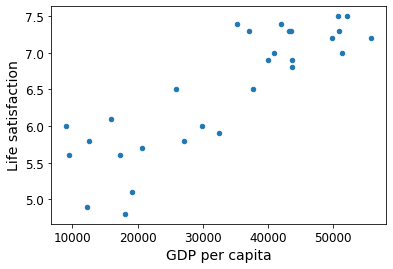

[[5.96242338]]


In [ ]:
# Code example
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import sklearn.linear_model

# Load the data
oecd_bli = pd.read_csv(datapath + "oecd_bli_2015.csv", thousands=',')
gdp_per_capita = pd.read_csv(datapath + "gdp_per_capita.csv",thousands=',',delimiter='\t',
                             encoding='latin1', na_values="n/a")

# Prepare the data
country_stats = prepare_country_stats(oecd_bli, gdp_per_capita)
X = np.c_[country_stats["GDP per capita"]]
y = np.c_[country_stats["Life satisfaction"]]

# Visualize the data
country_stats.plot(kind='scatter', x="GDP per capita", y='Life satisfaction')
plt.show()

# Select a linear model
model = sklearn.linear_model.LinearRegression()

# Train the model
model.fit(X, y)

# Make a prediction for Cyprus
X_new = [[22587]]  # Cyprus' GDP per capita
print(model.predict(X_new)) # outputs [[ 5.96242338]]

Replacing the Linear Regression model with k-Nearest Neighbors (in this example, k = 3) regression in the previous code is as simple as replacing these two
lines:

```python
import sklearn.linear_model
model = sklearn.linear_model.LinearRegression()
```

with these two:

```python
import sklearn.neighbors
model = sklearn.neighbors.KNeighborsRegressor(n_neighbors=3)
```

In [ ]:
# Select a 3-Nearest Neighbors regression model
import sklearn.neighbors
model1 = sklearn.neighbors.KNeighborsRegressor(n_neighbors=3)

# Train the model
model1.fit(X,y)

# Make a prediction for Cyprus
print(model1.predict(X_new)) # outputs [[5.76666667]]

[[5.76666667]]


# Capítulo 02

Projeto de Aprendizado de Máquina de Ponta a Ponta

O código abaixo pertence ao Exemplo 2-1, ele preve o valores médios de casas em distritos californianos, dadas várias características desses distritos.

## Setup

 Primeiro, vamos importar alguns módulos comuns, garantir que o MatplotLib plote 
 as figuras inline e preparar uma função para salvar as figuras.
 Também verificamos se o Python 3.5 ou posterior está instalado 
 (embora o Python 2.x possa funcionar, ele está obsoleto, portanto, recomendamos 
 fortemente que você use o Python 3), bem como o Scikit-Learn ≥0.20.

In [ ]:
# Python ≥3.5 is required
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

# Common imports
import numpy as np
import os

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "end_to_end_project"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

## Download de dados

In [ ]:
import os
import tarfile
import urllib.request

DOWNLOAD_ROOT = "https://raw.githubusercontent.com/ageron/handson-ml2/master/"
HOUSING_PATH = os.path.join("datasets", "housing")
HOUSING_URL = DOWNLOAD_ROOT + "datasets/housing/housing.tgz"

def fetch_housing_data(housing_url=HOUSING_URL, housing_path=HOUSING_PATH):
    if not os.path.isdir(housing_path):
        os.makedirs(housing_path)
    tgz_path = os.path.join(housing_path, "housing.tgz")
    urllib.request.urlretrieve(housing_url, tgz_path)
    housing_tgz = tarfile.open(tgz_path)
    housing_tgz.extractall(path=housing_path)
    housing_tgz.close()

In [ ]:
fetch_housing_data()

In [ ]:
import pandas as pd

def load_housing_data(housing_path=HOUSING_PATH):
    csv_path = os.path.join(housing_path, "housing.csv")
    return pd.read_csv(csv_path)

In [ ]:
housing = load_housing_data()
housing.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [ ]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


In [ ]:
housing["ocean_proximity"].value_counts()

<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: ocean_proximity, dtype: int64

In [ ]:
housing.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


Saving figure attribute_histogram_plots


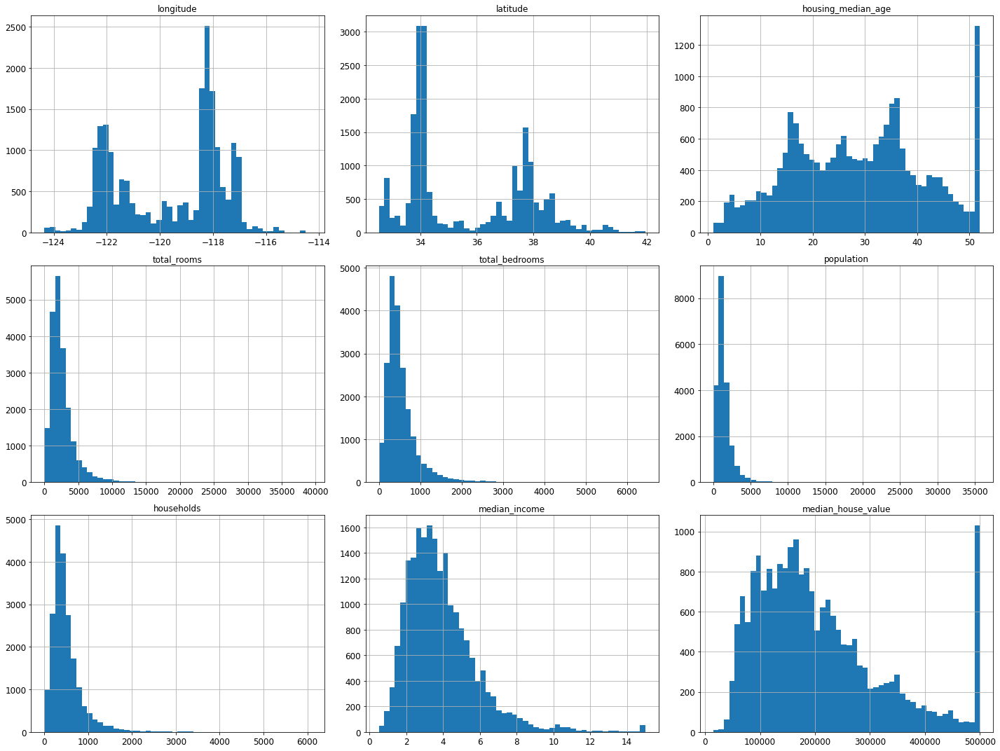

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
housing.hist(bins=50, figsize=(20,15))
save_fig("attribute_histogram_plots")
plt.show()

## Criando um conjunto de teste


In [ ]:
# to make this notebook's output identical at every run
np.random.seed(42)

In [ ]:
import numpy as np

# For illustration only. Sklearn has train_test_split()
def split_train_test(data, test_ratio):
    shuffled_indices = np.random.permutation(len(data))
    test_set_size = int(len(data) * test_ratio)
    test_indices = shuffled_indices[:test_set_size]
    train_indices = shuffled_indices[test_set_size:]
    return data.iloc[train_indices], data.iloc[test_indices]

In [ ]:
train_set, test_set = split_train_test(housing, 0.2)
len(train_set)

16512

In [ ]:
len(test_set)

4128

In [ ]:
from zlib import crc32

def test_set_check(identifier, test_ratio):
    return crc32(np.int64(identifier)) & 0xffffffff < test_ratio * 2**32

def split_train_test_by_id(data, test_ratio, id_column):
    ids = data[id_column]
    in_test_set = ids.apply(lambda id_: test_set_check(id_, test_ratio))
    return data.loc[~in_test_set], data.loc[in_test_set]

In [ ]:
housing_with_id = housing.reset_index()   # adds an `index` column
train_set, test_set = split_train_test_by_id(housing_with_id, 0.2, "index")

In [ ]:
housing_with_id["id"] = housing["longitude"] * 1000 + housing["latitude"]
train_set, test_set = split_train_test_by_id(housing_with_id, 0.2, "id")

In [ ]:
test_set.head()

,index,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,id
59,59,-122.29,37.82,2.0,158.0,43.0,94.0,57.0,2.5625,60000.0,NEAR BAY,-122252.18
60,60,-122.29,37.83,52.0,1121.0,211.0,554.0,187.0,3.3929,75700.0,NEAR BAY,-122252.17
61,61,-122.29,37.82,49.0,135.0,29.0,86.0,23.0,6.1183,75000.0,NEAR BAY,-122252.18
62,62,-122.29,37.81,50.0,760.0,190.0,377.0,122.0,0.9011,86100.0,NEAR BAY,-122252.19
67,67,-122.29,37.80,52.0,1027.0,244.0,492.0,147.0,2.6094,81300.0,NEAR BAY,-122252.20


In [ ]:
from sklearn.model_selection import train_test_split

train_set, test_set = train_test_split(housing, test_size=0.2, random_state=42)

In [ ]:
test_set.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
20046,-119.01,36.06,25.0,1505.0,NaN,1392.0,359.0,1.6812,47700.0,INLAND
3024,-119.46,35.14,30.0,2943.0,NaN,1565.0,584.0,2.5313,45800.0,INLAND
15663,-122.44,37.80,52.0,3830.0,NaN,1310.0,963.0,3.4801,500001.0,NEAR BAY
20484,-118.72,34.28,17.0,3051.0,NaN,1705.0,495.0,5.7376,218600.0,<1H OCEAN
9814,-121.93,36.62,34.0,2351.0,NaN,1063.0,428.0,3.7250,278000.0,NEAR OCEAN


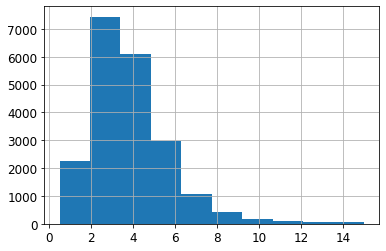

In [ ]:
housing["median_income"].hist()

In [ ]:
housing["income_cat"] = pd.cut(housing["median_income"],
                               bins=[0., 1.5, 3.0, 4.5, 6., np.inf],
                               labels=[1, 2, 3, 4, 5])

In [ ]:
housing["income_cat"].value_counts()

3    7236
2    6581
4    3639
5    2362
1     822
Name: income_cat, dtype: int64

In [ ]:
from sklearn.model_selection import StratifiedShuffleSplit

split = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
for train_index, test_index in split.split(housing, housing["income_cat"]):
    strat_train_set = housing.loc[train_index]
    strat_test_set = housing.loc[test_index]

In [ ]:
strat_test_set["income_cat"].value_counts() / len(strat_test_set)

3    0.350533
2    0.318798
4    0.176357
5    0.114341
1    0.039971
Name: income_cat, dtype: float64

In [ ]:
def income_cat_proportions(data):
    return data["income_cat"].value_counts() / len(data)

train_set, test_set = train_test_split(housing, test_size=0.2, random_state=42)

compare_props = pd.DataFrame({
    "Overall": income_cat_proportions(housing),
    "Stratified": income_cat_proportions(strat_test_set),
    "Random": income_cat_proportions(test_set),
}).sort_index()
compare_props["Rand. %error"] = 100 * compare_props["Random"] / compare_props["Overall"] - 100
compare_props["Strat. %error"] = 100 * compare_props["Stratified"] / compare_props["Overall"] - 100

In [ ]:
compare_props

,Overall,Stratified,Random,Rand. %error,Strat. %error
1,0.039826,0.039971,0.040213,0.973236,0.364964
2,0.318847,0.318798,0.324370,1.732260,-0.015195
3,0.350581,0.350533,0.358527,2.266446,-0.013820
4,0.176308,0.176357,0.167393,-5.056334,0.027480
5,0.114438,0.114341,0.109496,-4.318374,-0.084674


In [ ]:
for set_ in (strat_train_set, strat_test_set):
    set_.drop("income_cat", axis=1, inplace=True)

## Descubra e visualize os dados para obter insights

In [ ]:
housing = strat_train_set.copy()

### Visualizando Dados Geográficos

Saving figure bad_visualization_plot


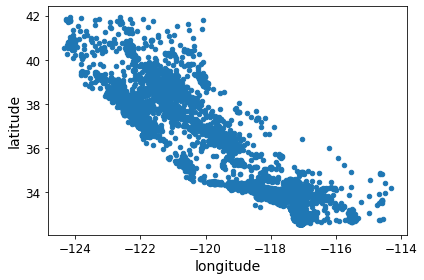

In [ ]:
housing.plot(kind="scatter", x="longitude", y="latitude")
save_fig("bad_visualization_plot")

Saving figure better_visualization_plot


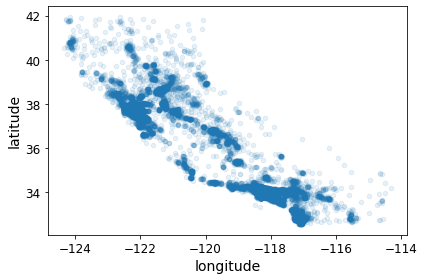

In [ ]:
housing.plot(kind="scatter", x="longitude", y="latitude", alpha=0.1)
save_fig("better_visualization_plot")

Saving figure housing_prices_scatterplot


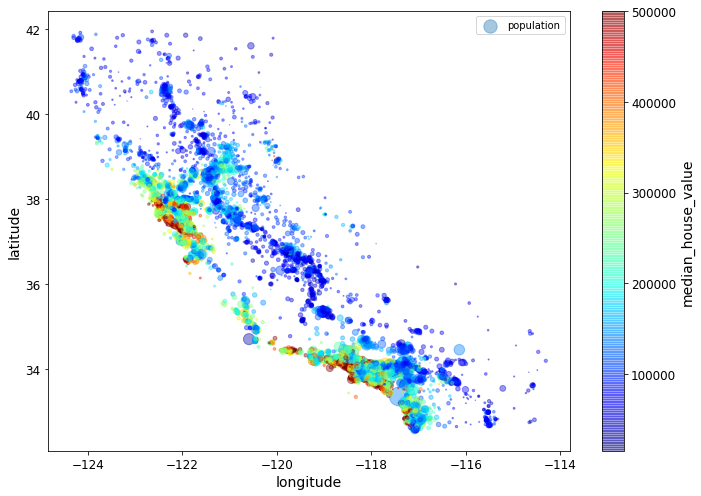

In [ ]:
housing.plot(kind="scatter", x="longitude", y="latitude", alpha=0.4,
             s=housing["population"]/100, label="population", figsize=(10,7),
             c="median_house_value", cmap=plt.get_cmap("jet"), colorbar=True,
             sharex=False)
plt.legend()
save_fig("housing_prices_scatterplot")

In [ ]:
# Download the California image
images_path = os.path.join(PROJECT_ROOT_DIR, "images", "end_to_end_project")
os.makedirs(images_path, exist_ok=True)
DOWNLOAD_ROOT = "https://raw.githubusercontent.com/ageron/handson-ml2/master/"
filename = "california.png"
print("Downloading", filename)
url = DOWNLOAD_ROOT + "images/end_to_end_project/" + filename
urllib.request.urlretrieve(url, os.path.join(images_path, filename))

('./images/end_to_end_project/california.png',
 <http.client.HTTPMessage at 0x7f3addf85a50>)

Saving figure california_housing_prices_plot


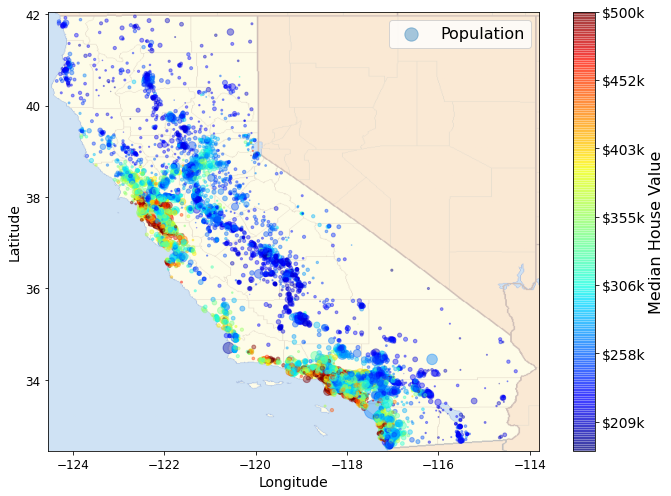

In [ ]:
import matplotlib.image as mpimg
california_img=mpimg.imread(os.path.join(images_path, filename))
ax = housing.plot(kind="scatter", x="longitude", y="latitude", figsize=(10,7),
                  s=housing['population']/100, label="Population",
                  c="median_house_value", cmap=plt.get_cmap("jet"),
                  colorbar=False, alpha=0.4)
plt.imshow(california_img, extent=[-124.55, -113.80, 32.45, 42.05], alpha=0.5,
           cmap=plt.get_cmap("jet"))
plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)

prices = housing["median_house_value"]
tick_values = np.linspace(prices.min(), prices.max(), 11)
cbar = plt.colorbar(ticks=tick_values/prices.max())
cbar.ax.set_yticklabels(["$%dk"%(round(v/1000)) for v in tick_values], fontsize=14)
cbar.set_label('Median House Value', fontsize=16)

plt.legend(fontsize=16)
save_fig("california_housing_prices_plot")
plt.show()

### Procurando por correlações

In [ ]:
corr_matrix = housing.corr()

In [ ]:
corr_matrix["median_house_value"].sort_values(ascending=False)

median_house_value    1.000000
median_income         0.687151
total_rooms           0.135140
housing_median_age    0.114146
households            0.064590
total_bedrooms        0.047781
population           -0.026882
longitude            -0.047466
latitude             -0.142673
Name: median_house_value, dtype: float64

Saving figure scatter_matrix_plot


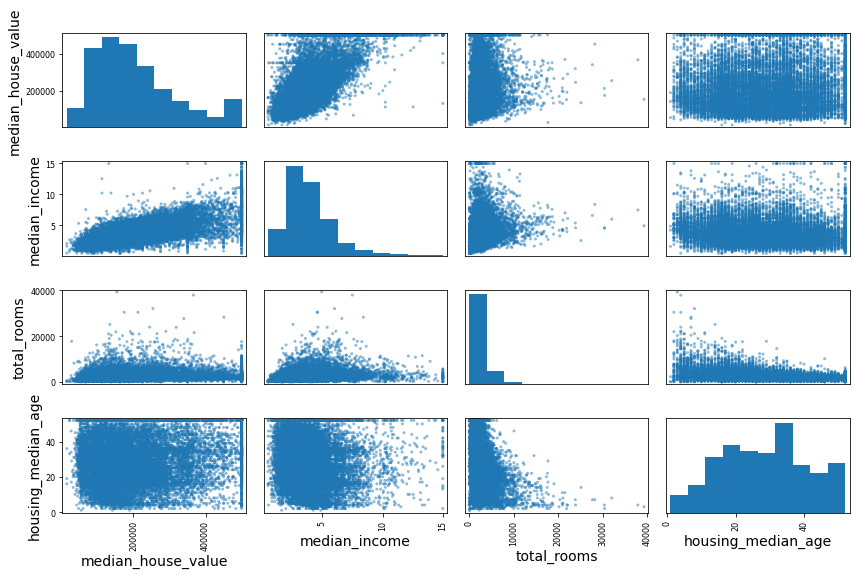

In [ ]:
# from pandas.tools.plotting import scatter_matrix # For older versions of Pandas
from pandas.plotting import scatter_matrix

attributes = ["median_house_value", "median_income", "total_rooms",
              "housing_median_age"]
scatter_matrix(housing[attributes], figsize=(12, 8))
save_fig("scatter_matrix_plot")

Saving figure income_vs_house_value_scatterplot


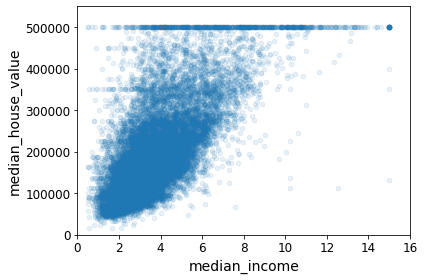

In [ ]:
housing.plot(kind="scatter", x="median_income", y="median_house_value",
             alpha=0.1)
plt.axis([0, 16, 0, 550000])
save_fig("income_vs_house_value_scatterplot")

### Experimentando combinações de atributos

In [ ]:
housing["rooms_per_household"] = housing["total_rooms"]/housing["households"]
housing["bedrooms_per_room"] = housing["total_bedrooms"]/housing["total_rooms"]
housing["population_per_household"]=housing["population"]/housing["households"]

In [ ]:
corr_matrix = housing.corr()
corr_matrix["median_house_value"].sort_values(ascending=False)

median_house_value          1.000000
median_income               0.687151
rooms_per_household         0.146255
total_rooms                 0.135140
housing_median_age          0.114146
households                  0.064590
total_bedrooms              0.047781
population_per_household   -0.021991
population                 -0.026882
longitude                  -0.047466
latitude                   -0.142673
bedrooms_per_room          -0.259952
Name: median_house_value, dtype: float64

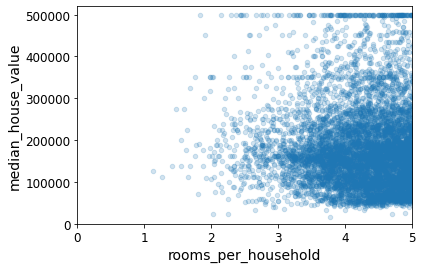

In [ ]:
housing.plot(kind="scatter", x="rooms_per_household", y="median_house_value",
             alpha=0.2)
plt.axis([0, 5, 0, 520000])
plt.show()

In [ ]:
housing.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,rooms_per_household,bedrooms_per_room,population_per_household
count,16512.000000,16512.000000,16512.000000,16512.000000,16354.000000,16512.000000,16512.000000,16512.000000,16512.000000,16512.000000,16354.000000,16512.000000
mean,-119.575635,35.639314,28.653404,2622.539789,534.914639,1419.687379,497.011810,3.875884,207005.322372,5.440406,0.212873,3.096469
std,2.001828,2.137963,12.574819,2138.417080,412.665649,1115.663036,375.696156,1.904931,115701.297250,2.611696,0.057378,11.584825
min,-124.350000,32.540000,1.000000,6.000000,2.000000,3.000000,2.000000,0.499900,14999.000000,1.130435,0.100000,0.692308
25%,-121.800000,33.940000,18.000000,1443.000000,295.000000,784.000000,279.000000,2.566950,119800.000000,4.442168,0.175304,2.431352
50%,-118.510000,34.260000,29.000000,2119.000000,433.000000,1164.000000,408.000000,3.541550,179500.000000,5.232342,0.203027,2.817661
75%,-118.010000,37.720000,37.000000,3141.000000,644.000000,1719.000000,602.000000,4.745325,263900.000000,6.056361,0.239816,3.281420
max,-114.310000,41.950000,52.000000,39320.000000,6210.000000,35682.000000,5358.000000,15.000100,500001.000000,141.909091,1.000000,1243.333333


## Preparar os dados para algoritmos de aprendizado de máquina

In [ ]:
housing = strat_train_set.drop("median_house_value", axis=1) # drop labels for training set
housing_labels = strat_train_set["median_house_value"].copy()

### Limpeza de dados

No livro estão listadas 3 opções:

housing.dropna(subset=["total_bedrooms"])    # option 1
housing.drop("total_bedrooms", axis=1)       # option 2
median = housing["total_bedrooms"].median()  # option 3
housing["total_bedrooms"].fillna(median, inplace=True)

Para demonstrar cada um deles, vamos criar uma cópia do conjunto de dados de alojamento, mas mantendo apenas as linhas que contêm pelo menos um nulo. Assim será mais fácil visualizar exatamente o que cada opção faz:


In [ ]:
sample_incomplete_rows = housing[housing.isnull().any(axis=1)].head()
sample_incomplete_rows

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity
1606,-122.08,37.88,26.0,2947.0,NaN,825.0,626.0,2.9330,NEAR BAY
10915,-117.87,33.73,45.0,2264.0,NaN,1970.0,499.0,3.4193,<1H OCEAN
19150,-122.70,38.35,14.0,2313.0,NaN,954.0,397.0,3.7813,<1H OCEAN
4186,-118.23,34.13,48.0,1308.0,NaN,835.0,294.0,4.2891,<1H OCEAN
16885,-122.40,37.58,26.0,3281.0,NaN,1145.0,480.0,6.3580,NEAR OCEAN


In [ ]:
sample_incomplete_rows.dropna(subset=["total_bedrooms"])    # option 1

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity


In [ ]:
sample_incomplete_rows.drop("total_bedrooms", axis=1)       # option 2

,longitude,latitude,housing_median_age,total_rooms,population,households,median_income,ocean_proximity
1606,-122.08,37.88,26.0,2947.0,825.0,626.0,2.9330,NEAR BAY
10915,-117.87,33.73,45.0,2264.0,1970.0,499.0,3.4193,<1H OCEAN
19150,-122.70,38.35,14.0,2313.0,954.0,397.0,3.7813,<1H OCEAN
4186,-118.23,34.13,48.0,1308.0,835.0,294.0,4.2891,<1H OCEAN
16885,-122.40,37.58,26.0,3281.0,1145.0,480.0,6.3580,NEAR OCEAN


In [ ]:
median = housing["total_bedrooms"].median()
sample_incomplete_rows["total_bedrooms"].fillna(median, inplace=True) # option 3

In [ ]:
sample_incomplete_rows

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity
1606,-122.08,37.88,26.0,2947.0,433.0,825.0,626.0,2.9330,NEAR BAY
10915,-117.87,33.73,45.0,2264.0,433.0,1970.0,499.0,3.4193,<1H OCEAN
19150,-122.70,38.35,14.0,2313.0,433.0,954.0,397.0,3.7813,<1H OCEAN
4186,-118.23,34.13,48.0,1308.0,433.0,835.0,294.0,4.2891,<1H OCEAN
16885,-122.40,37.58,26.0,3281.0,433.0,1145.0,480.0,6.3580,NEAR OCEAN


In [ ]:
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy="median")

Remova o atributo de texto porque a mediana só pode ser calculada em atributos numéricos:

In [ ]:
housing_num = housing.drop("ocean_proximity", axis=1)
# alternatively: housing_num = housing.select_dtypes(include=[np.number])

In [ ]:
imputer.fit(housing_num)

SimpleImputer(strategy='median')

In [ ]:
imputer.statistics_
#housing_num.median().values

array([-118.51   ,   34.26   ,   29.     , 2119.     ,  433.     ,
       1164.     ,  408.     ,    3.54155])

In [ ]:
# Transforme o conjunto de treinamento:
X = imputer.transform(housing_num)

In [ ]:
housing_tr = pd.DataFrame(X, columns=housing_num.columns,
                          index=housing.index)

In [ ]:
housing_tr.loc[sample_incomplete_rows.index.values]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
1606,-122.08,37.88,26.0,2947.0,433.0,825.0,626.0,2.9330
10915,-117.87,33.73,45.0,2264.0,433.0,1970.0,499.0,3.4193
19150,-122.70,38.35,14.0,2313.0,433.0,954.0,397.0,3.7813
4186,-118.23,34.13,48.0,1308.0,433.0,835.0,294.0,4.2891
16885,-122.40,37.58,26.0,3281.0,433.0,1145.0,480.0,6.3580


In [ ]:
imputer.strategy

'median'

In [ ]:
housing_tr = pd.DataFrame(X, columns=housing_num.columns,
                          index=housing_num.index)

In [ ]:
housing_tr.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
12655,-121.46,38.52,29.0,3873.0,797.0,2237.0,706.0,2.1736
15502,-117.23,33.09,7.0,5320.0,855.0,2015.0,768.0,6.3373
2908,-119.04,35.37,44.0,1618.0,310.0,667.0,300.0,2.8750
14053,-117.13,32.75,24.0,1877.0,519.0,898.0,483.0,2.2264
20496,-118.70,34.28,27.0,3536.0,646.0,1837.0,580.0,4.4964


### Manipulando Texto e Atributos Categóricos

In [ ]:
housing_cat = housing[["ocean_proximity"]]
housing_cat.head(10)

,ocean_proximity
12655,INLAND
15502,NEAR OCEAN
2908,INLAND
14053,NEAR OCEAN
20496,<1H OCEAN
1481,NEAR BAY
18125,<1H OCEAN
5830,<1H OCEAN
17989,<1H OCEAN
4861,<1H OCEAN


In [ ]:
from sklearn.preprocessing import OrdinalEncoder

ordinal_encoder = OrdinalEncoder()
housing_cat_encoded = ordinal_encoder.fit_transform(housing_cat)
housing_cat_encoded[:10]

array([[1.],
       [4.],
       [1.],
       [4.],
       [0.],
       [3.],
       [0.],
       [0.],
       [0.],
       [0.]])

In [ ]:
ordinal_encoder.categories_

[array(['<1H OCEAN', 'INLAND', 'ISLAND', 'NEAR BAY', 'NEAR OCEAN'],
       dtype=object)]

In [ ]:

from sklearn.preprocessing import OneHotEncoder

cat_encoder = OneHotEncoder()
housing_cat_1hot = cat_encoder.fit_transform(housing_cat)
housing_cat_1hot

<16512x5 sparse matrix of type '<class 'numpy.float64'>'
	with 16512 stored elements in Compressed Sparse Row format>

In [ ]:
'''
By default, the OneHotEncoder class returns a sparse array, but we can convert 
it to a dense array if needed by calling the toarray() method:
'''

housing_cat_1hot.toarray()

array([[0., 1., 0., 0., 0.],
       [0., 0., 0., 0., 1.],
       [0., 1., 0., 0., 0.],
       ...,
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0.]])

In [ ]:
'''
Alternatively, you can set sparse=False when creating the OneHotEncoder:
'''

cat_encoder = OneHotEncoder(sparse=False)
housing_cat_1hot = cat_encoder.fit_transform(housing_cat)
housing_cat_1hot

array([[0., 1., 0., 0., 0.],
       [0., 0., 0., 0., 1.],
       [0., 1., 0., 0., 0.],
       ...,
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0.]])

In [ ]:
cat_encoder.categories_

[array(['<1H OCEAN', 'INLAND', 'ISLAND', 'NEAR BAY', 'NEAR OCEAN'],
       dtype=object)]

### Transformadores personalizados

In [ ]:
from sklearn.base import BaseEstimator, TransformerMixin

# column index
rooms_ix, bedrooms_ix, population_ix, households_ix = 3, 4, 5, 6

class CombinedAttributesAdder(BaseEstimator, TransformerMixin):
    def __init__(self, add_bedrooms_per_room=True): # no *args or **kargs
        self.add_bedrooms_per_room = add_bedrooms_per_room
    def fit(self, X, y=None):
        return self  # nothing else to do
    def transform(self, X):
        rooms_per_household = X[:, rooms_ix] / X[:, households_ix]
        population_per_household = X[:, population_ix] / X[:, households_ix]
        if self.add_bedrooms_per_room:
            bedrooms_per_room = X[:, bedrooms_ix] / X[:, rooms_ix]
            return np.c_[X, rooms_per_household, population_per_household,
                         bedrooms_per_room]
        else:
            return np.c_[X, rooms_per_household, population_per_household]

attr_adder = CombinedAttributesAdder(add_bedrooms_per_room=False)
housing_extra_attribs = attr_adder.transform(housing.values)


Observe que codifiquei os índices (3, 4, 5, 6) para concisão e clareza no livro, mas seria muito mais fácil obtê-los dinamicamente, assim

In [ ]:
col_names = "total_rooms", "total_bedrooms", "population", "households"
rooms_ix, bedrooms_ix, population_ix, households_ix = [
    housing.columns.get_loc(c) for c in col_names] # get the column indices

Para recuperar um DataFrame, você pode executar isto:



In [ ]:
housing_extra_attribs = pd.DataFrame(
    housing_extra_attribs,
    columns=list(housing.columns)+["rooms_per_household", "population_per_household"],
    index=housing.index)
housing_extra_attribs.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,rooms_per_household,population_per_household
12655,-121.46,38.52,29.0,3873.0,797.0,2237.0,706.0,2.1736,INLAND,5.485836,3.168555
15502,-117.23,33.09,7.0,5320.0,855.0,2015.0,768.0,6.3373,NEAR OCEAN,6.927083,2.623698
2908,-119.04,35.37,44.0,1618.0,310.0,667.0,300.0,2.875,INLAND,5.393333,2.223333
14053,-117.13,32.75,24.0,1877.0,519.0,898.0,483.0,2.2264,NEAR OCEAN,3.886128,1.859213
20496,-118.7,34.28,27.0,3536.0,646.0,1837.0,580.0,4.4964,<1H OCEAN,6.096552,3.167241


### Transformation Pipelines

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

num_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy="median")),
        ('attribs_adder', CombinedAttributesAdder()),
        ('std_scaler', StandardScaler()),
    ])

housing_num_tr = num_pipeline.fit_transform(housing_num)

In [ ]:
housing_num_tr

array([[-0.94135046,  1.34743822,  0.02756357, ...,  0.01739526,
         0.00622264, -0.12112176],
       [ 1.17178212, -1.19243966, -1.72201763, ...,  0.56925554,
        -0.04081077, -0.81086696],
       [ 0.26758118, -0.1259716 ,  1.22045984, ..., -0.01802432,
        -0.07537122, -0.33827252],
       ...,
       [-1.5707942 ,  1.31001828,  1.53856552, ..., -0.5092404 ,
        -0.03743619,  0.32286937],
       [-1.56080303,  1.2492109 , -1.1653327 , ...,  0.32814891,
        -0.05915604, -0.45702273],
       [-1.28105026,  2.02567448, -0.13148926, ...,  0.01407228,
         0.00657083, -0.12169672]])

In [ ]:
from sklearn.compose import ColumnTransformer

num_attribs = list(housing_num)
cat_attribs = ["ocean_proximity"]

full_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_attribs),
        ("cat", OneHotEncoder(), cat_attribs),
    ])

housing_prepared = full_pipeline.fit_transform(housing)

In [ ]:
housing_prepared

array([[-0.94135046,  1.34743822,  0.02756357, ...,  0.        ,
         0.        ,  0.        ],
       [ 1.17178212, -1.19243966, -1.72201763, ...,  0.        ,
         0.        ,  1.        ],
       [ 0.26758118, -0.1259716 ,  1.22045984, ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [-1.5707942 ,  1.31001828,  1.53856552, ...,  0.        ,
         0.        ,  0.        ],
       [-1.56080303,  1.2492109 , -1.1653327 , ...,  0.        ,
         0.        ,  0.        ],
       [-1.28105026,  2.02567448, -0.13148926, ...,  0.        ,
         0.        ,  0.        ]])

In [ ]:
housing_prepared.shape

(16512, 16)

In [ ]:
from sklearn.base import BaseEstimator, TransformerMixin

# Create a class to select numerical or categorical columns 
class OldDataFrameSelector(BaseEstimator, TransformerMixin):
    def __init__(self, attribute_names):
        self.attribute_names = attribute_names
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return X[self.attribute_names].values

In [ ]:
'''
Now let's join all these components into a big pipeline that will preprocess both the numerical and the categorical features:
'''

num_attribs = list(housing_num)
cat_attribs = ["ocean_proximity"]

old_num_pipeline = Pipeline([
        ('selector', OldDataFrameSelector(num_attribs)),
        ('imputer', SimpleImputer(strategy="median")),
        ('attribs_adder', CombinedAttributesAdder()),
        ('std_scaler', StandardScaler()),
    ])

old_cat_pipeline = Pipeline([
        ('selector', OldDataFrameSelector(cat_attribs)),
        ('cat_encoder', OneHotEncoder(sparse=False)),
    ])

In [ ]:
from sklearn.pipeline import FeatureUnion

old_full_pipeline = FeatureUnion(transformer_list=[
        ("num_pipeline", old_num_pipeline),
        ("cat_pipeline", old_cat_pipeline),
    ])

In [ ]:
old_housing_prepared = old_full_pipeline.fit_transform(housing)
old_housing_prepared

array([[-0.94135046,  1.34743822,  0.02756357, ...,  0.        ,
         0.        ,  0.        ],
       [ 1.17178212, -1.19243966, -1.72201763, ...,  0.        ,
         0.        ,  1.        ],
       [ 0.26758118, -0.1259716 ,  1.22045984, ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [-1.5707942 ,  1.31001828,  1.53856552, ...,  0.        ,
         0.        ,  0.        ],
       [-1.56080303,  1.2492109 , -1.1653327 , ...,  0.        ,
         0.        ,  0.        ],
       [-1.28105026,  2.02567448, -0.13148926, ...,  0.        ,
         0.        ,  0.        ]])

In [ ]:
np.allclose(housing_prepared, old_housing_prepared)

True

## Selecionar e treinar um modelo

### Treinamento e avaliação no conjunto de treinamento

In [ ]:
from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()
lin_reg.fit(housing_prepared, housing_labels)

LinearRegression()

In [ ]:
# let's try the full preprocessing pipeline on a few training instances
some_data = housing.iloc[:5]
some_labels = housing_labels.iloc[:5]
some_data_prepared = full_pipeline.transform(some_data)

print("Predictions:", lin_reg.predict(some_data_prepared))

Predictions: [ 85657.90192014 305492.60737488 152056.46122456 186095.70946094
 244550.67966089]


In [ ]:
print("Labels:", list(some_labels))

Labels: [72100.0, 279600.0, 82700.0, 112500.0, 238300.0]


In [ ]:
some_data_prepared

array([[-0.94135046,  1.34743822,  0.02756357,  0.58477745,  0.64037127,
         0.73260236,  0.55628602, -0.8936472 ,  0.01739526,  0.00622264,
        -0.12112176,  0.        ,  1.        ,  0.        ,  0.        ,
         0.        ],
       [ 1.17178212, -1.19243966, -1.72201763,  1.26146668,  0.78156132,
         0.53361152,  0.72131799,  1.292168  ,  0.56925554, -0.04081077,
        -0.81086696,  0.        ,  0.        ,  0.        ,  0.        ,
         1.        ],
       [ 0.26758118, -0.1259716 ,  1.22045984, -0.46977281, -0.54513828,
        -0.67467519, -0.52440722, -0.52543365, -0.01802432, -0.07537122,
        -0.33827252,  0.        ,  1.        ,  0.        ,  0.        ,
         0.        ],
       [ 1.22173797, -1.35147437, -0.37006852, -0.34865152, -0.03636724,
        -0.46761716, -0.03729672, -0.86592882, -0.59513997, -0.10680295,
         0.96120521,  0.        ,  0.        ,  0.        ,  0.        ,
         1.        ],
       [ 0.43743108, -0.63581817, -0

In [ ]:
from sklearn.metrics import mean_squared_error

housing_predictions = lin_reg.predict(housing_prepared)
lin_mse = mean_squared_error(housing_labels, housing_predictions)
lin_rmse = np.sqrt(lin_mse)
lin_rmse

68627.87390018745

In [ ]:
from sklearn.metrics import mean_absolute_error

lin_mae = mean_absolute_error(housing_labels, housing_predictions)
lin_mae

49438.66860915802

In [ ]:
from sklearn.tree import DecisionTreeRegressor

tree_reg = DecisionTreeRegressor(random_state=42)
tree_reg.fit(housing_prepared, housing_labels)

DecisionTreeRegressor(random_state=42)

In [ ]:
housing_predictions = tree_reg.predict(housing_prepared)
tree_mse = mean_squared_error(housing_labels, housing_predictions)
tree_rmse = np.sqrt(tree_mse)
tree_rmse

0.0

### Melhor avaliação usando validação cruzada

In [ ]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(tree_reg, housing_prepared, housing_labels,
                         scoring="neg_mean_squared_error", cv=10)
tree_rmse_scores = np.sqrt(-scores)

In [ ]:
def display_scores(scores):
    print("Scores:", scores)
    print("Mean:", scores.mean())
    print("Standard deviation:", scores.std())

display_scores(tree_rmse_scores)

Scores: [72831.45749112 69973.18438322 69528.56551415 72517.78229792
 69145.50006909 79094.74123727 68960.045444   73344.50225684
 69826.02473916 71077.09753998]
Mean: 71629.89009727491
Standard deviation: 2914.035468468928


In [ ]:
lin_scores = cross_val_score(lin_reg, housing_prepared, housing_labels,
                             scoring="neg_mean_squared_error", cv=10)
lin_rmse_scores = np.sqrt(-lin_scores)
display_scores(lin_rmse_scores)

Scores: [71762.76364394 64114.99166359 67771.17124356 68635.19072082
 66846.14089488 72528.03725385 73997.08050233 68802.33629334
 66443.28836884 70139.79923956]
Mean: 69104.07998247063
Standard deviation: 2880.3282098180644


In [ ]:
from sklearn.ensemble import RandomForestRegressor

forest_reg = RandomForestRegressor(n_estimators=100, random_state=42)
forest_reg.fit(housing_prepared, housing_labels)

RandomForestRegressor(random_state=42)

In [ ]:
housing_predictions = forest_reg.predict(housing_prepared)
forest_mse = mean_squared_error(housing_labels, housing_predictions)
forest_rmse = np.sqrt(forest_mse)
forest_rmse

18650.698705770003

In [ ]:
from sklearn.model_selection import cross_val_score

forest_scores = cross_val_score(forest_reg, housing_prepared, housing_labels,
                                scoring="neg_mean_squared_error", cv=10)
forest_rmse_scores = np.sqrt(-forest_scores)
display_scores(forest_rmse_scores)

Scores: [51559.63379638 48737.57100062 47210.51269766 51875.21247297
 47577.50470123 51863.27467888 52746.34645573 50065.1762751
 48664.66818196 54055.90894609]
Mean: 50435.58092066179
Standard deviation: 2203.3381412764606


In [ ]:
scores = cross_val_score(lin_reg, housing_prepared, housing_labels, scoring="neg_mean_squared_error", cv=10)
pd.Series(np.sqrt(-scores)).describe()

count       10.000000
mean     69104.079982
std       3036.132517
min      64114.991664
25%      67077.398482
50%      68718.763507
75%      71357.022543
max      73997.080502
dtype: float64

In [ ]:
from sklearn.svm import SVR

svm_reg = SVR(kernel="linear")
svm_reg.fit(housing_prepared, housing_labels)
housing_predictions = svm_reg.predict(housing_prepared)
svm_mse = mean_squared_error(housing_labels, housing_predictions)
svm_rmse = np.sqrt(svm_mse)
svm_rmse

111095.06635291968

## Ajuste seu modelo

### Grid Search

In [ ]:
from sklearn.model_selection import GridSearchCV

param_grid = [
    # try 12 (3×4) combinations of hyperparameters
    {'n_estimators': [3, 10, 30], 'max_features': [2, 4, 6, 8]},
    # then try 6 (2×3) combinations with bootstrap set as False
    {'bootstrap': [False], 'n_estimators': [3, 10], 'max_features': [2, 3, 4]},
  ]

forest_reg = RandomForestRegressor(random_state=42)
# train across 5 folds, that's a total of (12+6)*5=90 rounds of training 
grid_search = GridSearchCV(forest_reg, param_grid, cv=5,
                           scoring='neg_mean_squared_error',
                           return_train_score=True)
grid_search.fit(housing_prepared, housing_labels)

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42),
             param_grid=[{'max_features': [2, 4, 6, 8],
                          'n_estimators': [3, 10, 30]},
                         {'bootstrap': [False], 'max_features': [2, 3, 4],
                          'n_estimators': [3, 10]}],
             return_train_score=True, scoring='neg_mean_squared_error')

In [ ]:
# The best hyperparameter combination found:

grid_search.best_params_

{'max_features': 8, 'n_estimators': 30}

In [ ]:
grid_search.best_estimator_

RandomForestRegressor(max_features=8, n_estimators=30, random_state=42)

In [ ]:
# Let's look at the score of each hyperparameter combination tested during the grid search:

cvres = grid_search.cv_results_
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(-mean_score), params)

63895.161577951665 {'max_features': 2, 'n_estimators': 3}
54916.32386349543 {'max_features': 2, 'n_estimators': 10}
52885.86715332332 {'max_features': 2, 'n_estimators': 30}
60075.3680329983 {'max_features': 4, 'n_estimators': 3}
52495.01284985185 {'max_features': 4, 'n_estimators': 10}
50187.24324926565 {'max_features': 4, 'n_estimators': 30}
58064.73529982314 {'max_features': 6, 'n_estimators': 3}
51519.32062366315 {'max_features': 6, 'n_estimators': 10}
49969.80441627874 {'max_features': 6, 'n_estimators': 30}
58895.824998155826 {'max_features': 8, 'n_estimators': 3}
52459.79624724529 {'max_features': 8, 'n_estimators': 10}
49898.98913455217 {'max_features': 8, 'n_estimators': 30}
62381.765106921855 {'bootstrap': False, 'max_features': 2, 'n_estimators': 3}
54476.57050944266 {'bootstrap': False, 'max_features': 2, 'n_estimators': 10}
59974.60028085155 {'bootstrap': False, 'max_features': 3, 'n_estimators': 3}
52754.5632813202 {'bootstrap': False, 'max_features': 3, 'n_estimators': 1

In [ ]:
pd.DataFrame(grid_search.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_features,param_n_estimators,param_bootstrap,params,split0_test_score,split1_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.075715,0.001344,0.006478,0.001071,2,3,NaN,"{'max_features': 2, 'n_estimators': 3}",-4.119912e+09,-3.723465e+09,...,-4.082592e+09,1.867375e+08,18,-1.155630e+09,-1.089726e+09,-1.153843e+09,-1.118149e+09,-1.093446e+09,-1.122159e+09,2.834288e+07
1,0.341701,0.072244,0.020675,0.003970,2,10,NaN,"{'max_features': 2, 'n_estimators': 10}",-2.973521e+09,-2.810319e+09,...,-3.015803e+09,1.139808e+08,11,-5.982947e+08,-5.904781e+08,-6.123850e+08,-5.727681e+08,-5.905210e+08,-5.928894e+08,1.284978e+07
2,0.809750,0.190424,0.043125,0.008617,2,30,NaN,"{'max_features': 2, 'n_estimators': 30}",-2.801229e+09,-2.671474e+09,...,-2.796915e+09,7.980892e+07,9,-4.412567e+08,-4.326398e+08,-4.553722e+08,-4.320746e+08,-4.311606e+08,-4.385008e+08,9.184397e+06
3,0.122354,0.002826,0.005700,0.000837,4,3,NaN,"{'max_features': 4, 'n_estimators': 3}",-3.528743e+09,-3.490303e+09,...,-3.609050e+09,1.375683e+08,16,-9.782368e+08,-9.806455e+08,-1.003780e+09,-1.016515e+09,-1.011270e+09,-9.980896e+08,1.577372e+07
4,0.390023,0.004374,0.014989,0.001680,4,10,NaN,"{'max_features': 4, 'n_estimators': 10}",-2.742620e+09,-2.609311e+09,...,-2.755726e+09,1.182604e+08,7,-5.063215e+08,-5.257983e+08,-5.081984e+08,-5.174405e+08,-5.282066e+08,-5.171931e+08,8.882622e+06
5,1.188291,0.058503,0.039734,0.001465,4,30,NaN,"{'max_features': 4, 'n_estimators': 30}",-2.522176e+09,-2.440241e+09,...,-2.518759e+09,8.488084e+07,3,-3.776568e+08,-3.902106e+08,-3.885042e+08,-3.830866e+08,-3.894779e+08,-3.857872e+08,4.774229e+06
6,0.170736,0.027275,0.005681,0.000613,6,3,NaN,"{'max_features': 6, 'n_estimators': 3}",-3.362127e+09,-3.311863e+09,...,-3.371513e+09,1.378086e+08,13,-8.909397e+08,-9.583733e+08,-9.000201e+08,-8.964731e+08,-9.151927e+08,-9.121998e+08,2.444837e+07
7,0.673174,0.294808,0.014753,0.001703,6,10,NaN,"{'max_features': 6, 'n_estimators': 10}",-2.622099e+09,-2.669655e+09,...,-2.654240e+09,6.967978e+07,5,-4.939906e+08,-5.145996e+08,-5.023512e+08,-4.959467e+08,-5.147087e+08,-5.043194e+08,8.880106e+06
8,1.615842,0.006333,0.041821,0.005504,6,30,NaN,"{'max_features': 6, 'n_estimators': 30}",-2.446142e+09,-2.446594e+09,...,-2.496981e+09,7.357046e+07,2,-3.760968e+08,-3.876636e+08,-3.875307e+08,-3.760938e+08,-3.861056e+08,-3.826981e+08,5.418747e+06
9,0.214080,0.005101,0.005050,0.000086,8,3,NaN,"{'max_features': 8, 'n_estimators': 3}",-3.590333e+09,-3.232664e+09,...,-3.468718e+09,1.293758e+08,14,-9.505012e+08,-9.166119e+08,-9.033910e+08,-9.070642e+08,-9.459386e+08,-9.247014e+08,1.973471e+07


### Randomized Search

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

param_distribs = {
        'n_estimators': randint(low=1, high=200),
        'max_features': randint(low=1, high=8),
    }

forest_reg = RandomForestRegressor(random_state=42)
rnd_search = RandomizedSearchCV(forest_reg, param_distributions=param_distribs,
                                n_iter=10, cv=5, scoring='neg_mean_squared_error', random_state=42)
rnd_search.fit(housing_prepared, housing_labels)

RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42),
                   param_distributions={'max_features': <scipy.stats._distn_infrastructure.rv_frozen object at 0x7f3adb484fd0>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_frozen object at 0x7f3adb484710>},
                   random_state=42, scoring='neg_mean_squared_error')

In [ ]:
cvres = rnd_search.cv_results_
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(-mean_score), params)

49117.55344336652 {'max_features': 7, 'n_estimators': 180}
51450.63202856348 {'max_features': 5, 'n_estimators': 15}
50692.53588182537 {'max_features': 3, 'n_estimators': 72}
50783.614493515 {'max_features': 5, 'n_estimators': 21}
49162.89877456354 {'max_features': 7, 'n_estimators': 122}
50655.798471042704 {'max_features': 3, 'n_estimators': 75}
50513.856319990606 {'max_features': 3, 'n_estimators': 88}
49521.17201976928 {'max_features': 5, 'n_estimators': 100}
50302.90440763418 {'max_features': 3, 'n_estimators': 150}
65167.02018649492 {'max_features': 5, 'n_estimators': 2}


### Analise os melhores modelos e seus erros

In [ ]:
feature_importances = grid_search.best_estimator_.feature_importances_
feature_importances

array([6.96542523e-02, 6.04213840e-02, 4.21882202e-02, 1.52450557e-02,
       1.55545295e-02, 1.58491147e-02, 1.49346552e-02, 3.79009225e-01,
       5.47789150e-02, 1.07031322e-01, 4.82031213e-02, 6.79266007e-03,
       1.65706303e-01, 7.83480660e-05, 1.52473276e-03, 3.02816106e-03])

In [ ]:
extra_attribs = ["rooms_per_hhold", "pop_per_hhold", "bedrooms_per_room"]
#cat_encoder = cat_pipeline.named_steps["cat_encoder"] # old solution
cat_encoder = full_pipeline.named_transformers_["cat"]
cat_one_hot_attribs = list(cat_encoder.categories_[0])
attributes = num_attribs + extra_attribs + cat_one_hot_attribs
sorted(zip(feature_importances, attributes), reverse=True)

[(0.3790092248170967, 'median_income'),
 (0.16570630316895876, 'INLAND'),
 (0.10703132208204354, 'pop_per_hhold'),
 (0.06965425227942929, 'longitude'),
 (0.0604213840080722, 'latitude'),
 (0.054778915018283726, 'rooms_per_hhold'),
 (0.048203121338269206, 'bedrooms_per_room'),
 (0.04218822024391753, 'housing_median_age'),
 (0.015849114744428634, 'population'),
 (0.015554529490469328, 'total_bedrooms'),
 (0.01524505568840977, 'total_rooms'),
 (0.014934655161887776, 'households'),
 (0.006792660074259966, '<1H OCEAN'),
 (0.0030281610628962747, 'NEAR OCEAN'),
 (0.0015247327555504937, 'NEAR BAY'),
 (7.834806602687504e-05, 'ISLAND')]

## Avalie seu sistema no conjunto de testes


In [ ]:
final_model = grid_search.best_estimator_

X_test = strat_test_set.drop("median_house_value", axis=1)
y_test = strat_test_set["median_house_value"].copy()

X_test_prepared = full_pipeline.transform(X_test)
final_predictions = final_model.predict(X_test_prepared)

final_mse = mean_squared_error(y_test, final_predictions)
final_rmse = np.sqrt(final_mse)

In [ ]:
final_rmse

47873.26095812988

In [ ]:
from scipy import stats

confidence = 0.95
squared_errors = (final_predictions - y_test) ** 2
np.sqrt(stats.t.interval(confidence, len(squared_errors) - 1,
                         loc=squared_errors.mean(),
                         scale=stats.sem(squared_errors)))

array([45893.36082829, 49774.46796717])

In [ ]:
m = len(squared_errors)
mean = squared_errors.mean()
tscore = stats.t.ppf((1 + confidence) / 2, df=m - 1)
tmargin = tscore * squared_errors.std(ddof=1) / np.sqrt(m)
np.sqrt(mean - tmargin), np.sqrt(mean + tmargin)

(45893.3608282853, 49774.46796717339)

In [ ]:
zscore = stats.norm.ppf((1 + confidence) / 2)
zmargin = zscore * squared_errors.std(ddof=1) / np.sqrt(m)
np.sqrt(mean - zmargin), np.sqrt(mean + zmargin)

(45893.954011012866, 49773.92103065016)

## Extra material

### Um pipeline completo com preparação e previsão

In [ ]:
full_pipeline_with_predictor = Pipeline([
        ("preparation", full_pipeline),
        ("linear", LinearRegression())
    ])

full_pipeline_with_predictor.fit(housing, housing_labels)
full_pipeline_with_predictor.predict(some_data)

### Persistência do modelo usando joblib

In [ ]:
my_model = full_pipeline_with_predictor

In [ ]:
import joblib
joblib.dump(my_model, "my_model.pkl") # DIFF
#...
my_model_loaded = joblib.load("my_model.pkl") # DIFF

### Exemplos de distribuições SciPy para RandomizedSearchCV


In [ ]:
from scipy.stats import geom, expon
geom_distrib=geom(0.5).rvs(10000, random_state=42)
expon_distrib=expon(scale=1).rvs(10000, random_state=42)
plt.hist(geom_distrib, bins=50)
plt.show()
plt.hist(expon_distrib, bins=50)
plt.show()

# Capítulo 09

Em Pleno Funcionamento com o TensorFlow

## Setup

First, let's make sure this notebook works well in both python 2 and 3, import a few common modules, ensure MatplotLib plots figures inline and prepare a function to save the figures:

In [ ]:
# To support both python 2 and python 3
from __future__ import division, print_function, unicode_literals

# Common imports
import numpy as np
import os

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 1.x
except Exception:
    pass

# to make this notebook's output stable across runs
def reset_graph(seed=42):
    tf.reset_default_graph()
    tf.set_random_seed(seed)
    np.random.seed(seed)

# To plot pretty figures
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "tensorflow"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

TensorFlow 1.x selected.


## Creating and running a graph

In [ ]:
import tensorflow as tf

reset_graph()

x = tf.Variable(3, name="x")
y = tf.Variable(4, name="y")
f = x*x*y + y + 2

In [ ]:
f

<tf.Tensor 'add_1:0' shape=() dtype=int32>

In [ ]:
sess = tf.Session()
sess.run(x.initializer)
sess.run(y.initializer)
result = sess.run(f)
print(result)

42


In [ ]:
sess.close()

In [ ]:
with tf.Session() as sess:
    x.initializer.run()
    y.initializer.run()
    result = f.eval()

In [ ]:
result

42

In [ ]:
init = tf.global_variables_initializer()

with tf.Session() as sess:
    init.run()
    result = f.eval()

In [ ]:
result

42

In [ ]:
init = tf.global_variables_initializer()

In [ ]:
sess = tf.InteractiveSession()
init.run()
result = f.eval()
print(result)

42


In [ ]:
sess.close()

In [ ]:
result

42

## Managing graphs

In [ ]:
reset_graph()

x1 = tf.Variable(1)
x1.graph is tf.get_default_graph()

True

In [ ]:
graph = tf.Graph()
with graph.as_default():
    x2 = tf.Variable(2)

x2.graph is graph

True

In [ ]:
x2.graph is tf.get_default_graph()

False

In [ ]:
w = tf.constant(3)
x = w + 2
y = x + 5
z = x * 3

with tf.Session() as sess:
    print(y.eval())  # 10
    print(z.eval())  # 15

10
15


In [ ]:
with tf.Session() as sess:
    y_val, z_val = sess.run([y, z])
    print(y_val)  # 10
    print(z_val)  # 15

10
15


## Linear Regression

### Using the Normal Equation

In [ ]:
import numpy as np
from sklearn.datasets import fetch_california_housing

reset_graph()

housing = fetch_california_housing()
m, n = housing.data.shape
housing_data_plus_bias = np.c_[np.ones((m, 1)), housing.data]

X = tf.constant(housing_data_plus_bias, dtype=tf.float32, name="X")
y = tf.constant(housing.target.reshape(-1, 1), dtype=tf.float32, name="y")
XT = tf.transpose(X)
theta = tf.matmul(tf.matmul(tf.matrix_inverse(tf.matmul(XT, X)), XT), y)

with tf.Session() as sess:
    theta_value = theta.eval()

In [ ]:
theta_value

array([[-3.7185181e+01],
       [ 4.3633747e-01],
       [ 9.3952334e-03],
       [-1.0711310e-01],
       [ 6.4479220e-01],
       [-4.0338000e-06],
       [-3.7813708e-03],
       [-4.2348403e-01],
       [-4.3721911e-01]], dtype=float32)

Compare with pure NumPy

In [ ]:
X = housing_data_plus_bias
y = housing.target.reshape(-1, 1)
theta_numpy = np.linalg.inv(X.T.dot(X)).dot(X.T).dot(y)

print(theta_numpy)

[[-3.69419202e+01]
 [ 4.36693293e-01]
 [ 9.43577803e-03]
 [-1.07322041e-01]
 [ 6.45065694e-01]
 [-3.97638942e-06]
 [-3.78654265e-03]
 [-4.21314378e-01]
 [-4.34513755e-01]]


Compare with Scikit-Learn

In [ ]:
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(housing.data, housing.target.reshape(-1, 1))

print(np.r_[lin_reg.intercept_.reshape(-1, 1), lin_reg.coef_.T])

[[-3.69419202e+01]
 [ 4.36693293e-01]
 [ 9.43577803e-03]
 [-1.07322041e-01]
 [ 6.45065694e-01]
 [-3.97638942e-06]
 [-3.78654265e-03]
 [-4.21314378e-01]
 [-4.34513755e-01]]


#### Using Batch Gradient Descent

Gradient Descent requires scaling the feature vectors first. We could do this using TF, but let's just use Scikit-Learn for now.

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaled_housing_data = scaler.fit_transform(housing.data)
scaled_housing_data_plus_bias = np.c_[np.ones((m, 1)), scaled_housing_data]

In [ ]:
print(scaled_housing_data_plus_bias.mean(axis=0))
print(scaled_housing_data_plus_bias.mean(axis=1))
print(scaled_housing_data_plus_bias.mean())
print(scaled_housing_data_plus_bias.shape)

[ 1.00000000e+00  6.60969987e-17  5.50808322e-18  6.60969987e-17
 -1.06030602e-16 -1.10161664e-17  3.44255201e-18 -1.07958431e-15
 -8.52651283e-15]
[ 0.38915536  0.36424355  0.5116157  ... -0.06612179 -0.06360587
  0.01359031]
0.11111111111111005
(20640, 9)


#### Manually computing the gradients

In [ ]:
reset_graph()

n_epochs = 1000
learning_rate = 0.01

X = tf.constant(scaled_housing_data_plus_bias, dtype=tf.float32, name="X")
y = tf.constant(housing.target.reshape(-1, 1), dtype=tf.float32, name="y")
theta = tf.Variable(tf.random_uniform([n + 1, 1], -1.0, 1.0, seed=42), name="theta")
y_pred = tf.matmul(X, theta, name="predictions")
error = y_pred - y
mse = tf.reduce_mean(tf.square(error), name="mse")
gradients = 2/m * tf.matmul(tf.transpose(X), error)
training_op = tf.assign(theta, theta - learning_rate * gradients)

init = tf.global_variables_initializer()

with tf.Session() as sess:
    sess.run(init)

    for epoch in range(n_epochs):
        if epoch % 100 == 0:
            print("Epoch", epoch, "MSE =", mse.eval())
        sess.run(training_op)
    
    best_theta = theta.eval()

Epoch 0 MSE = 9.161542
Epoch 100 MSE = 0.7145004
Epoch 200 MSE = 0.56670487
Epoch 300 MSE = 0.5555718
Epoch 400 MSE = 0.5488112
Epoch 500 MSE = 0.5436363
Epoch 600 MSE = 0.5396291
Epoch 700 MSE = 0.5365092
Epoch 800 MSE = 0.53406775
Epoch 900 MSE = 0.5321473


In [ ]:
best_theta

array([[ 2.0685523 ],
       [ 0.8874027 ],
       [ 0.14401656],
       [-0.34770882],
       [ 0.36178368],
       [ 0.00393811],
       [-0.04269556],
       [-0.6614529 ],
       [-0.6375279 ]], dtype=float32)

#### Using autodiff

Same as above except for the `gradients = ...` line:

In [ ]:
reset_graph()

n_epochs = 1000
learning_rate = 0.01

X = tf.constant(scaled_housing_data_plus_bias, dtype=tf.float32, name="X")
y = tf.constant(housing.target.reshape(-1, 1), dtype=tf.float32, name="y")
theta = tf.Variable(tf.random_uniform([n + 1, 1], -1.0, 1.0, seed=42), name="theta")
y_pred = tf.matmul(X, theta, name="predictions")
error = y_pred - y
mse = tf.reduce_mean(tf.square(error), name="mse")

In [ ]:
gradients = tf.gradients(mse, [theta])[0]

In [ ]:
training_op = tf.assign(theta, theta - learning_rate * gradients)

init = tf.global_variables_initializer()

with tf.Session() as sess:
    sess.run(init)

    for epoch in range(n_epochs):
        if epoch % 100 == 0:
            print("Epoch", epoch, "MSE =", mse.eval())
        sess.run(training_op)
    
    best_theta = theta.eval()

print("Best theta:")
print(best_theta)

Epoch 0 MSE = 9.161542
Epoch 100 MSE = 0.71450037
Epoch 200 MSE = 0.56670487
Epoch 300 MSE = 0.5555718
Epoch 400 MSE = 0.54881126
Epoch 500 MSE = 0.5436363
Epoch 600 MSE = 0.53962916
Epoch 700 MSE = 0.5365092
Epoch 800 MSE = 0.53406775
Epoch 900 MSE = 0.5321473
Best theta:
[[ 2.0685523 ]
 [ 0.8874027 ]
 [ 0.14401656]
 [-0.3477088 ]
 [ 0.36178365]
 [ 0.00393811]
 [-0.04269556]
 [-0.66145283]
 [-0.6375278 ]]


How could you find the partial derivatives of the following function with regards to `a` and `b`?

In [ ]:
def my_func(a, b):
    z = 0
    for i in range(100):
        z = a * np.cos(z + i) + z * np.sin(b - i)
    return z

In [ ]:
my_func(0.2, 0.3)

-0.21253923284754914

In [ ]:
reset_graph()

a = tf.Variable(0.2, name="a")
b = tf.Variable(0.3, name="b")
z = tf.constant(0.0, name="z0")
for i in range(100):
    z = a * tf.cos(z + i) + z * tf.sin(b - i)

grads = tf.gradients(z, [a, b])
init = tf.global_variables_initializer()

Let's compute the function at $a=0.2$ and $b=0.3$, and the partial derivatives at that point with regards to $a$ and with regards to $b$:

In [ ]:
with tf.Session() as sess:
    init.run()
    print(z.eval())
    print(sess.run(grads))

-0.21253741
[-1.1388495, 0.19671397]


#### Using a `GradientDescentOptimizer`

In [ ]:
reset_graph()

n_epochs = 1000
learning_rate = 0.01

X = tf.constant(scaled_housing_data_plus_bias, dtype=tf.float32, name="X")
y = tf.constant(housing.target.reshape(-1, 1), dtype=tf.float32, name="y")
theta = tf.Variable(tf.random_uniform([n + 1, 1], -1.0, 1.0, seed=42), name="theta")
y_pred = tf.matmul(X, theta, name="predictions")
error = y_pred - y
mse = tf.reduce_mean(tf.square(error), name="mse")

NameError: ignored

In [ ]:
optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(mse)

In [ ]:
init = tf.global_variables_initializer()

with tf.Session() as sess:
    sess.run(init)

    for epoch in range(n_epochs):
        if epoch % 100 == 0:
            print("Epoch", epoch, "MSE =", mse.eval())
        sess.run(training_op)
    
    best_theta = theta.eval()

print("Best theta:")
print(best_theta)

#### Using a momentum optimizer

In [ ]:
reset_graph()

n_epochs = 1000
learning_rate = 0.01

X = tf.constant(scaled_housing_data_plus_bias, dtype=tf.float32, name="X")
y = tf.constant(housing.target.reshape(-1, 1), dtype=tf.float32, name="y")
theta = tf.Variable(tf.random_uniform([n + 1, 1], -1.0, 1.0, seed=42), name="theta")
y_pred = tf.matmul(X, theta, name="predictions")
error = y_pred - y
mse = tf.reduce_mean(tf.square(error), name="mse")

In [ ]:
optimizer = tf.train.MomentumOptimizer(learning_rate=learning_rate,
                                       momentum=0.9)

In [ ]:
training_op = optimizer.minimize(mse)

init = tf.global_variables_initializer()

In [ ]:
with tf.Session() as sess:
    sess.run(init)

    for epoch in range(n_epochs):
        sess.run(training_op)
    
    best_theta = theta.eval()

print("Best theta:")
print(best_theta)

Best theta:
[[ 2.068558  ]
 [ 0.82962847]
 [ 0.11875335]
 [-0.26554456]
 [ 0.3057109 ]
 [-0.00450249]
 [-0.03932662]
 [-0.8998645 ]
 [-0.8705207 ]]


## Feeding data to the training algorithm

### Placeholder nodes

In [ ]:
reset_graph()

A = tf.placeholder(tf.float32, shape=(None, 3))
B = A + 5
with tf.Session() as sess:
    B_val_1 = B.eval(feed_dict={A: [[1, 2, 3]]})
    B_val_2 = B.eval(feed_dict={A: [[4, 5, 6], [7, 8, 9]]})

print(B_val_1)

[[6. 7. 8.]]


In [ ]:
print(B_val_2)

[[ 9. 10. 11.]
 [12. 13. 14.]]


### Mini-batch Gradient Descent

In [ ]:
n_epochs = 1000
learning_rate = 0.01

In [ ]:
reset_graph()

X = tf.placeholder(tf.float32, shape=(None, n + 1), name="X")
y = tf.placeholder(tf.float32, shape=(None, 1), name="y")

In [ ]:
theta = tf.Variable(tf.random_uniform([n + 1, 1], -1.0, 1.0, seed=42), name="theta")
y_pred = tf.matmul(X, theta, name="predictions")
error = y_pred - y
mse = tf.reduce_mean(tf.square(error), name="mse")
optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(mse)

init = tf.global_variables_initializer()

In [ ]:
n_epochs = 10

In [ ]:
batch_size = 100
n_batches = int(np.ceil(m / batch_size))

In [ ]:
def fetch_batch(epoch, batch_index, batch_size):
    np.random.seed(epoch * n_batches + batch_index)  # not shown in the book
    indices = np.random.randint(m, size=batch_size)  # not shown
    X_batch = scaled_housing_data_plus_bias[indices] # not shown
    y_batch = housing.target.reshape(-1, 1)[indices] # not shown
    return X_batch, y_batch

with tf.Session() as sess:
    sess.run(init)

    for epoch in range(n_epochs):
        for batch_index in range(n_batches):
            X_batch, y_batch = fetch_batch(epoch, batch_index, batch_size)
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})

    best_theta = theta.eval()

In [ ]:
best_theta

array([[ 2.0703337 ],
       [ 0.8637145 ],
       [ 0.12255152],
       [-0.31211877],
       [ 0.38510376],
       [ 0.00434168],
       [-0.0123295 ],
       [-0.83376896],
       [-0.8030471 ]], dtype=float32)

## Saving and restoring a model

In [ ]:
reset_graph()

n_epochs = 1000                                                                       # not shown in the book
learning_rate = 0.01                                                                  # not shown

X = tf.constant(scaled_housing_data_plus_bias, dtype=tf.float32, name="X")            # not shown
y = tf.constant(housing.target.reshape(-1, 1), dtype=tf.float32, name="y")            # not shown
theta = tf.Variable(tf.random_uniform([n + 1, 1], -1.0, 1.0, seed=42), name="theta")
y_pred = tf.matmul(X, theta, name="predictions")                                      # not shown
error = y_pred - y                                                                    # not shown
mse = tf.reduce_mean(tf.square(error), name="mse")                                    # not shown
optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)            # not shown
training_op = optimizer.minimize(mse)                                                 # not shown

init = tf.global_variables_initializer()
saver = tf.train.Saver()

with tf.Session() as sess:
    sess.run(init)

    for epoch in range(n_epochs):
        if epoch % 100 == 0:
            print("Epoch", epoch, "MSE =", mse.eval())                                # not shown
            save_path = saver.save(sess, "/tmp/my_model.ckpt")
        sess.run(training_op)
    
    best_theta = theta.eval()
    save_path = saver.save(sess, "/tmp/my_model_final.ckpt")

Epoch 0 MSE = 9.161542
Epoch 100 MSE = 0.7145004
Epoch 200 MSE = 0.56670487
Epoch 300 MSE = 0.5555718
Epoch 400 MSE = 0.54881126
Epoch 500 MSE = 0.5436363
Epoch 600 MSE = 0.53962916
Epoch 700 MSE = 0.5365092
Epoch 800 MSE = 0.53406775
Epoch 900 MSE = 0.5321473


In [ ]:
best_theta

array([[ 2.0685523 ],
       [ 0.8874027 ],
       [ 0.14401656],
       [-0.3477088 ],
       [ 0.36178365],
       [ 0.00393811],
       [-0.04269556],
       [-0.66145283],
       [-0.6375278 ]], dtype=float32)

In [ ]:
with tf.Session() as sess:
    saver.restore(sess, "/tmp/my_model_final.ckpt")
    best_theta_restored = theta.eval() # not shown in the book

INFO:tensorflow:Restoring parameters from /tmp/my_model_final.ckpt


In [ ]:
np.allclose(best_theta, best_theta_restored)

True

If you want to have a saver that loads and restores `theta` with a different name, such as `"weights"`:

In [ ]:
saver = tf.train.Saver({"weights": theta})

By default the saver also saves the graph structure itself in a second file with the extension `.meta`. You can use the function `tf.train.import_meta_graph()` to restore the graph structure. This function loads the graph into the default graph and returns a `Saver` that can then be used to restore the graph state (i.e., the variable values):

In [ ]:
reset_graph()
# notice that we start with an empty graph.

saver = tf.train.import_meta_graph("/tmp/my_model_final.ckpt.meta")  # this loads the graph structure
theta = tf.get_default_graph().get_tensor_by_name("theta:0") # not shown in the book

with tf.Session() as sess:
    saver.restore(sess, "/tmp/my_model_final.ckpt")  # this restores the graph's state
    best_theta_restored = theta.eval() # not shown in the book

INFO:tensorflow:Restoring parameters from /tmp/my_model_final.ckpt


In [ ]:
np.allclose(best_theta, best_theta_restored)

True

This means that you can import a pretrained model without having to have the corresponding Python code to build the graph. This is very handy when you keep tweaking and saving your model: you can load a previously saved model without having to search for the version of the code that built it.

## Visualizing the graph

TensorBoard is a great tool to visualize TensorFlow graphs, training curves, and much more. Our TensorFlow code will write various files in a log directory, and the TensorBoard server will regularly read these files and produce nice interactive visualizations. It can plot graphs, learning curves (i.e., how the loss evaluated on the training set or test set evolves as a function of the epoch number), profiling data to identify performance bottlenecks, and more. In short, it helps keep track of everything. Here's the overall picture:

`TensorFlow writes logs to ===> log directory ===> TensorBoard reads data and displays visualizations`

If we want to visualize different graphs, or learning curves for different training runs, we don't want the log files to get all mixed up. So we will need one log subdirectory per graph, or per run. Let's use a root log directory that we will call `tf_logs`, and a sub-directory that we will call `run-` followed by the current timestamp (you can use any other name you prefer in your own code):

In [ ]:
from datetime import datetime

now = datetime.utcnow().strftime("%Y%m%d%H%M%S")
root_logdir = "tf_logs"
logdir = "{}/run-{}/".format(root_logdir, now)

In [ ]:
logdir

'tf_logs/run-20210325095200/'

In fact, let's create a function that will generate such a subdirectory path every time we need one:

In [ ]:
def make_log_subdir(run_id=None):
    if run_id is None:
        run_id = datetime.utcnow().strftime("%Y%m%d%H%M%S")
    return "{}/run-{}/".format(root_logdir, run_id)

Now let's save the default graph to our log subdirectory using `tf.summary.FileWriter()`:

In [ ]:
file_writer = tf.summary.FileWriter(logdir, graph=tf.get_default_graph())

Now the root log directory contains one subdirectory:

In [ ]:
os.listdir(root_logdir)

['run-20210325095200']

And this subdirectory contains one log file (called a "TF events" file) for the graph:

In [ ]:
os.listdir(logdir)

['events.out.tfevents.1616665937.kiwimac']

However, the actual graph data may still be in the OS's file cache, so we need to `flush()` or `close()` the `FileWriter` to be sure that it's well written to disk:

In [ ]:
file_writer.close()

Okay, now let's start TensorBoard! It runs as a web server in a separate process, so we first need to start it. One way to do that is to run the `tensorboard` command in a terminal window. Another is to use the `%tensorboard` Jupyter extension, which takes care of starting TensorBoard, and it allows us to view TensorBoard's user interface directly within Jupyter. Let's load this extension now:

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Next, let's use the `%tensorboard` extension to start the TensorBoard server. We need to point it to the root log directory:

In [ ]:
%tensorboard --logdir {root_logdir}

Great! We can now visualize graphs. :)

In fact, let's make this easy by creating a `save_graph()` function that will automatically create a new log subdir and save the given graph (by default `tf.get_default_graph()`) to this directory:

In [ ]:
def save_graph(graph=None, run_id=None):
    if graph is None:
        graph = tf.get_default_graph()
    logdir = make_log_subdir(run_id)
    file_writer = tf.summary.FileWriter(logdir, graph=graph)
    file_writer.close()
    return logdir

Let's see if it works:

In [ ]:
save_graph()

'tf_logs/run-20210325095244/'

Now let's look at TensorBoard again. Note that this will reuse the existing TensorBoard server since we're reusing the same root log directory:

In [ ]:
%tensorboard --logdir {root_logdir}

Reusing TensorBoard on port 6006 (pid 43590), started 0:00:45 ago. (Use '!kill 43590' to kill it.)

Notice that you can switch between runs by picking the log subdirectory you want from the "Run" dropdown list (at the top left).

## Visualizing Learning Curves

Now let's see how to visualize learning curves:

In [ ]:
reset_graph()

n_epochs = 1000
learning_rate = 0.01

X = tf.placeholder(tf.float32, shape=(None, n + 1), name="X")
y = tf.placeholder(tf.float32, shape=(None, 1), name="y")
theta = tf.Variable(tf.random_uniform([n + 1, 1], -1.0, 1.0, seed=42), name="theta")
y_pred = tf.matmul(X, theta, name="predictions")
error = y_pred - y
mse = tf.reduce_mean(tf.square(error), name="mse")
optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(mse)

init = tf.global_variables_initializer()

In [ ]:
logdir = make_log_subdir()

In [ ]:
mse_summary = tf.summary.scalar('MSE', mse)
file_writer = tf.summary.FileWriter(logdir, tf.get_default_graph())

In [ ]:
n_epochs = 10
batch_size = 100
n_batches = int(np.ceil(m / batch_size))

In [ ]:
with tf.Session() as sess:                                                        # not shown in the book
    sess.run(init)                                                                # not shown

    for epoch in range(n_epochs):                                                 # not shown
        for batch_index in range(n_batches):
            X_batch, y_batch = fetch_batch(epoch, batch_index, batch_size)
            if batch_index % 10 == 0:
                summary_str = mse_summary.eval(feed_dict={X: X_batch, y: y_batch})
                step = epoch * n_batches + batch_index
                file_writer.add_summary(summary_str, step)
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})

    best_theta = theta.eval()                                                     # not shown

In [ ]:
file_writer.close()

In [ ]:
best_theta

array([[ 2.07033372],
       [ 0.86371452],
       [ 0.12255151],
       [-0.31211874],
       [ 0.38510373],
       [ 0.00434168],
       [-0.01232954],
       [-0.83376896],
       [-0.80304712]], dtype=float32)

Now let's look at TensorBoard. Try going to the SCALARS tab:

In [ ]:
%tensorboard --logdir {root_logdir}

Reusing TensorBoard on port 6006 (pid 43590), started 0:02:08 ago. (Use '!kill 43590' to kill it.)

## Name scopes

In [ ]:
reset_graph()

n_epochs = 1000
learning_rate = 0.01

X = tf.placeholder(tf.float32, shape=(None, n + 1), name="X")
y = tf.placeholder(tf.float32, shape=(None, 1), name="y")
theta = tf.Variable(tf.random_uniform([n + 1, 1], -1.0, 1.0, seed=42), name="theta")
y_pred = tf.matmul(X, theta, name="predictions")

In [ ]:
with tf.name_scope("loss") as scope:
    error = y_pred - y
    mse = tf.reduce_mean(tf.square(error), name="mse")

In [ ]:
optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(mse)

init = tf.global_variables_initializer()

mse_summary = tf.summary.scalar('MSE', mse)

logdir = make_log_subdir()
file_writer = tf.summary.FileWriter(logdir, tf.get_default_graph())

In [ ]:
n_epochs = 10
batch_size = 100
n_batches = int(np.ceil(m / batch_size))

with tf.Session() as sess:
    sess.run(init)

    for epoch in range(n_epochs):
        for batch_index in range(n_batches):
            X_batch, y_batch = fetch_batch(epoch, batch_index, batch_size)
            if batch_index % 10 == 0:
                summary_str = mse_summary.eval(feed_dict={X: X_batch, y: y_batch})
                step = epoch * n_batches + batch_index
                file_writer.add_summary(summary_str, step)
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})

    best_theta = theta.eval()

file_writer.flush()
file_writer.close()
print("Best theta:")
print(best_theta)

Best theta:
[[ 2.07033372]
 [ 0.86371452]
 [ 0.12255151]
 [-0.31211874]
 [ 0.38510373]
 [ 0.00434168]
 [-0.01232954]
 [-0.83376896]
 [-0.80304712]]


In [ ]:
print(error.op.name)

loss/sub


In [ ]:
print(mse.op.name)

loss/mse


In [ ]:
reset_graph()

a1 = tf.Variable(0, name="a")      # name == "a"
a2 = tf.Variable(0, name="a")      # name == "a_1"

with tf.name_scope("param"):       # name == "param"
    a3 = tf.Variable(0, name="a")  # name == "param/a"

with tf.name_scope("param"):       # name == "param_1"
    a4 = tf.Variable(0, name="a")  # name == "param_1/a"

for node in (a1, a2, a3, a4):
    print(node.op.name)

a
a_1
param/a
param_1/a


## Modularity

An ugly flat code:

In [ ]:
reset_graph()

n_features = 3
X = tf.placeholder(tf.float32, shape=(None, n_features), name="X")

w1 = tf.Variable(tf.random_normal((n_features, 1)), name="weights1")
w2 = tf.Variable(tf.random_normal((n_features, 1)), name="weights2")
b1 = tf.Variable(0.0, name="bias1")
b2 = tf.Variable(0.0, name="bias2")

z1 = tf.add(tf.matmul(X, w1), b1, name="z1")
z2 = tf.add(tf.matmul(X, w2), b2, name="z2")

relu1 = tf.maximum(z1, 0., name="relu1")
relu2 = tf.maximum(z1, 0., name="relu2")  # Oops, cut&paste error! Did you spot it?

output = tf.add(relu1, relu2, name="output")

Much better, using a function to build the ReLUs:

In [ ]:
reset_graph()

def relu(X):
    w_shape = (int(X.get_shape()[1]), 1)
    w = tf.Variable(tf.random_normal(w_shape), name="weights")
    b = tf.Variable(0.0, name="bias")
    z = tf.add(tf.matmul(X, w), b, name="z")
    return tf.maximum(z, 0., name="relu")

n_features = 3
X = tf.placeholder(tf.float32, shape=(None, n_features), name="X")
relus = [relu(X) for i in range(5)]
output = tf.add_n(relus, name="output")

In [ ]:
save_graph(run_id="relu1")

'tf_logs/run-relu1/'

In [ ]:
%tensorboard --logdir {root_logdir}

Reusing TensorBoard on port 6006 (pid 43590), started 0:04:52 ago. (Use '!kill 43590' to kill it.)

Even better using name scopes:

In [ ]:
reset_graph()

def relu(X):
    with tf.name_scope("relu"):
        w_shape = (int(X.get_shape()[1]), 1)                          # not shown in the book
        w = tf.Variable(tf.random_normal(w_shape), name="weights")    # not shown
        b = tf.Variable(0.0, name="bias")                             # not shown
        z = tf.add(tf.matmul(X, w), b, name="z")                      # not shown
        return tf.maximum(z, 0., name="max")                          # not shown

In [ ]:
n_features = 3
X = tf.placeholder(tf.float32, shape=(None, n_features), name="X")
relus = [relu(X) for i in range(5)]
output = tf.add_n(relus, name="output")

In [ ]:
save_graph(run_id="relu2")

'tf_logs/run-relu2/'

In [ ]:
%tensorboard --logdir {root_logdir}

Reusing TensorBoard on port 6006 (pid 43590), started 0:05:43 ago. (Use '!kill 43590' to kill it.)

### Sharing Variables

Sharing a `threshold` variable the classic way, by defining it outside of the `relu()` function then passing it as a parameter:

In [ ]:
reset_graph()

def relu(X, threshold):
    with tf.name_scope("relu"):
        w_shape = (int(X.get_shape()[1]), 1)                        # not shown in the book
        w = tf.Variable(tf.random_normal(w_shape), name="weights")  # not shown
        b = tf.Variable(0.0, name="bias")                           # not shown
        z = tf.add(tf.matmul(X, w), b, name="z")                    # not shown
        return tf.maximum(z, threshold, name="max")

threshold = tf.Variable(0.0, name="threshold")
X = tf.placeholder(tf.float32, shape=(None, n_features), name="X")
relus = [relu(X, threshold) for i in range(5)]
output = tf.add_n(relus, name="output")

In [ ]:
reset_graph()

def relu(X):
    with tf.name_scope("relu"):
        if not hasattr(relu, "threshold"):
            relu.threshold = tf.Variable(0.0, name="threshold")
        w_shape = int(X.get_shape()[1]), 1                          # not shown in the book
        w = tf.Variable(tf.random_normal(w_shape), name="weights")  # not shown
        b = tf.Variable(0.0, name="bias")                           # not shown
        z = tf.add(tf.matmul(X, w), b, name="z")                    # not shown
        return tf.maximum(z, relu.threshold, name="max")

In [ ]:
X = tf.placeholder(tf.float32, shape=(None, n_features), name="X")
relus = [relu(X) for i in range(5)]
output = tf.add_n(relus, name="output")

In [ ]:
reset_graph()

with tf.variable_scope("relu"):
    threshold = tf.get_variable("threshold", shape=(),
                                initializer=tf.constant_initializer(0.0))

In [ ]:
with tf.variable_scope("relu", reuse=True):
    threshold = tf.get_variable("threshold")

In [ ]:
with tf.variable_scope("relu") as scope:
    scope.reuse_variables()
    threshold = tf.get_variable("threshold")

In [ ]:
reset_graph()

def relu(X):
    with tf.variable_scope("relu", reuse=True):
        threshold = tf.get_variable("threshold")
        w_shape = int(X.get_shape()[1]), 1                          # not shown
        w = tf.Variable(tf.random_normal(w_shape), name="weights")  # not shown
        b = tf.Variable(0.0, name="bias")                           # not shown
        z = tf.add(tf.matmul(X, w), b, name="z")                    # not shown
        return tf.maximum(z, threshold, name="max")

X = tf.placeholder(tf.float32, shape=(None, n_features), name="X")
with tf.variable_scope("relu"):
    threshold = tf.get_variable("threshold", shape=(),
                                initializer=tf.constant_initializer(0.0))
relus = [relu(X) for relu_index in range(5)]
output = tf.add_n(relus, name="output")

In [ ]:
save_graph(run_id="relu6")

'tf_logs/run-relu6/'

In [ ]:
%tensorboard --logdir {root_logdir}

Reusing TensorBoard on port 6006 (pid 43590), started 0:06:21 ago. (Use '!kill 43590' to kill it.)

In [ ]:
reset_graph()

def relu(X):
    with tf.variable_scope("relu"):
        threshold = tf.get_variable("threshold", shape=(), initializer=tf.constant_initializer(0.0))
        w_shape = (int(X.get_shape()[1]), 1)
        w = tf.Variable(tf.random_normal(w_shape), name="weights")
        b = tf.Variable(0.0, name="bias")
        z = tf.add(tf.matmul(X, w), b, name="z")
        return tf.maximum(z, threshold, name="max")

X = tf.placeholder(tf.float32, shape=(None, n_features), name="X")
with tf.variable_scope("", default_name="") as scope:
    first_relu = relu(X)     # create the shared variable
    scope.reuse_variables()  # then reuse it
    relus = [first_relu] + [relu(X) for i in range(4)]
output = tf.add_n(relus, name="output")

In [ ]:
save_graph(run_id="relu8")

'tf_logs/run-relu8/'

In [ ]:
%tensorboard --logdir {root_logdir}

Reusing TensorBoard on port 6006 (pid 43590), started 0:06:45 ago. (Use '!kill 43590' to kill it.)

In [ ]:
reset_graph()

def relu(X):
    threshold = tf.get_variable("threshold", shape=(),
                                initializer=tf.constant_initializer(0.0))
    w_shape = (int(X.get_shape()[1]), 1)                        # not shown in the book
    w = tf.Variable(tf.random_normal(w_shape), name="weights")  # not shown
    b = tf.Variable(0.0, name="bias")                           # not shown
    z = tf.add(tf.matmul(X, w), b, name="z")                    # not shown
    return tf.maximum(z, threshold, name="max")

X = tf.placeholder(tf.float32, shape=(None, n_features), name="X")
relus = []
for relu_index in range(5):
    with tf.variable_scope("relu", reuse=(relu_index >= 1)) as scope:
        relus.append(relu(X))
output = tf.add_n(relus, name="output")

In [ ]:
save_graph(run_id="relu9")

'tf_logs/run-relu9/'

In [ ]:
%tensorboard --logdir {root_logdir}

Reusing TensorBoard on port 6006 (pid 43590), started 0:07:06 ago. (Use '!kill 43590' to kill it.)

#Capítulo 10


Introdução às Redes Neurais Artificiais

## Setup

Primeiro, vamos garantir que este notebook funcione bem em python 2 e 3, importe alguns módulos comuns, assegure-se de que o MatplotLib plote as figuras inline e prepare uma função para salvar as figuras:

In [ ]:
# To support both python 2 and python 3
from __future__ import division, print_function, unicode_literals

# Common imports
import numpy as np
import os

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 1.x
except Exception:
    pass

# to make this notebook's output stable across runs
def reset_graph(seed=42):
    tf.reset_default_graph()
    tf.set_random_seed(seed)
    np.random.seed(seed)

# To plot pretty figures
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "ann"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

TensorFlow 1.x selected.


## Perceptrons

**Nota**:definimos `max_iter` e `tol` explicitamente para evitar avisos sobre o fato de que seu valor padrão mudará em versões futuras do Scikit-Learn.

In [ ]:
import numpy as np
from sklearn.datasets import load_iris
from sklearn.linear_model import Perceptron

iris = load_iris()
X = iris.data[:, (2, 3)]  # petal length, petal width
y = (iris.target == 0).astype(np.int)

per_clf = Perceptron(max_iter=100, tol=-np.infty, random_state=42)
per_clf.fit(X, y)

y_pred = per_clf.predict([[2, 0.5]])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  import sys


In [ ]:
y_pred

array([1])

Saving figure perceptron_iris_plot


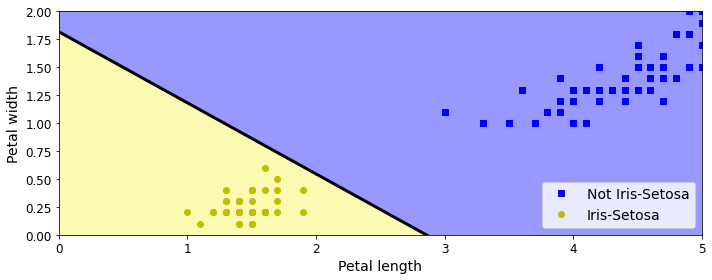

In [ ]:
a = -per_clf.coef_[0][0] / per_clf.coef_[0][1]
b = -per_clf.intercept_ / per_clf.coef_[0][1]

axes = [0, 5, 0, 2]

x0, x1 = np.meshgrid(
        np.linspace(axes[0], axes[1], 500).reshape(-1, 1),
        np.linspace(axes[2], axes[3], 200).reshape(-1, 1),
    )
X_new = np.c_[x0.ravel(), x1.ravel()]
y_predict = per_clf.predict(X_new)
zz = y_predict.reshape(x0.shape)

plt.figure(figsize=(10, 4))
plt.plot(X[y==0, 0], X[y==0, 1], "bs", label="Not Iris-Setosa")
plt.plot(X[y==1, 0], X[y==1, 1], "yo", label="Iris-Setosa")

plt.plot([axes[0], axes[1]], [a * axes[0] + b, a * axes[1] + b], "k-", linewidth=3)
from matplotlib.colors import ListedColormap
custom_cmap = ListedColormap(['#9898ff', '#fafab0'])

plt.contourf(x0, x1, zz, cmap=custom_cmap)
plt.xlabel("Petal length", fontsize=14)
plt.ylabel("Petal width", fontsize=14)
plt.legend(loc="lower right", fontsize=14)
plt.axis(axes)

save_fig("perceptron_iris_plot")
plt.show()

## Funções de ativação


In [ ]:
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

def relu(z):
    return np.maximum(0, z)

def derivative(f, z, eps=0.000001):
    return (f(z + eps) - f(z - eps))/(2 * eps)

Saving figure activation_functions_plot


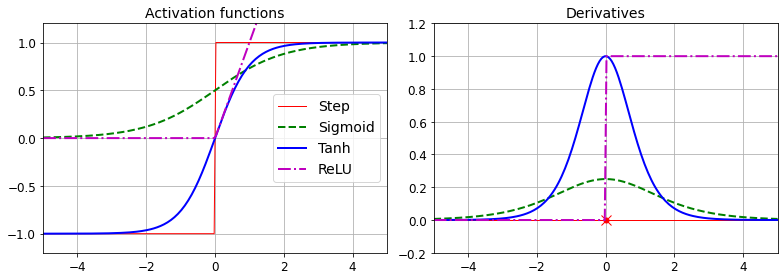

In [ ]:
z = np.linspace(-5, 5, 200)

plt.figure(figsize=(11,4))

plt.subplot(121)
plt.plot(z, np.sign(z), "r-", linewidth=1, label="Step")
plt.plot(z, sigmoid(z), "g--", linewidth=2, label="Sigmoid")
plt.plot(z, np.tanh(z), "b-", linewidth=2, label="Tanh")
plt.plot(z, relu(z), "m-.", linewidth=2, label="ReLU")
plt.grid(True)
plt.legend(loc="center right", fontsize=14)
plt.title("Activation functions", fontsize=14)
plt.axis([-5, 5, -1.2, 1.2])

plt.subplot(122)
plt.plot(z, derivative(np.sign, z), "r-", linewidth=1, label="Step")
plt.plot(0, 0, "ro", markersize=5)
plt.plot(0, 0, "rx", markersize=10)
plt.plot(z, derivative(sigmoid, z), "g--", linewidth=2, label="Sigmoid")
plt.plot(z, derivative(np.tanh, z), "b-", linewidth=2, label="Tanh")
plt.plot(z, derivative(relu, z), "m-.", linewidth=2, label="ReLU")
plt.grid(True)
#plt.legend(loc="center right", fontsize=14)
plt.title("Derivatives", fontsize=14)
plt.axis([-5, 5, -0.2, 1.2])

save_fig("activation_functions_plot")
plt.show()

In [ ]:
def heaviside(z):
    return (z >= 0).astype(z.dtype)

def mlp_xor(x1, x2, activation=heaviside):
    return activation(-activation(x1 + x2 - 1.5) + activation(x1 + x2 - 0.5) - 0.5)

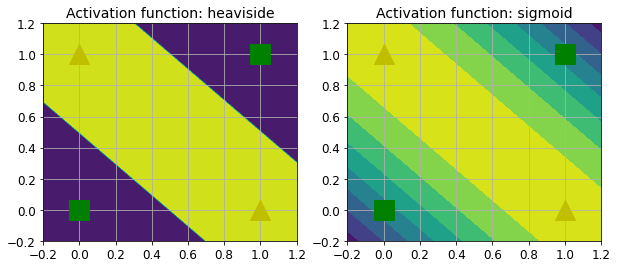

In [ ]:
x1s = np.linspace(-0.2, 1.2, 100)
x2s = np.linspace(-0.2, 1.2, 100)
x1, x2 = np.meshgrid(x1s, x2s)

z1 = mlp_xor(x1, x2, activation=heaviside)
z2 = mlp_xor(x1, x2, activation=sigmoid)

plt.figure(figsize=(10,4))

plt.subplot(121)
plt.contourf(x1, x2, z1)
plt.plot([0, 1], [0, 1], "gs", markersize=20)
plt.plot([0, 1], [1, 0], "y^", markersize=20)
plt.title("Activation function: heaviside", fontsize=14)
plt.grid(True)

plt.subplot(122)
plt.contourf(x1, x2, z2)
plt.plot([0, 1], [0, 1], "gs", markersize=20)
plt.plot([0, 1], [1, 0], "y^", markersize=20)
plt.title("Activation function: sigmoid", fontsize=14)
plt.grid(True)

## FNN para MNIST

### Usando a API Estimator (anteriormente `tf.contrib.learn`)

In [ ]:
import tensorflow as tf

**Aviso**: `tf.examples.tutorials.mnist` está obsoleto. Usaremos `tf.keras.datasets.mnist` em vez disso. Além disso, a API `tf.contrib.learn` foi promovida para `tf.estimators` e `tf.feature_columns`, e mudou consideravelmente. Em particular, não há função `infer_real_valued_columns_from_input()` ou classe `SKCompat`.


In [ ]:
(X_train, y_train), (X_test, y_test) = tf.keras.datasets.mnist.load_data()
X_train = X_train.astype(np.float32).reshape(-1, 28*28) / 255.0
X_test = X_test.astype(np.float32).reshape(-1, 28*28) / 255.0
y_train = y_train.astype(np.int32)
y_test = y_test.astype(np.int32)
X_valid, X_train = X_train[:5000], X_train[5000:]
y_valid, y_train = y_train[:5000], y_train[5000:]

Treinando um MLP com a API de Alto Nível do TensorFlow

In [ ]:
feature_cols = [tf.feature_column.numeric_column("X", shape=[28 * 28])]
dnn_clf = tf.estimator.DNNClassifier(hidden_units=[300,100], n_classes=10,
                                     feature_columns=feature_cols)

input_fn = tf.estimator.inputs.numpy_input_fn(
    x={"X": X_train}, y=y_train, num_epochs=40, batch_size=50, shuffle=True)
dnn_clf.train(input_fn=input_fn)

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': '/tmp/tmpn7tzk8th', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_experimental_max_worker_delay_secs': None, '_session_creation_timeout_secs': 7200, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x7f2d2135ef90>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done c

In [ ]:
test_input_fn = tf.estimator.inputs.numpy_input_fn(
    x={"X": X_test}, y=y_test, shuffle=False)
eval_results = dnn_clf.evaluate(input_fn=test_input_fn)

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2022-03-23T15:13:08Z
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /tmp/tmpn7tzk8th/model.ckpt-44000
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2022-03-23-15:13:09
INFO:tensorflow:Saving dict for global step 44000: accuracy = 0.9792, average_loss = 0.10527203, global_step = 44000, loss = 13.325574
INFO:tensorflow:Saving 'checkpoint_path' summary for global step 44000: /tmp/tmpn7tzk8th/model.ckpt-44000


In [ ]:
eval_results

{'accuracy': 0.9792,
 'average_loss': 0.10527203,
 'global_step': 44000,
 'loss': 13.325574}

In [ ]:
y_pred_iter = dnn_clf.predict(input_fn=test_input_fn)
y_pred = list(y_pred_iter)
y_pred[0]

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /tmp/tmpn7tzk8th/model.ckpt-44000
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


{'all_class_ids': array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int32),
 'all_classes': array([b'0', b'1', b'2', b'3', b'4', b'5', b'6', b'7', b'8', b'9'],
       dtype=object),
 'class_ids': array([7]),
 'classes': array([b'7'], dtype=object),
 'logits': array([-4.2451158, -1.0280647, -2.2806818,  0.5044475, -4.6234007,
        -9.068465 , -8.9397   , 18.930048 , -2.897838 ,  1.597627 ],
       dtype=float32),
 'probabilities': array([8.6130006e-11, 2.1493236e-09, 6.1418215e-10, 9.9509281e-09,
        5.9002123e-11, 6.9246952e-13, 7.8763070e-13, 1.0000000e+00,
        3.3133654e-10, 2.9691046e-08], dtype=float32)}

### Treinando um DNN Utilizando um TensorFlow Regular


O 
primeiro passo é a fase de construção do grafo do TensorFlow. O segundo passo é a fase 
de execução, na qual executamos o grafo para treinar o modelo.

####Fase de Construção

 Primeiro, precisamos importar a biblioteca tensorflow. Então, devemos especificar o número de entradas e saídas e configurar o número de neurônios 
escondidos em cada camada

In [ ]:
import tensorflow as tf

n_inputs = 28*28  # MNIST
n_hidden1 = 300
n_hidden2 = 100
n_outputs = 10

Em seguida, utilize os nós placeholders para representar os dados de treinamento e metas.

In [ ]:
reset_graph()

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

Agora, criaremos a rede neural real. O placeholder X agirá como a camada de entrada.

As duas camadas ocultas são quase idênticas: diferem apenas das entradas às quais 
estão conectadas e pelo número de neurônios que contêm. A camada de saída também 
é muito semelhante, mas utiliza uma função de ativação softmax em vez de uma função 
de ativação ReLU.

In [ ]:
# Função para a criação de uma camada de neurônio. 

def neuron_layer(X, n_neurons, name, activation=None):
    with tf.name_scope(name):
        n_inputs = int(X.get_shape()[1])
        stddev = 2 / np.sqrt(n_inputs)
        init = tf.truncated_normal((n_inputs, n_neurons), stddev=stddev)
        W = tf.Variable(init, name="kernel")
        b = tf.Variable(tf.zeros([n_neurons]), name="bias")
        Z = tf.matmul(X, W) + b
        if activation is not None:
            return activation(Z)
        else:
            return Z

A primeira camada oculta toma 
X como entrada. A segunda toma como entrada a saída da primeira camada oculta. E 
finalmente, a camada de saída toma como entrada a saída da segunda camada oculta.

In [ ]:

with tf.name_scope("dnn"):
    hidden1 = neuron_layer(X, n_hidden1, name="hidden1",
                           activation=tf.nn.relu)
    hidden2 = neuron_layer(hidden1, n_hidden2, name="hidden2",
                           activation=tf.nn.relu)
    logits = neuron_layer(hidden2, n_outputs, name="outputs")
# Modelo de rede neural

Usa-se aqui a entropia cruzada, pois penalizará os modelos que 
estimam uma baixa probabilidade para a classe-alvo. 

 Usaremos `sparse_soft max_cross_entropy_with_logits()`, que calcula a entropia cruzada com base em **logits** (ou seja, a saída da rede antes
de passar pela função de ativação softmax) e espera os rótulos na forma de números 
inteiros que variam de 0 ao número de classes menos 1 (no nosso caso, de 0 a 9).

A função `reduce_mean()` do TensorFlow para calcular a entropia cruzada média 
em todas as instâncias.

In [ ]:
# Função de custo
with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y,
                                                              logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

O GradientDescentOptimizer ajustará os parâmetros do modelo e minimizará a 
função de custo. 

In [ ]:
learning_rate = 0.01

with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    training_op = optimizer.minimize(loss)

O último passo importante na fase de construção é especificar como avaliar o modelo, 
e nós utilizaremos a acurácia como medida de desempenho. 

Primeiro, determine se a 
previsão da rede neural está correta para cada instância verificando se o logit mais alto 
corresponde ou não à classe-alvo. Para isto, você pode utilizar a função `in_top_k()` e, em seguida, calcular a média, gerando a acurácia geral da rede.

In [ ]:
with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))

Cria-se um nó para inicializar todas as variáveis e também 
um Saver para salvar os parâmetros treinados do modelo para o disco.

In [ ]:
init = tf.global_variables_initializer()
saver = tf.train.Saver()

Fim da fase de construção.


*   placeholders para as entradas e os alvos;
*   função para construir uma camada de neurônio (criou a DNN);
*   definiu-se a função de custo; 
*   criou-se um otimizador 
*   definiu-se a medida 
de desempenho



#### Fase de Execução

Definimos o número de épocas que queremos rodar, bem como o tamanho dos 
minilotes.

In [ ]:
n_epochs = 40
batch_size = 50

A seguir podemos treinar o modelo.

Este código abre uma sessão TensorFlow e executa o nó init que inicializa todas as 
variáveis. Depois, ele executa o loop principal de treinamento: em cada época, o 
código itera através de vários minilotes que correspondem ao tamanho do conjunto de 
treinamento. 

Cada minilote é buscado pelo método `next_batch()` e, então, o código 
executa a operação de treinamento fornecendo os dados de entrada de minilotes atuais 
e alvos. Em seguida, ao final de cada época, o código avalia o modelo no último minilote 
no conjunto completo de validação e imprime o resultado. 

Finalmente, os parâmetros 
do modelo são salvos no disco.

In [ ]:
def shuffle_batch(X, y, batch_size):
    rnd_idx = np.random.permutation(len(X))
    n_batches = len(X) // batch_size
    for batch_idx in np.array_split(rnd_idx, n_batches):
        X_batch, y_batch = X[batch_idx], y[batch_idx]
        yield X_batch, y_batch

####Utilizando a Rede Neural

Agora que a rede neural está treinada,pode-se usá-la para fazer previsões.

In [ ]:
with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        acc_batch = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        acc_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Batch accuracy:", acc_batch, "Val accuracy:", acc_val)

    save_path = saver.save(sess, "./my_model_final.ckpt")

0 Batch accuracy: 0.9 Val accuracy: 0.9146
1 Batch accuracy: 0.92 Val accuracy: 0.936
2 Batch accuracy: 0.96 Val accuracy: 0.945
3 Batch accuracy: 0.92 Val accuracy: 0.9514
4 Batch accuracy: 0.98 Val accuracy: 0.956
5 Batch accuracy: 0.96 Val accuracy: 0.9566
6 Batch accuracy: 1.0 Val accuracy: 0.9612
7 Batch accuracy: 0.94 Val accuracy: 0.9632
8 Batch accuracy: 0.98 Val accuracy: 0.965
9 Batch accuracy: 0.96 Val accuracy: 0.9662
10 Batch accuracy: 0.92 Val accuracy: 0.9686
11 Batch accuracy: 0.98 Val accuracy: 0.9686
12 Batch accuracy: 0.98 Val accuracy: 0.9672
13 Batch accuracy: 0.98 Val accuracy: 0.9708
14 Batch accuracy: 1.0 Val accuracy: 0.9714
15 Batch accuracy: 0.94 Val accuracy: 0.9732
16 Batch accuracy: 1.0 Val accuracy: 0.973
17 Batch accuracy: 1.0 Val accuracy: 0.974
18 Batch accuracy: 1.0 Val accuracy: 0.9748
19 Batch accuracy: 0.98 Val accuracy: 0.9744
20 Batch accuracy: 1.0 Val accuracy: 0.975
21 Batch accuracy: 1.0 Val accuracy: 0.9756
22 Batch accuracy: 0.98 Val accurac

O código a seguir carrega os parâmetros do modelo a partir do disco. Em seguida, 
carrega algumas novas imagens que classificará. 

**Lembre-se**: aplicar o mesmo escalonamento de características, assim como os dados de treinamento (neste caso, escalone-o 
de 0 a 1).

Depois, o código avalia o nó logits, aplicando a função `softmax()` 
aos logits se quisesse conhecer todas as probabilidades estimadas das classes, mas, se 
quisesse apenas prever uma classe, escolheria a que possui o maior valor de logit (a 
função `argmax()` cumpre essa tarefa).

In [ ]:
with tf.Session() as sess:
    saver.restore(sess, "./my_model_final.ckpt") # or better, use save_path
    X_new_scaled = X_test[:20]
    Z = logits.eval(feed_dict={X: X_new_scaled})
    y_pred = np.argmax(Z, axis=1)

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt


In [ ]:
print("Predicted classes:", y_pred)
print("Actual classes:   ", y_test[:20])

Predicted classes: [7 2 1 0 4 1 4 9 6 9 0 6 9 0 1 5 9 7 3 4]
Actual classes:    [7 2 1 0 4 1 4 9 5 9 0 6 9 0 1 5 9 7 3 4]


In [ ]:
from datetime import datetime

root_logdir = os.path.join(os.curdir, "tf_logs")

def make_log_subdir(run_id=None):
    if run_id is None:
        run_id = datetime.utcnow().strftime("%Y%m%d%H%M%S")
    return "{}/run-{}/".format(root_logdir, run_id)

def save_graph(graph=None, run_id=None):
    if graph is None:
        graph = tf.get_default_graph()
    logdir = make_log_subdir(run_id)
    file_writer = tf.summary.FileWriter(logdir, graph=graph)
    file_writer.close()
    return logdir

In [ ]:
save_graph()

'./tf_logs/run-20220323151527/'

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir {root_logdir}

Reusing TensorBoard on port 6006 (pid 937), started 0:59:06 ago. (Use '!kill 937' to kill it.)

### Usando `dense()` em vez de `neuron_layer()`


Nota: versões anteriores do livro usavam `tensorflow.contrib.layers.fully_connected()` em vez de `tf.layers.dense()` (que não existia quando este capítulo foi escrito). Agora é preferível usar `tf.layers.dense()`, porque qualquer coisa no módulo contrib pode ser alterada ou excluída sem aviso prévio. A função `dense()` é quase idêntica à função `full_connected()`, exceto por algumas pequenas diferenças:
* vários parâmetros são renomeados: `scope` torna-se `name`, `activation_fn` torna-se `activation` (e similarmente o sufixo `_fn` é removido de outros parâmetros como `normalizer_fn`), `weights_initializer` torna-se `kernel_initializer`, etc .
* o padrão `activation` agora é `None` em vez de `tf.nn.relu`.
* mais algumas diferenças são apresentadas no capítulo 11.

In [ ]:
n_inputs = 28*28  # MNIST
n_hidden1 = 300
n_hidden2 = 100
n_outputs = 10

In [ ]:
reset_graph()

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y") 

In [ ]:
with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, name="hidden1",
                              activation=tf.nn.relu)
    hidden2 = tf.layers.dense(hidden1, n_hidden2, name="hidden2",
                              activation=tf.nn.relu)
    logits = tf.layers.dense(hidden2, n_outputs, name="outputs")
    y_proba = tf.nn.softmax(logits)

In [ ]:
with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

In [ ]:
learning_rate = 0.01

with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    training_op = optimizer.minimize(loss)

In [ ]:
with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))

In [ ]:
init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
n_epochs = 20
n_batches = 50

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        acc_batch = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        acc_valid = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Batch accuracy:", acc_batch, "Validation accuracy:", acc_valid)

    save_path = saver.save(sess, "./my_model_final.ckpt")

0 Batch accuracy: 0.9 Validation accuracy: 0.9028
1 Batch accuracy: 0.92 Validation accuracy: 0.9252
2 Batch accuracy: 0.94 Validation accuracy: 0.9372
3 Batch accuracy: 0.9 Validation accuracy: 0.9418
4 Batch accuracy: 0.94 Validation accuracy: 0.9472
5 Batch accuracy: 0.94 Validation accuracy: 0.951
6 Batch accuracy: 1.0 Validation accuracy: 0.9552
7 Batch accuracy: 0.94 Validation accuracy: 0.9612
8 Batch accuracy: 0.96 Validation accuracy: 0.9618
9 Batch accuracy: 0.94 Validation accuracy: 0.965
10 Batch accuracy: 0.92 Validation accuracy: 0.9654
11 Batch accuracy: 0.98 Validation accuracy: 0.967
12 Batch accuracy: 0.98 Validation accuracy: 0.968
13 Batch accuracy: 0.98 Validation accuracy: 0.9702
14 Batch accuracy: 1.0 Validation accuracy: 0.9696
15 Batch accuracy: 0.94 Validation accuracy: 0.9716
16 Batch accuracy: 0.98 Validation accuracy: 0.9726
17 Batch accuracy: 1.0 Validation accuracy: 0.9728
18 Batch accuracy: 0.98 Validation accuracy: 0.9744
19 Batch accuracy: 0.98 Validat

In [ ]:
save_graph()

'./tf_logs/run-20220323151631/'

In [ ]:
%tensorboard --logdir {root_logdir}

#Capítulo 11

Treinando Redes Neurais Profundas

## Setup

Primeiro, vamos garantir que este notebook funcione bem em python 2 e 3, importe alguns módulos comuns, assegure-se de que o MatplotLib plote as figuras inline e prepare uma função para salvar as figuras:


In [ ]:
# To support both python 2 and python 3
from __future__ import division, print_function, unicode_literals

# Common imports
import numpy as np
import os

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 1.x
except Exception:
    pass

# to make this notebook's output stable across runs
def reset_graph(seed=42):
    tf.reset_default_graph()
    tf.set_random_seed(seed)
    np.random.seed(seed)

# To plot pretty figures
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "deep"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

TensorFlow 1.x selected.


## Problemas dos Gradientes: Vanishing/Exploding

In [ ]:
def logit(z):
    return 1 / (1 + np.exp(-z))

Saving figure sigmoid_saturation_plot


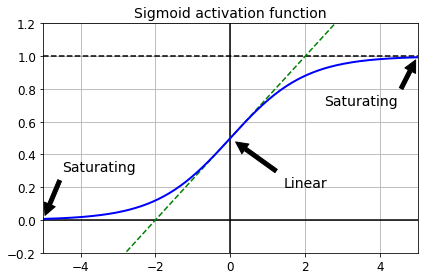

In [ ]:
z = np.linspace(-5, 5, 200)

plt.plot([-5, 5], [0, 0], 'k-')
plt.plot([-5, 5], [1, 1], 'k--')
plt.plot([0, 0], [-0.2, 1.2], 'k-')
plt.plot([-5, 5], [-3/4, 7/4], 'g--')
plt.plot(z, logit(z), "b-", linewidth=2)
props = dict(facecolor='black', shrink=0.1)
plt.annotate('Saturating', xytext=(3.5, 0.7), xy=(5, 1), arrowprops=props, fontsize=14, ha="center")
plt.annotate('Saturating', xytext=(-3.5, 0.3), xy=(-5, 0), arrowprops=props, fontsize=14, ha="center")
plt.annotate('Linear', xytext=(2, 0.2), xy=(0, 0.5), arrowprops=props, fontsize=14, ha="center")
plt.grid(True)
plt.title("Sigmoid activation function", fontsize=14)
plt.axis([-5, 5, -0.2, 1.2])

save_fig("sigmoid_saturation_plot")
plt.show()

### Inicialização Xavier e Inicialização He

**Nota:** o livro usa `tensorflow.contrib.layers.fully_connected()` em vez de `tf.layers.dense()`. Agora é preferível usar `tf.layers.dense()`, porque qualquer coisa no módulo contrib pode ser alterada ou excluída sem aviso prévio. A função `dense()` é quase idêntica à função `full_connected()`. As principais diferenças relevantes são:
* vários parâmetros são renomeados: `scope` torna-se `name`, `activation_fn` torna-se `activation` (e similarmente o sufixo `_fn` é removido de outros parâmetros como `normalizer_fn`), `weights_initializer` torna-se `kernel_initializer` , etc .
* o padrão `activation` agora é `None` em vez de `tf.nn.relu`.
* não suporta `tensorflow.contrib.framework.arg_scope()`.
* não suporta parâmetros do regularizador.

In [ ]:
import tensorflow as tf

In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")

Por padrão, a função `tf.layers.dense()` utiliza a inicialização Xavier (com uma distribuição uniforme), mas é possível mudar para a inicialização 
He usando a função `variance_scaling_initializer()`

In [ ]:
he_init = tf.variance_scaling_initializer()
hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu,
                          kernel_initializer=he_init, name="hidden1")

Instructions for updating:
Use keras.layers.Dense instead.
Instructions for updating:
Please use `layer.__call__` method instead.


### Funções de Ativação Não Saturadas

#### Leaky ReLU

In [ ]:
def leaky_relu(z, alpha=0.01):
    return np.maximum(alpha*z, z)

Saving figure leaky_relu_plot


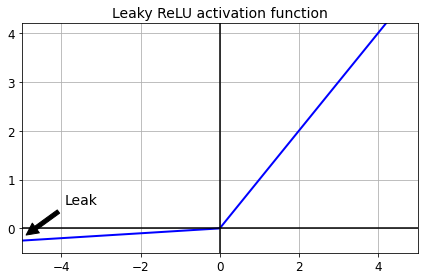

In [ ]:
plt.plot(z, leaky_relu(z, 0.05), "b-", linewidth=2)
plt.plot([-5, 5], [0, 0], 'k-')
plt.plot([0, 0], [-0.5, 4.2], 'k-')
plt.grid(True)
props = dict(facecolor='black', shrink=0.1)
plt.annotate('Leak', xytext=(-3.5, 0.5), xy=(-5, -0.2), arrowprops=props, fontsize=14, ha="center")
plt.title("Leaky ReLU activation function", fontsize=14)
plt.axis([-5, 5, -0.5, 4.2])

save_fig("leaky_relu_plot")
plt.show()

Implementando o Leaky ReLU no TensorFlow:


In [ ]:
reset_graph()

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")

O TensorFlow oferece a função `elu()` que pode ser utilizada na construção de sua rede 
neural. 

O argumento **activation** é configurado da seguinte forma ao chamar a função `dense()`:

In [ ]:
def leaky_relu(z, name=None):
    return tf.maximum(0.01 * z, z, name=name)

hidden1 = tf.layers.dense(X, n_hidden1, activation=leaky_relu, name="hidden1")

Vamos treinar uma rede neural no MNIST usando o Leaky ReLU. Primeiro vamos criar o gráfico:


In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300
n_hidden2 = 100
n_outputs = 10

In [ ]:
X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

In [ ]:
with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=leaky_relu, name="hidden1")
    hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=leaky_relu, name="hidden2")
    logits = tf.layers.dense(hidden2, n_outputs, name="outputs")

In [ ]:
with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

In [ ]:
learning_rate = 0.01

with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    training_op = optimizer.minimize(loss)

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


In [ ]:
with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))

In [ ]:
init = tf.global_variables_initializer()
saver = tf.train.Saver()

Vamos carregar os dados:


**Aviso**: `tf.examples.tutorials.mnist` está obsoleto. Usaremos `tf.keras.datasets.mnist` em vez disso.


In [ ]:
(X_train, y_train), (X_test, y_test) = tf.keras.datasets.mnist.load_data()
X_train = X_train.astype(np.float32).reshape(-1, 28*28) / 255.0
X_test = X_test.astype(np.float32).reshape(-1, 28*28) / 255.0
y_train = y_train.astype(np.int32)
y_test = y_test.astype(np.int32)
X_valid, X_train = X_train[:5000], X_train[5000:]
y_valid, y_train = y_train[:5000], y_train[5000:]

11493376/11490434 [==============================] - 0s 0us/step


In [ ]:
def shuffle_batch(X, y, batch_size):
    rnd_idx = np.random.permutation(len(X))
    n_batches = len(X) // batch_size
    for batch_idx in np.array_split(rnd_idx, n_batches):
        X_batch, y_batch = X[batch_idx], y[batch_idx]
        yield X_batch, y_batch

In [ ]:
n_epochs = 40
batch_size = 50

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        if epoch % 5 == 0:
            acc_batch = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
            acc_valid = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
            print(epoch, "Batch accuracy:", acc_batch, "Validation accuracy:", acc_valid)

    save_path = saver.save(sess, "./my_model_final.ckpt")

0 Batch accuracy: 0.86 Validation accuracy: 0.904
5 Batch accuracy: 0.94 Validation accuracy: 0.9496
10 Batch accuracy: 0.92 Validation accuracy: 0.9652
15 Batch accuracy: 0.94 Validation accuracy: 0.9706
20 Batch accuracy: 1.0 Validation accuracy: 0.9762
25 Batch accuracy: 1.0 Validation accuracy: 0.9776
30 Batch accuracy: 0.98 Validation accuracy: 0.9782
35 Batch accuracy: 1.0 Validation accuracy: 0.9786


### ELU

In [ ]:
def elu(z, alpha=1):
    return np.where(z < 0, alpha * (np.exp(z) - 1), z)

Saving figure elu_plot


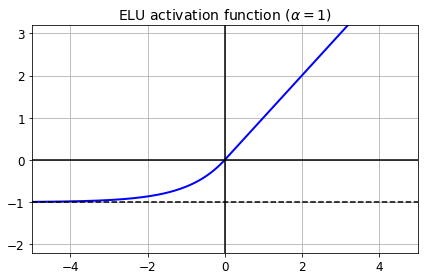

In [ ]:
plt.plot(z, elu(z), "b-", linewidth=2)
plt.plot([-5, 5], [0, 0], 'k-')
plt.plot([-5, 5], [-1, -1], 'k--')
plt.plot([0, 0], [-2.2, 3.2], 'k-')
plt.grid(True)
plt.title(r"ELU activation function ($\alpha=1$)", fontsize=14)
plt.axis([-5, 5, -2.2, 3.2])

save_fig("elu_plot")
plt.show()

Implementar ELU no TensorFlow é trivial, basta especificar a função de ativação ao construir cada camada:


In [ ]:
reset_graph()

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")

In [ ]:
hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.elu, name="hidden1")

### SELU

This activation function was proposed in this [great paper](https://arxiv.org/pdf/1706.02515.pdf) by Günter Klambauer, Thomas Unterthiner and Andreas Mayr, published in June 2017. During training, a neural network composed exclusively of a stack of dense layers using the SELU activation function and LeCun initialization will self-normalize: the output of each layer will tend to preserve the same mean and variance during training, which solves the vanishing/exploding gradients problem. As a result, this activation function outperforms the other activation functions very significantly for such neural nets, so you should really try it out. Unfortunately, the self-normalizing property of the SELU activation function is easily broken: you cannot use ℓ<sub>1</sub> or ℓ<sub>2</sub> regularization, regular dropout, max-norm, skip connections or other non-sequential topologies (so recurrent neural networks won't self-normalize). However, in practice it works quite well with sequential CNNs. If you break self-normalization, SELU will not necessarily outperform other activation functions.

In [ ]:
from scipy.special import erfc

# alpha and scale to self normalize with mean 0 and standard deviation 1
# (see equation 14 in the paper):
alpha_0_1 = -np.sqrt(2 / np.pi) / (erfc(1/np.sqrt(2)) * np.exp(1/2) - 1)
scale_0_1 = (1 - erfc(1 / np.sqrt(2)) * np.sqrt(np.e)) * np.sqrt(2 * np.pi) * (2 * erfc(np.sqrt(2))*np.e**2 + np.pi*erfc(1/np.sqrt(2))**2*np.e - 2*(2+np.pi)*erfc(1/np.sqrt(2))*np.sqrt(np.e)+np.pi+2)**(-1/2)

In [ ]:
def selu(z, scale=scale_0_1, alpha=alpha_0_1):
    return scale * elu(z, alpha)

Saving figure selu_plot


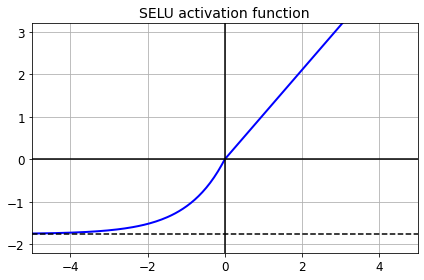

In [ ]:
plt.plot(z, selu(z), "b-", linewidth=2)
plt.plot([-5, 5], [0, 0], 'k-')
plt.plot([-5, 5], [-1.758, -1.758], 'k--')
plt.plot([0, 0], [-2.2, 3.2], 'k-')
plt.grid(True)
plt.title(r"SELU activation function", fontsize=14)
plt.axis([-5, 5, -2.2, 3.2])

save_fig("selu_plot")
plt.show()

By default, the SELU hyperparameters (`scale` and `alpha`) are tuned in such a way that the mean output of each neuron remains close to 0, and the standard deviation remains close to 1 (assuming the inputs are standardized with mean 0 and standard deviation 1 too). Using this activation function, even a 1,000 layer deep neural network preserves roughly mean 0 and standard deviation 1 across all layers, avoiding the exploding/vanishing gradients problem:

In [ ]:
np.random.seed(42)
Z = np.random.normal(size=(500, 100)) # standardized inputs
for layer in range(1000):
    W = np.random.normal(size=(100, 100), scale=np.sqrt(1 / 100)) # LeCun initialization
    Z = selu(np.dot(Z, W))
    means = np.mean(Z, axis=0).mean()
    stds = np.std(Z, axis=0).mean()
    if layer % 100 == 0:
        print("Layer {}: mean {:.2f}, std deviation {:.2f}".format(layer, means, stds))

Layer 0: mean -0.00, std deviation 1.00
Layer 100: mean 0.02, std deviation 0.96
Layer 200: mean 0.01, std deviation 0.90
Layer 300: mean -0.02, std deviation 0.92
Layer 400: mean 0.05, std deviation 0.89
Layer 500: mean 0.01, std deviation 0.93
Layer 600: mean 0.02, std deviation 0.92
Layer 700: mean -0.02, std deviation 0.90
Layer 800: mean 0.05, std deviation 0.83
Layer 900: mean 0.02, std deviation 1.00


The `tf.nn.selu()` function was added in TensorFlow 1.4. For earlier versions, you can use the following implementation:

In [ ]:
def selu(z, scale=alpha_0_1, alpha=scale_0_1):
    return scale * tf.where(z >= 0.0, z, alpha * tf.nn.elu(z))

However, the SELU activation function cannot be used along with regular Dropout (this would cancel the SELU activation function's self-normalizing property). Fortunately, there is a Dropout variant called Alpha Dropout proposed in the same paper. It is available in `tf.contrib.nn.alpha_dropout()` since TF 1.4 (or check out [this implementation](https://github.com/bioinf-jku/SNNs/blob/master/selu.py) by the Institute of Bioinformatics, Johannes Kepler University Linz).

Let's create a neural net for MNIST using the SELU activation function:

In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300
n_hidden2 = 100
n_outputs = 10

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=selu, name="hidden1")
    hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=selu, name="hidden2")
    logits = tf.layers.dense(hidden2, n_outputs, name="outputs")

with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

learning_rate = 0.01

with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    training_op = optimizer.minimize(loss)

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))

init = tf.global_variables_initializer()
saver = tf.train.Saver()
n_epochs = 40
batch_size = 50

Now let's train it. Do not forget to scale the inputs to mean 0 and standard deviation 1:

In [ ]:
means = X_train.mean(axis=0, keepdims=True)
stds = X_train.std(axis=0, keepdims=True) + 1e-10
X_val_scaled = (X_valid - means) / stds

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            X_batch_scaled = (X_batch - means) / stds
            sess.run(training_op, feed_dict={X: X_batch_scaled, y: y_batch})
        if epoch % 5 == 0:
            acc_batch = accuracy.eval(feed_dict={X: X_batch_scaled, y: y_batch})
            acc_valid = accuracy.eval(feed_dict={X: X_val_scaled, y: y_valid})
            print(epoch, "Batch accuracy:", acc_batch, "Validation accuracy:", acc_valid)

    save_path = saver.save(sess, "./my_model_final_selu.ckpt")

0 Batch accuracy: 0.94 Validation accuracy: 0.9388
5 Batch accuracy: 0.98 Validation accuracy: 0.9634
10 Batch accuracy: 1.0 Validation accuracy: 0.9694
15 Batch accuracy: 1.0 Validation accuracy: 0.9706
20 Batch accuracy: 1.0 Validation accuracy: 0.969
25 Batch accuracy: 1.0 Validation accuracy: 0.9692
30 Batch accuracy: 1.0 Validation accuracy: 0.9706
35 Batch accuracy: 1.0 Validation accuracy: 0.9706


## Batch Normalization

**Nota:** o livro usa `tensorflow.contrib.layers.batch_norm()` em vez de `tf.layers.batch_normalization()` (que não existia quando este capítulo foi escrito). Agora é preferível usar `tf.layers.batch_normalization()`, porque qualquer coisa no módulo contrib pode ser alterada ou excluída sem aviso prévio. Em vez de usar a função `batch_norm()` como um parâmetro regularizador para a função `full_connected()`, agora usamos `batch_normalization()` e criamos explicitamente uma camada distinta. Os parâmetros são um pouco diferentes, em particular:

* `decay` é renomeado para `momentum`,
* `is_training` é renomeado para `training`,
* `updates_collections` foi removido: as operações de atualização necessárias para normalização em lote são adicionadas à coleção `UPDATE_OPS` e você precisa executar explicitamente essas operações durante o treinamento (veja a fase de execução abaixo),
* não precisamos especificar `scale=True`, pois esse é o padrão.

Observe também que para executar a norma de lote apenas _antes_ da função de ativação de cada camada oculta, aplicamos a função de ativação ELU manualmente, logo após a camada de norma de lote.


**Nota:** como a função `tf.layers.dense()` é incompatível com `tf.contrib.layers.arg_scope()` (que é usada no livro), agora usamos a função `functools.partial()` do python . Isso facilita a criação de uma função `my_dense_layer()` que apenas chama `tf.layers.dense()` com os parâmetros desejados definidos automaticamente (a menos que sejam substituídos ao chamar `my_dense_layer()`). Como você pode ver, o código permanece muito semelhante.

Durante o treinamento, vamos configur o *placeholder training* para True, senão o padrão será False. Isto será utilizado para dizer à função 
`tf.layers.batch_normalization()` se ela deve utilizar a média atual dos minilotes e 
desvio padrão (durante o treinamento) ou a média de todo o conjunto de treinamento 
e desvio padrão (durante o teste).


Em seguida, alternamos camadas totalmente conectadas e camadas de normalização em 
lote: quando utilizamos a função `tf.layers.dense()`, as camadas totalmente conectadas 
são criadas.



In [ ]:
reset_graph()

import tensorflow as tf

n_inputs = 28 * 28
n_hidden1 = 300
n_hidden2 = 100
n_outputs = 10

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")

training = tf.placeholder_with_default(False, shape=(), name='training')

hidden1 = tf.layers.dense(X, n_hidden1, name="hidden1")
bn1 = tf.layers.batch_normalization(hidden1, training=training, momentum=0.9)
bn1_act = tf.nn.elu(bn1)

hidden2 = tf.layers.dense(bn1_act, n_hidden2, name="hidden2")
bn2 = tf.layers.batch_normalization(hidden2, training=training, momentum=0.9)
bn2_act = tf.nn.elu(bn2)

logits_before_bn = tf.layers.dense(bn2_act, n_outputs, name="outputs")
logits = tf.layers.batch_normalization(logits_before_bn, training=training,
                                       momentum=0.9)

Instructions for updating:
Use keras.layers.BatchNormalization instead.  In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.batch_normalization` documentation).



Com a utilização da 
função `tf.layers.batch_normalization()`, criamos as camadas de normalização em lote 
configurando seus parâmetros training e momentum.

In [ ]:
reset_graph()

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
training = tf.placeholder_with_default(False, shape=(), name='training')

Para evitar repetir os mesmos parâmetros repetidamente, podemos usar a função `partial()` do Python:


In [ ]:
from functools import partial

my_batch_norm_layer = partial(tf.layers.batch_normalization,
                              training=training, momentum=0.9)

hidden1 = tf.layers.dense(X, n_hidden1, name="hidden1")
bn1 = my_batch_norm_layer(hidden1)
bn1_act = tf.nn.elu(bn1)
hidden2 = tf.layers.dense(bn1_act, n_hidden2, name="hidden2")
bn2 = my_batch_norm_layer(hidden2)
bn2_act = tf.nn.elu(bn2)
logits_before_bn = tf.layers.dense(bn2_act, n_outputs, name="outputs")
logits = my_batch_norm_layer(logits_before_bn)

O resto da fase de construção é o mesmo do Capítulo 10: definir a função de custo, 
criar um otimizador, instruí-lo a minimizar a função de custo, definir as operações de 
avaliação, criar um inicializador de variáveis, criar um Saver e assim por diante.


Vamos construir uma rede neural para MNIST, usando a função de ativação ELU e Normalização em lote em cada camada:




> A fase de execução também é praticamente a mesma com duas exceções. Primeiro, 
durante o treinamento, você precisa definir o placeholder training para True sempre 
que executar uma operação que depende da camada batch_normalization().



In [ ]:
reset_graph()

batch_norm_momentum = 0.9

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")
training = tf.placeholder_with_default(False, shape=(), name='training')

with tf.name_scope("dnn"):
    he_init = tf.variance_scaling_initializer()

    my_batch_norm_layer = partial(
            tf.layers.batch_normalization,
            training=training,
            momentum=batch_norm_momentum)

    my_dense_layer = partial(
            tf.layers.dense,
            kernel_initializer=he_init)

    hidden1 = my_dense_layer(X, n_hidden1, name="hidden1")
    bn1 = tf.nn.elu(my_batch_norm_layer(hidden1))
    hidden2 = my_dense_layer(bn1, n_hidden2, name="hidden2")
    bn2 = tf.nn.elu(my_batch_norm_layer(hidden2))
    logits_before_bn = my_dense_layer(bn2, n_outputs, name="outputs")
    logits = my_batch_norm_layer(logits_before_bn)

with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    training_op = optimizer.minimize(loss)

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))
    
init = tf.global_variables_initializer()
saver = tf.train.Saver()

**Nota:** como estamos usando `tf.layers.batch_normalization()` em vez de `tf.contrib.layers.batch_norm()` (como no livro), precisamos executar explicitamente as operações extras de atualização necessárias para normalização em lote (` sess.run([training_op, extra_update_ops],...`).


In [ ]:
n_epochs = 20
batch_size = 200



>  Segundo, a função batch_normalization() cria algumas operações que devem ser avaliadas em 
cada etapa durante o treinamento a fim de atualizar as médias móveis (lembre-se de que 
essas médias móveis são necessárias na avaliação da média e desvio padrão do conjunto 
de treinamento). Essas operações são adicionadas automaticamente à coleção UPDATE_OPS, 
então apenas precisamos obter a lista de operações nessa coleção e executá-las em cada 
iteração do treinamento.



In [ ]:
extra_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run([training_op, extra_update_ops],
                     feed_dict={training: True, X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Validation accuracy:", accuracy_val)

    save_path = saver.save(sess, "./my_model_final.ckpt")

0 Validation accuracy: 0.8952
1 Validation accuracy: 0.9202
2 Validation accuracy: 0.9318
3 Validation accuracy: 0.9422
4 Validation accuracy: 0.9468
5 Validation accuracy: 0.954
6 Validation accuracy: 0.9568
7 Validation accuracy: 0.96
8 Validation accuracy: 0.962
9 Validation accuracy: 0.9638
10 Validation accuracy: 0.9662
11 Validation accuracy: 0.9682
12 Validation accuracy: 0.9672
13 Validation accuracy: 0.9696
14 Validation accuracy: 0.9706
15 Validation accuracy: 0.9704
16 Validation accuracy: 0.9718
17 Validation accuracy: 0.9726
18 Validation accuracy: 0.9738
19 Validation accuracy: 0.9742


ISSO!? Isso não é uma grande precisão para MNIST. É claro que, se você treinar por mais tempo, obterá uma precisão muito melhor, mas com uma rede tão rasa, é improvável que o Batch Norm e o ELU tenham um impacto muito positivo: eles brilham principalmente para redes muito mais profundas.


Observe que você também pode fazer com que a operação de treinamento dependa das operações de atualização:


```python
with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    extra_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    with tf.control_dependencies(extra_update_ops):
        training_op = optimizer.minimize(loss)
```

Dessa forma, você só teria que avaliar o `training_op` durante o treinamento, o TensorFlow também executaria automaticamente as operações de atualização:


```python
sess.run(training_op, feed_dict={training: True, X: X_batch, y: y_batch})
```

Mais uma coisa: observe que a lista de variáveis ​​treináveis ​​é menor que a lista de todas as variáveis ​​globais. Isso ocorre porque as médias móveis são variáveis ​​não treináveis. Se você deseja reutilizar uma rede neural pré-treinada (veja abaixo), você não deve esquecer essas variáveis ​​não treináveis.


In [ ]:
[v.name for v in tf.trainable_variables()]

['hidden1/kernel:0',
 'hidden1/bias:0',
 'batch_normalization/gamma:0',
 'batch_normalization/beta:0',
 'hidden2/kernel:0',
 'hidden2/bias:0',
 'batch_normalization_1/gamma:0',
 'batch_normalization_1/beta:0',
 'outputs/kernel:0',
 'outputs/bias:0',
 'batch_normalization_2/gamma:0',
 'batch_normalization_2/beta:0']

In [ ]:
[v.name for v in tf.global_variables()]

['hidden1/kernel:0',
 'hidden1/bias:0',
 'batch_normalization/gamma:0',
 'batch_normalization/beta:0',
 'batch_normalization/moving_mean:0',
 'batch_normalization/moving_variance:0',
 'hidden2/kernel:0',
 'hidden2/bias:0',
 'batch_normalization_1/gamma:0',
 'batch_normalization_1/beta:0',
 'batch_normalization_1/moving_mean:0',
 'batch_normalization_1/moving_variance:0',
 'outputs/kernel:0',
 'outputs/bias:0',
 'batch_normalization_2/gamma:0',
 'batch_normalization_2/beta:0',
 'batch_normalization_2/moving_mean:0',
 'batch_normalization_2/moving_variance:0']

## Gradient Clipping

Vamos criar uma rede neural simples para MNIST e adicionar recorte de gradiente. A primeira parte é a mesma de antes (exceto que adicionamos mais algumas camadas para demonstrar a reutilização de modelos pré-treinados, veja abaixo):


In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300
n_hidden2 = 50
n_hidden3 = 50
n_hidden4 = 50
n_hidden5 = 50
n_outputs = 10

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu, name="hidden1")
    hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=tf.nn.relu, name="hidden2")
    hidden3 = tf.layers.dense(hidden2, n_hidden3, activation=tf.nn.relu, name="hidden3")
    hidden4 = tf.layers.dense(hidden3, n_hidden4, activation=tf.nn.relu, name="hidden4")
    hidden5 = tf.layers.dense(hidden4, n_hidden5, activation=tf.nn.relu, name="hidden5")
    logits = tf.layers.dense(hidden5, n_outputs, name="outputs")

with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

In [ ]:
learning_rate = 0.01

Agora aplicamos o recorte de gradiente. Para isso, precisamos obter os gradientes, usar a função `clip_by_value()` para cortá-los e aplicá-los:


In [ ]:
threshold = 1.0

optimizer = tf.train.GradientDescentOptimizer(learning_rate)
grads_and_vars = optimizer.compute_gradients(loss)
capped_gvs = [(tf.clip_by_value(grad, -threshold, threshold), var)
              for grad, var in grads_and_vars]
training_op = optimizer.apply_gradients(capped_gvs)

O resto é o mesmo de sempre:


In [ ]:
with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32), name="accuracy")

In [ ]:
init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
n_epochs = 20
batch_size = 200

In [ ]:
with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Validation accuracy:", accuracy_val)

    save_path = saver.save(sess, "./my_model_final.ckpt")

0 Validation accuracy: 0.288
1 Validation accuracy: 0.7942
2 Validation accuracy: 0.8798
3 Validation accuracy: 0.906
4 Validation accuracy: 0.9162
5 Validation accuracy: 0.9216
6 Validation accuracy: 0.9292
7 Validation accuracy: 0.9356
8 Validation accuracy: 0.938
9 Validation accuracy: 0.9414
10 Validation accuracy: 0.9456
11 Validation accuracy: 0.9472
12 Validation accuracy: 0.9476
13 Validation accuracy: 0.9534
14 Validation accuracy: 0.957
15 Validation accuracy: 0.9564
16 Validation accuracy: 0.9576
17 Validation accuracy: 0.959
18 Validation accuracy: 0.9624
19 Validation accuracy: 0.9612


### Reutilizando Camadas Pré-Treinadas

### Reusing a TensorFlow Model

Primeiro você precisa carregar a estrutura do gráfico. A função `import_meta_graph()` faz exatamente isso, carregando as operações do gráfico no gráfico padrão e retornando um `Saver` que você pode usar para restaurar o estado do modelo. Observe que, por padrão, um `Saver` salva a estrutura do gráfico em um arquivo `.meta`, então esse é o arquivo que você deve carregar:


In [ ]:
reset_graph()

In [ ]:
saver = tf.train.import_meta_graph("./my_model_final.ckpt.meta")

Em seguida, você precisa entender todas as operações necessárias para o treinamento. Se você não conhece a estrutura do gráfico, pode listar todas as operações:


In [ ]:
for op in tf.get_default_graph().get_operations():
    print(op.name)

X
y
hidden1/kernel/Initializer/random_uniform/shape
hidden1/kernel/Initializer/random_uniform/min
hidden1/kernel/Initializer/random_uniform/max
hidden1/kernel/Initializer/random_uniform/RandomUniform
hidden1/kernel/Initializer/random_uniform/sub
hidden1/kernel/Initializer/random_uniform/mul
hidden1/kernel/Initializer/random_uniform
hidden1/kernel
hidden1/kernel/Assign
hidden1/kernel/read
hidden1/bias/Initializer/zeros
hidden1/bias
hidden1/bias/Assign
hidden1/bias/read
dnn/hidden1/MatMul
dnn/hidden1/BiasAdd
dnn/hidden1/Relu
hidden2/kernel/Initializer/random_uniform/shape
hidden2/kernel/Initializer/random_uniform/min
hidden2/kernel/Initializer/random_uniform/max
hidden2/kernel/Initializer/random_uniform/RandomUniform
hidden2/kernel/Initializer/random_uniform/sub
hidden2/kernel/Initializer/random_uniform/mul
hidden2/kernel/Initializer/random_uniform
hidden2/kernel
hidden2/kernel/Assign
hidden2/kernel/read
hidden2/bias/Initializer/zeros
hidden2/bias
hidden2/bias/Assign
hidden2/bias/read
dn

Ops, são muitas operações! É muito mais fácil usar o TensorBoard para visualizar o gráfico:


In [ ]:
from datetime import datetime

root_logdir = os.path.join(os.curdir, "tf_logs")

def make_log_subdir(run_id=None):
    if run_id is None:
        run_id = datetime.utcnow().strftime("%Y%m%d%H%M%S")
    return "{}/run-{}/".format(root_logdir, run_id)

def save_graph(graph=None, run_id=None):
    if graph is None:
        graph = tf.get_default_graph()
    logdir = make_log_subdir(run_id)
    file_writer = tf.summary.FileWriter(logdir, graph=graph)
    file_writer.close()
    return logdir

In [ ]:
save_graph()

'./tf_logs/run-20220324185443/'

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir {root_logdir}

Depois de saber de quais operações você precisa, você pode manipulá-las usando os métodos `get_operation_by_name()` ou `get_tensor_by_name()` do gráfico:


In [ ]:
X = tf.get_default_graph().get_tensor_by_name("X:0")
y = tf.get_default_graph().get_tensor_by_name("y:0")

accuracy = tf.get_default_graph().get_tensor_by_name("eval/accuracy:0")

training_op = tf.get_default_graph().get_operation_by_name("GradientDescent")

Se você for o autor do modelo original, poderá facilitar as coisas para as pessoas que irão reutilizar seu modelo, dando às operações nomes muito claros e documentando-as. Outra abordagem é criar uma coleção contendo todas as operações importantes que as pessoas vão querer controlar.


In [ ]:
for op in (X, y, accuracy, training_op):
    tf.add_to_collection("my_important_ops", op)

Dessa forma, as pessoas que reutilizarem seu modelo poderão simplesmente escrever:


In [ ]:
X, y, accuracy, training_op = tf.get_collection("my_important_ops")

Agora você pode iniciar uma sessão, restaurar o estado do modelo e continuar treinando seus dados:


In [ ]:
with tf.Session() as sess:
    saver.restore(sess, "./my_model_final.ckpt")
    # continue training the model...

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt


Na verdade, vamos testar isso de verdade!


In [ ]:
with tf.Session() as sess:
    saver.restore(sess, "./my_model_final.ckpt")

    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Validation accuracy:", accuracy_val)

    save_path = saver.save(sess, "./my_new_model_final.ckpt")    

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt
0 Validation accuracy: 0.9638
1 Validation accuracy: 0.9632
2 Validation accuracy: 0.9652
3 Validation accuracy: 0.9652
4 Validation accuracy: 0.9642
5 Validation accuracy: 0.965
6 Validation accuracy: 0.9686
7 Validation accuracy: 0.9684
8 Validation accuracy: 0.9682
9 Validation accuracy: 0.9688
10 Validation accuracy: 0.9704
11 Validation accuracy: 0.9716
12 Validation accuracy: 0.9672
13 Validation accuracy: 0.9704
14 Validation accuracy: 0.9708
15 Validation accuracy: 0.9722
16 Validation accuracy: 0.9718
17 Validation accuracy: 0.9712
18 Validation accuracy: 0.9714
19 Validation accuracy: 0.9714


Alternativamente, se você tiver acesso ao código Python que construiu o gráfico original, você pode usá-lo em vez de `import_meta_graph()`:


In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300
n_hidden2 = 50
n_hidden3 = 50
n_hidden4 = 50
n_hidden5 = 50
n_outputs = 10

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu, name="hidden1")
    hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=tf.nn.relu, name="hidden2")
    hidden3 = tf.layers.dense(hidden2, n_hidden3, activation=tf.nn.relu, name="hidden3")
    hidden4 = tf.layers.dense(hidden3, n_hidden4, activation=tf.nn.relu, name="hidden4")
    hidden5 = tf.layers.dense(hidden4, n_hidden5, activation=tf.nn.relu, name="hidden5")
    logits = tf.layers.dense(hidden5, n_outputs, name="outputs")

with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32), name="accuracy")

learning_rate = 0.01
threshold = 1.0

optimizer = tf.train.GradientDescentOptimizer(learning_rate)
grads_and_vars = optimizer.compute_gradients(loss)
capped_gvs = [(tf.clip_by_value(grad, -threshold, threshold), var)
              for grad, var in grads_and_vars]
training_op = optimizer.apply_gradients(capped_gvs)

saver = tf.train.Saver()

E continue treinando:


In [ ]:
with tf.Session() as sess:
    saver.restore(sess, "./my_model_final.ckpt")

    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Validation accuracy:", accuracy_val)

    save_path = saver.save(sess, "./my_new_model_final.ckpt")    

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt
0 Validation accuracy: 0.9638
1 Validation accuracy: 0.9632
2 Validation accuracy: 0.9652
3 Validation accuracy: 0.9652
4 Validation accuracy: 0.9642
5 Validation accuracy: 0.965
6 Validation accuracy: 0.9686
7 Validation accuracy: 0.9684
8 Validation accuracy: 0.9682
9 Validation accuracy: 0.9688
10 Validation accuracy: 0.9704
11 Validation accuracy: 0.9716
12 Validation accuracy: 0.9672
13 Validation accuracy: 0.9704
14 Validation accuracy: 0.9708
15 Validation accuracy: 0.9722
16 Validation accuracy: 0.9718
17 Validation accuracy: 0.9712
18 Validation accuracy: 0.9714
19 Validation accuracy: 0.9714


Em geral, você desejará reutilizar apenas as camadas inferiores. Se você estiver usando `import_meta_graph()` ele irá carregar o gráfico inteiro, mas você pode simplesmente ignorar as partes que você não precisa. Neste exemplo, adicionamos uma nova 4ª camada oculta no topo da 3ª camada pré-treinada (ignorando a antiga 4ª camada oculta). Também construímos uma nova camada de saída, a perda dessa nova saída e um novo otimizador para minimizá-la. Também precisamos de outro protetor para salvar todo o gráfico (contendo todo o gráfico antigo mais as novas operações) e uma operação de inicialização para inicializar todas as novas variáveis:


In [ ]:
reset_graph()

n_hidden4 = 20  # new layer
n_outputs = 10  # new layer

saver = tf.train.import_meta_graph("./my_model_final.ckpt.meta")

X = tf.get_default_graph().get_tensor_by_name("X:0")
y = tf.get_default_graph().get_tensor_by_name("y:0")

hidden3 = tf.get_default_graph().get_tensor_by_name("dnn/hidden3/Relu:0")

new_hidden4 = tf.layers.dense(hidden3, n_hidden4, activation=tf.nn.relu, name="new_hidden4")
new_logits = tf.layers.dense(new_hidden4, n_outputs, name="new_outputs")

with tf.name_scope("new_loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=new_logits)
    loss = tf.reduce_mean(xentropy, name="loss")

with tf.name_scope("new_eval"):
    correct = tf.nn.in_top_k(new_logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32), name="accuracy")

with tf.name_scope("new_train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()
new_saver = tf.train.Saver()

E podemos treinar esse novo modelo:


In [ ]:
with tf.Session() as sess:
    init.run()
    saver.restore(sess, "./my_model_final.ckpt")

    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Validation accuracy:", accuracy_val)

    save_path = new_saver.save(sess, "./my_new_model_final.ckpt")

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt
0 Validation accuracy: 0.919
1 Validation accuracy: 0.9394
2 Validation accuracy: 0.949
3 Validation accuracy: 0.9524
4 Validation accuracy: 0.9552
5 Validation accuracy: 0.956
6 Validation accuracy: 0.9578
7 Validation accuracy: 0.961
8 Validation accuracy: 0.9614
9 Validation accuracy: 0.964
10 Validation accuracy: 0.965
11 Validation accuracy: 0.9656
12 Validation accuracy: 0.964
13 Validation accuracy: 0.967
14 Validation accuracy: 0.9678
15 Validation accuracy: 0.9678
16 Validation accuracy: 0.9696
17 Validation accuracy: 0.9674
18 Validation accuracy: 0.9696
19 Validation accuracy: 0.9706


Se você tiver acesso ao código Python que construiu o gráfico original, você pode simplesmente reutilizar as partes necessárias e descartar o resto:


In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300 # reused
n_hidden2 = 50  # reused
n_hidden3 = 50  # reused
n_hidden4 = 20  # new!
n_outputs = 10  # new!

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu, name="hidden1")       # reused
    hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=tf.nn.relu, name="hidden2") # reused
    hidden3 = tf.layers.dense(hidden2, n_hidden3, activation=tf.nn.relu, name="hidden3") # reused
    hidden4 = tf.layers.dense(hidden3, n_hidden4, activation=tf.nn.relu, name="hidden4") # new!
    logits = tf.layers.dense(hidden4, n_outputs, name="outputs")                         # new!

with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32), name="accuracy")

with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    training_op = optimizer.minimize(loss)

No entanto, você deve criar um `Saver` para restaurar o modelo pré-treinado (dando a ele a lista de variáveis ​​a serem restauradas, caso contrário ele reclamará que os gráficos não correspondem), e outro `Saver` para salvar o novo modelo, uma vez é treinado:


In [ ]:
reuse_vars = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES,
                               scope="hidden[123]") # regular expression
restore_saver = tf.train.Saver(reuse_vars) # to restore layers 1-3

init = tf.global_variables_initializer()
saver = tf.train.Saver()

with tf.Session() as sess:
    init.run()
    restore_saver.restore(sess, "./my_model_final.ckpt")

    for epoch in range(n_epochs):                                            # not shown in the book
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size): # not shown
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})        # not shown
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})     # not shown
        print(epoch, "Validation accuracy:", accuracy_val)                   # not shown

    save_path = saver.save(sess, "./my_new_model_final.ckpt")

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt
0 Validation accuracy: 0.9026
1 Validation accuracy: 0.9332
2 Validation accuracy: 0.9428
3 Validation accuracy: 0.947
4 Validation accuracy: 0.9524
5 Validation accuracy: 0.9532
6 Validation accuracy: 0.9556
7 Validation accuracy: 0.9588
8 Validation accuracy: 0.9588
9 Validation accuracy: 0.9606
10 Validation accuracy: 0.962
11 Validation accuracy: 0.962
12 Validation accuracy: 0.9638
13 Validation accuracy: 0.9658
14 Validation accuracy: 0.9664
15 Validation accuracy: 0.966
16 Validation accuracy: 0.9672
17 Validation accuracy: 0.9674
18 Validation accuracy: 0.9682
19 Validation accuracy: 0.9676


### Reutilizando Modelos de Outras Estruturas

Neste exemplo, para cada variável que queremos reutilizar, encontramos a operação de atribuição de seu inicializador e obtemos sua segunda entrada, que corresponde ao valor de inicialização. Quando executamos o inicializador, substituímos os valores de inicialização pelos que queremos, usando um `feed_dict`:


In [ ]:
reset_graph()

n_inputs = 2
n_hidden1 = 3

O código a seguir mostra como copiar o peso e os vieses da 
primeira camada oculta de um modelo treinado em outra estrutura.

Nesta implementação, primeiro carregamos o modelo pré-treinado na outra estrutura 
(não mostrada aqui) e extraímos os parâmetros do modelo que queremos reutilizar. 
Então construímos nosso modelo do TensorFlow como de costume. Em seguida, vem a 
parte complicada: cada variável do TensorFlow tem uma operação de atribuição associada 
que é utilizada em sua inicialização. 

In [ ]:
original_w = [[1., 2., 3.], [4., 5., 6.]] # Load the weights from the other framework
original_b = [7., 8., 9.]                 # Load the biases from the other framework

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu, name="hidden1")
# [...] Build the rest of the model

# Get a handle on the assignment nodes for the hidden1 variables
graph = tf.get_default_graph()
assign_kernel = graph.get_operation_by_name("hidden1/kernel/Assign")
assign_bias = graph.get_operation_by_name("hidden1/bias/Assign")
init_kernel = assign_kernel.inputs[1]
init_bias = assign_bias.inputs[1]

init = tf.global_variables_initializer()

with tf.Session() as sess:
    sess.run(init, feed_dict={init_kernel: original_w, init_bias: original_b})
    # [...] Train the model on your new task
    print(hidden1.eval(feed_dict={X: [[10.0, 11.0]]}))  # not shown in the book

[[ 61.  83. 105.]]


**Nota:** a variável de pesos criada pela função `tf.layers.dense()` é chamada de `"kernel"` (ao invés de `"weights"` ao usar a função `tf.contrib.layers.fully_connected()`, como em o livro), e a variável biases é chamada de `bias` em vez de `biases`.


Outra abordagem (inicialmente usada no livro) seria criar nós de atribuição dedicados e espaços reservados dedicados. Isso é mais detalhado e menos eficiente, mas você pode achar isso mais explícito:


In [ ]:
reset_graph()

n_inputs = 2
n_hidden1 = 3

original_w = [[1., 2., 3.], [4., 5., 6.]] # Load the weights from the other framework
original_b = [7., 8., 9.]                 # Load the biases from the other framework

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu, name="hidden1")
# [...] Build the rest of the model

# Get a handle on the variables of layer hidden1
with tf.variable_scope("", default_name="", reuse=True):  # root scope
    hidden1_weights = tf.get_variable("hidden1/kernel")
    hidden1_biases = tf.get_variable("hidden1/bias")

# Create dedicated placeholders and assignment nodes
original_weights = tf.placeholder(tf.float32, shape=(n_inputs, n_hidden1))
original_biases = tf.placeholder(tf.float32, shape=n_hidden1)
assign_hidden1_weights = tf.assign(hidden1_weights, original_weights)
assign_hidden1_biases = tf.assign(hidden1_biases, original_biases)

init = tf.global_variables_initializer()

with tf.Session() as sess:
    sess.run(init)
    sess.run(assign_hidden1_weights, feed_dict={original_weights: original_w})
    sess.run(assign_hidden1_biases, feed_dict={original_biases: original_b})
    # [...] Train the model on your new task
    print(hidden1.eval(feed_dict={X: [[10.0, 11.0]]}))

[[ 61.  83. 105.]]


Observe que também podemos obter um handle nas variáveis ​​usando `get_collection()` e especificando o `scope`:


In [ ]:
tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, scope="hidden1")

[<tf.Variable 'hidden1/kernel:0' shape=(2, 3) dtype=float32_ref>,
 <tf.Variable 'hidden1/bias:0' shape=(3,) dtype=float32_ref>]

Ou podemos usar o método `get_tensor_by_name()` do gráfico:


In [ ]:
tf.get_default_graph().get_tensor_by_name("hidden1/kernel:0")

<tf.Tensor 'hidden1/kernel:0' shape=(2, 3) dtype=float32_ref>

In [ ]:
tf.get_default_graph().get_tensor_by_name("hidden1/bias:0")

<tf.Tensor 'hidden1/bias:0' shape=(3,) dtype=float32_ref>

### Congelando as Camadas Inferiores


Há duas opções.




In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300 # reused
n_hidden2 = 50  # reused
n_hidden3 = 50  # reused
n_hidden4 = 20  # new!
n_outputs = 10  # new!

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu, name="hidden1")       # reused
    hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=tf.nn.relu, name="hidden2") # reused
    hidden3 = tf.layers.dense(hidden2, n_hidden3, activation=tf.nn.relu, name="hidden3") # reused
    hidden4 = tf.layers.dense(hidden3, n_hidden4, activation=tf.nn.relu, name="hidden4") # new!
    logits = tf.layers.dense(hidden4, n_outputs, name="outputs")                         # new!

with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32), name="accuracy")

Dar ao otimizador 
a lista de variáveis a serem treinadas, excluindo as das camadas inferiores.


A terceira linha obtém a lista de todas as variáveis treináveis nas camadas ocultas 3 
e 4 e na camada de saída, deixando de fora as variáveis nas camadas ocultas 1 e 2. Em 
seguida, fornecemos esta lista restrita de variáveis treináveis para a função `minimize()` 
do otimizador. É isso! As camadas 1 e 2 estão congeladas: elas não se moverão durante 
o treinamento e, por isso, geralmente são chamadas de **frozen layers**.

In [ ]:
with tf.name_scope("train"):                                         # not shown in the book
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)     # not shown
    train_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,
                                   scope="hidden[34]|outputs")
    training_op = optimizer.minimize(loss, var_list=train_vars)

In [ ]:
reuse_vars = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES,
                               scope="hidden[123]") # regular expression
restore_saver = tf.train.Saver(reuse_vars) # to restore layers 1-3

init = tf.global_variables_initializer()
saver = tf.train.Saver()

with tf.Session() as sess:
    init.run()
    restore_saver.restore(sess, "./my_model_final.ckpt")

    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Validation accuracy:", accuracy_val)

    save_path = saver.save(sess, "./my_new_model_final.ckpt")

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt
0 Validation accuracy: 0.8966
1 Validation accuracy: 0.93
2 Validation accuracy: 0.9404
3 Validation accuracy: 0.9442
4 Validation accuracy: 0.948
5 Validation accuracy: 0.951
6 Validation accuracy: 0.9508
7 Validation accuracy: 0.9532
8 Validation accuracy: 0.9554
9 Validation accuracy: 0.9566
10 Validation accuracy: 0.956
11 Validation accuracy: 0.9568
12 Validation accuracy: 0.9568
13 Validation accuracy: 0.9578
14 Validation accuracy: 0.9586
15 Validation accuracy: 0.9578
16 Validation accuracy: 0.9576
17 Validation accuracy: 0.9602
18 Validation accuracy: 0.9592
19 Validation accuracy: 0.9604


In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300 # reused
n_hidden2 = 50  # reused
n_hidden3 = 50  # reused
n_hidden4 = 20  # new!
n_outputs = 10  # new!

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

Adicionar uma camada `stop_gradient()` ao grafo . Qualquer camada 
abaixo dela será congelada:

In [ ]:
with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu,
                              name="hidden1") # reused frozen
    hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=tf.nn.relu,
                              name="hidden2") # reused frozen
    hidden2_stop = tf.stop_gradient(hidden2)
    hidden3 = tf.layers.dense(hidden2_stop, n_hidden3, activation=tf.nn.relu,
                              name="hidden3") # reused, not frozen
    hidden4 = tf.layers.dense(hidden3, n_hidden4, activation=tf.nn.relu,
                              name="hidden4") # new!
    logits = tf.layers.dense(hidden4, n_outputs, name="outputs") # new!

In [ ]:
with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32), name="accuracy")

with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    training_op = optimizer.minimize(loss)

O código de treinamento é exatamente o mesmo de antes:


In [ ]:
reuse_vars = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES,
                               scope="hidden[123]") # regular expression
restore_saver = tf.train.Saver(reuse_vars) # to restore layers 1-3

init = tf.global_variables_initializer()
saver = tf.train.Saver()

with tf.Session() as sess:
    init.run()
    restore_saver.restore(sess, "./my_model_final.ckpt")

    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Validation accuracy:", accuracy_val)

    save_path = saver.save(sess, "./my_new_model_final.ckpt")

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt
0 Validation accuracy: 0.9022
1 Validation accuracy: 0.9304
2 Validation accuracy: 0.943
3 Validation accuracy: 0.9476
4 Validation accuracy: 0.9514
5 Validation accuracy: 0.9524
6 Validation accuracy: 0.9524
7 Validation accuracy: 0.9556
8 Validation accuracy: 0.9552
9 Validation accuracy: 0.9562
10 Validation accuracy: 0.9572
11 Validation accuracy: 0.955
12 Validation accuracy: 0.9572
13 Validation accuracy: 0.958
14 Validation accuracy: 0.9582
15 Validation accuracy: 0.9576
16 Validation accuracy: 0.9566
17 Validation accuracy: 0.9576
18 Validation accuracy: 0.9592
19 Validation accuracy: 0.9582


### Armazenamento em Cache das Camadas Congeladas

In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300 # reused
n_hidden2 = 50  # reused
n_hidden3 = 50  # reused
n_hidden4 = 20  # new!
n_outputs = 10  # new!

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu,
                              name="hidden1") # reused frozen
    hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=tf.nn.relu,
                              name="hidden2") # reused frozen & cached
    hidden2_stop = tf.stop_gradient(hidden2)
    hidden3 = tf.layers.dense(hidden2_stop, n_hidden3, activation=tf.nn.relu,
                              name="hidden3") # reused, not frozen
    hidden4 = tf.layers.dense(hidden3, n_hidden4, activation=tf.nn.relu,
                              name="hidden4") # new!
    logits = tf.layers.dense(hidden4, n_outputs, name="outputs") # new!

with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32), name="accuracy")

with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    training_op = optimizer.minimize(loss)

In [ ]:
reuse_vars = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES,
                               scope="hidden[123]") # regular expression
restore_saver = tf.train.Saver(reuse_vars) # to restore layers 1-3

init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
import numpy as np

n_batches = len(X_train) // batch_size

with tf.Session() as sess:
    init.run()
    restore_saver.restore(sess, "./my_model_final.ckpt")
    
    h2_cache = sess.run(hidden2, feed_dict={X: X_train})
    h2_cache_valid = sess.run(hidden2, feed_dict={X: X_valid}) # not shown in the book

    for epoch in range(n_epochs):
        shuffled_idx = np.random.permutation(len(X_train))
        hidden2_batches = np.array_split(h2_cache[shuffled_idx], n_batches)
        y_batches = np.array_split(y_train[shuffled_idx], n_batches)
        for hidden2_batch, y_batch in zip(hidden2_batches, y_batches):
            sess.run(training_op, feed_dict={hidden2:hidden2_batch, y:y_batch})

        accuracy_val = accuracy.eval(feed_dict={hidden2: h2_cache_valid, # not shown
                                                y: y_valid})             # not shown
        print(epoch, "Validation accuracy:", accuracy_val)               # not shown

    save_path = saver.save(sess, "./my_new_model_final.ckpt")

INFO:tensorflow:Restoring parameters from ./my_model_final.ckpt
0 Validation accuracy: 0.9022
1 Validation accuracy: 0.9304
2 Validation accuracy: 0.943
3 Validation accuracy: 0.9476
4 Validation accuracy: 0.9514
5 Validation accuracy: 0.9524
6 Validation accuracy: 0.9524
7 Validation accuracy: 0.9556
8 Validation accuracy: 0.9552
9 Validation accuracy: 0.9562
10 Validation accuracy: 0.9572
11 Validation accuracy: 0.955
12 Validation accuracy: 0.9572
13 Validation accuracy: 0.958
14 Validation accuracy: 0.9582
15 Validation accuracy: 0.9576
16 Validation accuracy: 0.9566
17 Validation accuracy: 0.9576
18 Validation accuracy: 0.9592
19 Validation accuracy: 0.9582


A última linha do loop de treinamento executa a operação de treinamento definida 
anteriormente (que não toca as camadas 1 e 2) e alimenta um lote de saídas da segunda 
camada oculta (assim como os alvos para esse lote). Como fornecemos a saída da camada 
oculta 2 ao TensorFlow, ele não tenta avaliá-la (ou qualquer nó que dependa dela).

## Otimizadores Velozes

### Otimização Momentum

In [ ]:
optimizer = tf.train.MomentumOptimizer(learning_rate=learning_rate,
                                       momentum=0.9)

### Gradiente Acelerado de Nesterov

In [ ]:
optimizer = tf.train.MomentumOptimizer(learning_rate=learning_rate,
                                       momentum=0.9, use_nesterov=True)

### AdaGrad

In [ ]:
optimizer = tf.train.AdagradOptimizer(learning_rate=learning_rate)

### RMSProp

In [ ]:
optimizer = tf.train.RMSPropOptimizer(learning_rate=learning_rate,
                                      momentum=0.9, decay=0.9, epsilon=1e-10)

### Otimização Adam

In [ ]:
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)

### Cronograma da Taxa de Aprendizado

In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300
n_hidden2 = 50
n_outputs = 10

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu, name="hidden1")
    hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=tf.nn.relu, name="hidden2")
    logits = tf.layers.dense(hidden2, n_outputs, name="outputs")

with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32), name="accuracy")

Depois de configurar os valores dos hiperparâmetros, criamos uma variável não treinável `global_step` (inicializada em 0) para acompanhar o número atual da iteração de 
treinamento. Então definimos uma taxa de aprendizado de decaimento exponencial 
(com η0 = 0,1 e r = 10.000) usando a função `exponential_decay()` do TensorFlow.


A 
seguir, criamos um otimizador (neste exemplo, um MomentumOptimizer) usando esta taxa 
de aprendizado decadente. Finalmente, criamos a operação de treinamento chamando 
o método `minimize()` do otimizador, desde que passemos a variável global_step, ele 
cuidará de incrementá-la.

In [ ]:
with tf.name_scope("train"):       # not shown in the book
    initial_learning_rate = 0.1
    decay_steps = 10000
    decay_rate = 1/10
    global_step = tf.Variable(0, trainable=False, name="global_step")
    learning_rate = tf.train.exponential_decay(initial_learning_rate, global_step,
                                               decay_steps, decay_rate)
    optimizer = tf.train.MomentumOptimizer(learning_rate, momentum=0.9)
    training_op = optimizer.minimize(loss, global_step=global_step)

In [ ]:
init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
n_epochs = 5
batch_size = 50

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Validation accuracy:", accuracy_val)

    save_path = saver.save(sess, "./my_model_final.ckpt")

0 Validation accuracy: 0.9672
1 Validation accuracy: 0.9738
2 Validation accuracy: 0.9756
3 Validation accuracy: 0.9816
4 Validation accuracy: 0.9828


## Evitando o Sobreajuste Por Meio da Regularização




> Com quatro parâmetros, eu coloco um elefante e com cinco eu consigo fazê-lo 
balançar sua tromba.


—John von Neumann, citado por Enrico Fermi em Nature 427



## Regularização $\ell_1$ e $\ell_2$

Vamos implementar a regularização $\ell_1$ manualmente. Primeiro, criamos o modelo, como de costume (com apenas uma camada oculta desta vez, para simplificar):


In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300
n_outputs = 10

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu, name="hidden1")
    logits = tf.layers.dense(hidden1, n_outputs, name="outputs")

Em seguida, pegamos os pesos das camadas e calculamos a perda total, que é igual à soma da perda usual de entropia cruzada e a perda $\ell_1$ (ou seja, os valores absolutos dos pesos):


In [ ]:
W1 = tf.get_default_graph().get_tensor_by_name("hidden1/kernel:0")
W2 = tf.get_default_graph().get_tensor_by_name("outputs/kernel:0")

scale = 0.001 # l1 regularization hyperparameter

with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y,
                                                              logits=logits)
    base_loss = tf.reduce_mean(xentropy, name="avg_xentropy")
    reg_losses = tf.reduce_sum(tf.abs(W1)) + tf.reduce_sum(tf.abs(W2))
    loss = tf.add(base_loss, scale * reg_losses, name="loss")

O resto é normal:


In [ ]:
with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32), name="accuracy")

learning_rate = 0.01

with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
n_epochs = 20
batch_size = 200

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Validation accuracy:", accuracy_val)

    save_path = saver.save(sess, "./my_model_final.ckpt")

0 Validation accuracy: 0.831
1 Validation accuracy: 0.871
2 Validation accuracy: 0.8838
3 Validation accuracy: 0.8934
4 Validation accuracy: 0.8966
5 Validation accuracy: 0.8988
6 Validation accuracy: 0.9016
7 Validation accuracy: 0.9044
8 Validation accuracy: 0.9058
9 Validation accuracy: 0.906
10 Validation accuracy: 0.9068
11 Validation accuracy: 0.9054
12 Validation accuracy: 0.907
13 Validation accuracy: 0.9084
14 Validation accuracy: 0.9088
15 Validation accuracy: 0.9064
16 Validation accuracy: 0.9066
17 Validation accuracy: 0.9066
18 Validation accuracy: 0.9066
19 Validation accuracy: 0.9052


Alternativamente, podemos passar uma função de regularização para a função `tf.layers.dense()`, que a usará para criar operações que calcularão a perda de regularização, e adicionará essas operações à coleção de perdas de regularização. O início é o mesmo acima:


In [ ]:
reset_graph()

n_inputs = 28 * 28  # MNIST
n_hidden1 = 300
n_hidden2 = 50
n_outputs = 10

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

Em seguida, usaremos a função `partial()` do Python para evitar repetir os mesmos argumentos repetidamente. Observe que definimos o argumento `kernel_regularizer`:


In [ ]:
scale = 0.001

Este código cria uma rede neural com duas camadas ocultas e uma camada de saída e 
também cria nós no gráfico para calcular a perda de regularização ℓ1 correspondente 
aos pesos de cada camada. 

In [ ]:
my_dense_layer = partial(
    tf.layers.dense, activation=tf.nn.relu,
    kernel_regularizer=tf.contrib.layers.l1_regularizer(scale))

with tf.name_scope("dnn"):
    hidden1 = my_dense_layer(X, n_hidden1, name="hidden1")
    hidden2 = my_dense_layer(hidden1, n_hidden2, name="hidden2")
    logits = my_dense_layer(hidden2, n_outputs, activation=None,
                            name="outputs")

O TensorFlow adiciona automaticamente esses nós a uma 
coleção especial que contém todas as perdas de regularização e você só precisa adicionar 
essas perdas à sua perda geral.

Em seguida, devemos adicionar as perdas de regularização à perda de base:


In [ ]:
with tf.name_scope("loss"):                                     # not shown in the book
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(  # not shown
        labels=y, logits=logits)                                # not shown
    base_loss = tf.reduce_mean(xentropy, name="avg_xentropy")   # not shown
    reg_losses = tf.get_collection(tf.GraphKeys.REGULARIZATION_LOSSES)
    loss = tf.add_n([base_loss] + reg_losses, name="loss")

E o resto é o mesmo de sempre:


In [ ]:
with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32), name="accuracy")

learning_rate = 0.01

with tf.name_scope("train"):
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
n_epochs = 20
batch_size = 200

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Validation accuracy:", accuracy_val)

    save_path = saver.save(sess, "./my_model_final.ckpt")

0 Validation accuracy: 0.8274
1 Validation accuracy: 0.8766
2 Validation accuracy: 0.8952
3 Validation accuracy: 0.9016
4 Validation accuracy: 0.908
5 Validation accuracy: 0.9096
6 Validation accuracy: 0.9126
7 Validation accuracy: 0.9154
8 Validation accuracy: 0.9178
9 Validation accuracy: 0.919
10 Validation accuracy: 0.92
11 Validation accuracy: 0.9224
12 Validation accuracy: 0.9212
13 Validation accuracy: 0.9228
14 Validation accuracy: 0.9224
15 Validation accuracy: 0.9216
16 Validation accuracy: 0.9218
17 Validation accuracy: 0.9228
18 Validation accuracy: 0.9216
19 Validation accuracy: 0.9214


## Dropout

**Nota:** o livro usa `tf.contrib.layers.dropout()` ao invés de `tf.layers.dropout()` (que não existia quando este capítulo foi escrito). Agora é preferível usar `tf.layers.dropout()`, porque qualquer coisa no módulo contrib pode ser alterada ou excluída sem aviso prévio. A função `tf.layers.dropout()` é quase idêntica à função `tf.contrib.layers.dropout()`, exceto por algumas pequenas diferenças. Mais importante:

* você deve especificar a taxa de abandono (`rate`) em vez da probabilidade de manutenção (`keep_prob`), onde `rate` é simplesmente igual a `1 - keep_prob`,
* o parâmetro `is_training` foi renomeado para `training`.

In [ ]:
reset_graph()

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

Quando utilizamos o TensorFlow para implementar o dropout, aplicamos a função 
`tf.layers.dropout()` à camada de entrada e/ou à saída de qualquer camada oculta 
que você quiser. Esta função descarta alguns itens aleatoriamente durante o treinamento (configurando-os para 0) e divide os restantes pela keep probability. Após 
o treinamento, esta função não faz nada. O código a seguir aplica a regularização 
dropout na rede neural de três camadas.

In [ ]:
training = tf.placeholder_with_default(False, shape=(), name='training')

dropout_rate = 0.5  # == 1 - keep_prob
X_drop = tf.layers.dropout(X, dropout_rate, training=training)

with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X_drop, n_hidden1, activation=tf.nn.relu,
                              name="hidden1")
    hidden1_drop = tf.layers.dropout(hidden1, dropout_rate, training=training)
    hidden2 = tf.layers.dense(hidden1_drop, n_hidden2, activation=tf.nn.relu,
                              name="hidden2")
    hidden2_drop = tf.layers.dropout(hidden2, dropout_rate, training=training)
    logits = tf.layers.dense(hidden2_drop, n_outputs, name="outputs")

In [ ]:
with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

with tf.name_scope("train"):
    optimizer = tf.train.MomentumOptimizer(learning_rate, momentum=0.9)
    training_op = optimizer.minimize(loss)    

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))
    
init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
n_epochs = 20
batch_size = 50

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch, training: True})
        accuracy_val = accuracy.eval(feed_dict={X: X_valid, y: y_valid})
        print(epoch, "Validation accuracy:", accuracy_val)

    save_path = saver.save(sess, "./my_model_final.ckpt")

0 Validation accuracy: 0.9264
1 Validation accuracy: 0.9446
2 Validation accuracy: 0.9488
3 Validation accuracy: 0.9556
4 Validation accuracy: 0.9612
5 Validation accuracy: 0.9598
6 Validation accuracy: 0.9616
7 Validation accuracy: 0.9674
8 Validation accuracy: 0.967
9 Validation accuracy: 0.9706
10 Validation accuracy: 0.9674
11 Validation accuracy: 0.9678
12 Validation accuracy: 0.9698
13 Validation accuracy: 0.97
14 Validation accuracy: 0.971
15 Validation accuracy: 0.9702
16 Validation accuracy: 0.9718
17 Validation accuracy: 0.9716
18 Validation accuracy: 0.9734
19 Validation accuracy: 0.972


Claro, assim como você fez antes para a Normalização em Lotes, você precisa configurar 
training para True para treinar e deixar o valor padrão False para testar.
Se você notar que o modelo está se sobreajustando, tente aumentar a taxa de dropout e, 
por outro lado, se o modelo se subajustar ao conjunto de treinamento, você deve tentar 
diminuí-la. Também pode ajudar se aumentarmos a taxa de dropout para grandes camadas e reduzi-la para as menores.

## Max norm

Vamos voltar a uma rede neural simples e simples para MNIST com apenas 2 camadas ocultas:


In [ ]:
reset_graph()

n_inputs = 28 * 28
n_hidden1 = 300
n_hidden2 = 50
n_outputs = 10

learning_rate = 0.01
momentum = 0.9

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu, name="hidden1")
    hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=tf.nn.relu, name="hidden2")
    logits = tf.layers.dense(hidden2, n_outputs, name="outputs")

with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

with tf.name_scope("train"):
    optimizer = tf.train.MomentumOptimizer(learning_rate, momentum)
    training_op = optimizer.minimize(loss)    

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))

Em seguida, vamos pegar o peso da primeira camada oculta e criar uma operação que calculará os pesos cortados usando a função `clip_by_norm()`. Em seguida, criamos uma operação de atribuição para atribuir os pesos cortados à variável de pesos:


In [ ]:
threshold = 1.0
weights = tf.get_default_graph().get_tensor_by_name("hidden1/kernel:0")
clipped_weights = tf.clip_by_norm(weights, clip_norm=threshold, axes=1)
clip_weights = tf.assign(weights, clipped_weights)

Podemos fazer isso também para a segunda camada oculta:


In [ ]:
weights2 = tf.get_default_graph().get_tensor_by_name("hidden2/kernel:0")
clipped_weights2 = tf.clip_by_norm(weights2, clip_norm=threshold, axes=1)
clip_weights2 = tf.assign(weights2, clipped_weights2)

Vamos adicionar um inicializador e um protetor:


In [ ]:
init = tf.global_variables_initializer()
saver = tf.train.Saver()

E agora podemos treinar o modelo. É praticamente como de costume, exceto que logo após executar o `training_op`, executamos as operações `clip_weights` e `clip_weights2`:


In [ ]:
n_epochs = 20
batch_size = 50

In [ ]:
with tf.Session() as sess:                                              # not shown in the book
    init.run()                                                          # not shown
    for epoch in range(n_epochs):                                       # not shown
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size): # not shown
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
            clip_weights.eval()
            clip_weights2.eval()                                        # not shown
        acc_valid = accuracy.eval(feed_dict={X: X_valid, y: y_valid})   # not shown
        print(epoch, "Validation accuracy:", acc_valid)                 # not shown

    save_path = saver.save(sess, "./my_model_final.ckpt")               # not shown

0 Validation accuracy: 0.9568
1 Validation accuracy: 0.9696
2 Validation accuracy: 0.972
3 Validation accuracy: 0.9768
4 Validation accuracy: 0.9784
5 Validation accuracy: 0.9786
6 Validation accuracy: 0.9816
7 Validation accuracy: 0.9808
8 Validation accuracy: 0.981
9 Validation accuracy: 0.983
10 Validation accuracy: 0.9822
11 Validation accuracy: 0.9854
12 Validation accuracy: 0.9822
13 Validation accuracy: 0.9842
14 Validation accuracy: 0.984
15 Validation accuracy: 0.9852
16 Validation accuracy: 0.984
17 Validation accuracy: 0.9844
18 Validation accuracy: 0.9844
19 Validation accuracy: 0.9844


A implementação acima é simples e funciona bem, mas é um pouco confusa. Uma abordagem melhor é definir uma função `max_norm_regularizer()`:


In [ ]:
def max_norm_regularizer(threshold, axes=1, name="max_norm",
                         collection="max_norm"):
    def max_norm(weights):
        clipped = tf.clip_by_norm(weights, clip_norm=threshold, axes=axes)
        clip_weights = tf.assign(weights, clipped, name=name)
        tf.add_to_collection(collection, clip_weights)
        return None # there is no regularization loss term
    return max_norm

Então você pode chamar esta função para obter um regularizador de norma máxima (com o limite desejado). Ao criar uma camada oculta, você pode passar este regularizador para o argumento `kernel_regularizer`:


In [ ]:
reset_graph()

n_inputs = 28 * 28
n_hidden1 = 300
n_hidden2 = 50
n_outputs = 10

learning_rate = 0.01
momentum = 0.9

X = tf.placeholder(tf.float32, shape=(None, n_inputs), name="X")
y = tf.placeholder(tf.int32, shape=(None), name="y")

In [ ]:
max_norm_reg = max_norm_regularizer(threshold=1.0)

with tf.name_scope("dnn"):
    hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.relu,
                              kernel_regularizer=max_norm_reg, name="hidden1")
    hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=tf.nn.relu,
                              kernel_regularizer=max_norm_reg, name="hidden2")
    logits = tf.layers.dense(hidden2, n_outputs, name="outputs")

In [ ]:
with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
    loss = tf.reduce_mean(xentropy, name="loss")

with tf.name_scope("train"):
    optimizer = tf.train.MomentumOptimizer(learning_rate, momentum)
    training_op = optimizer.minimize(loss)    

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))

init = tf.global_variables_initializer()
saver = tf.train.Saver()

O treinamento é como de costume, exceto que você deve executar as operações de corte de pesos após cada operação de treinamento:


In [ ]:
n_epochs = 20
batch_size = 50

In [ ]:
clip_all_weights = tf.get_collection("max_norm")

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
            sess.run(clip_all_weights)
        acc_valid = accuracy.eval(feed_dict={X: X_valid, y: y_valid}) # not shown
        print(epoch, "Validation accuracy:", acc_valid)               # not shown

    save_path = saver.save(sess, "./my_model_final.ckpt")             # not shown

0 Validation accuracy: 0.9556
1 Validation accuracy: 0.9698
2 Validation accuracy: 0.9726
3 Validation accuracy: 0.9744
4 Validation accuracy: 0.9762
5 Validation accuracy: 0.9772
6 Validation accuracy: 0.979
7 Validation accuracy: 0.9816
8 Validation accuracy: 0.9814
9 Validation accuracy: 0.9812
10 Validation accuracy: 0.9818
11 Validation accuracy: 0.9816
12 Validation accuracy: 0.9802
13 Validation accuracy: 0.9822
14 Validation accuracy: 0.982
15 Validation accuracy: 0.9812
16 Validation accuracy: 0.9824
17 Validation accuracy: 0.9836
18 Validation accuracy: 0.9824
19 Validation accuracy: 0.9826


Com estas orientações, você está pronto para treinar redes muito profundas — bem, isto é, 
se você for muito paciente! 

#Capítulo 12

Distribuindo o TensorFlow Por
 Dispositivos e Servidores

## Setup

Primeiro, vamos garantir que este notebook funcione bem em python 2 e 3, importe alguns módulos comuns, assegure-se de que o MatplotLib plote figuras inline e prepare uma função para salvar as figuras:


In [ ]:
# To support both python 2 and python 3
from __future__ import division, print_function, unicode_literals

# Common imports
import numpy as np
import os

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 1.x
except Exception:
    pass

# to make this notebook's output stable across runs
def reset_graph(seed=42):
    tf.reset_default_graph()
    tf.set_random_seed(seed)
    np.random.seed(seed)

# To plot pretty figures
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "distributed"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

TensorFlow 1.x selected.


## Local server

In [ ]:
import tensorflow as tf

In [ ]:
c = tf.constant("Hello distributed TensorFlow!")
server = tf.train.Server.create_local_server()

In [ ]:
with tf.Session(server.target) as sess:
    print(sess.run(c))

b'Hello distributed TensorFlow!'


## Cluster

A seguinte especificação de cluster define dois jobs, “ps” e “worker” contendo uma e 
duas tasks respectivamente. Neste exemplo, a máquina A hospeda dois servidores do 
TensorFlow (isto é, tasks) escutando em diferentes portas: uma faz parte do job “ps” 
e a outra faz parte do job “worker”. A máquina B apenas hospeda um servidor do 
TensorFlow, parte do job “worker”.

In [ ]:
cluster_spec = tf.train.ClusterSpec({
    "ps": [
        "127.0.0.1:2221",  # /job:ps/task:0
        "127.0.0.1:2222",  # /job:ps/task:1
    ],
    "worker": [
        "127.0.0.1:2223",  # /job:worker/task:0
        "127.0.0.1:2224",  # /job:worker/task:1
        "127.0.0.1:2225",  # /job:worker/task:2
    ]})

Passando a especificação do cluster, você deve criar um objeto Server para iniciar 
um servidor do TensorFlow (para que ele possa se comunicar com outros servidores) e 
seu próprio nome de job e o número da task.

In [ ]:
task_ps0 = tf.train.Server(cluster_spec, job_name="ps", task_index=0)
task_ps1 = tf.train.Server(cluster_spec, job_name="ps", task_index=1)
task_worker0 = tf.train.Server(cluster_spec, job_name="worker", task_index=0)
task_worker1 = tf.train.Server(cluster_spec, job_name="worker", task_index=1)
task_worker2 = tf.train.Server(cluster_spec, job_name="worker", task_index=2)

## Fixando operações entre dispositivos e servidores


Pode utilizar blocos do dispositivo para inserir operações em qualquer dispositivo gerenciado 
por qualquer tarefa especificando o nome do job, o índice da task, o tipo de dispositivo e o índice 
do dispositivo.


O código a seguir fixa a na CPU da primeira tarefa no job 
“ps” (esta é a CPU da máquina A), e fixa b na segunda GPU gerenciada pela primeira 
tarefa do job “worker” (esta é a GPU #1 da máquina A). Finalmente, c não é fixada em 
dispositivo algum, então o master a posiciona em seu próprio dispositivo padrão (o 
dispositivo da máquina B GPU #0).

Se você omitir o tipo e o índice do dispositivo, o TensorFlow utilizará 
o dispositivo padrão para a task; por exemplo, fixar uma operação em “/job:ps/task:0” 
irá inseri-la no dispositivo padrão da primeira tarefa do job “ps” (CPU da máquina A). Se você também omitir o índice da task (por exemplo, “/job:ps”), o TensorFlow padroniza 
em “/task:0” e, se você omitir o nome do job e o índice da task, o TensorFlow padroniza 
para o master task da sessão.


In [ ]:
reset_graph()

with tf.device("/job:ps"):
    a = tf.Variable(1.0, name="a")

with tf.device("/job:worker"):
    b = a + 2

with tf.device("/job:worker/task:1"):
    c = a + b

In [ ]:
with tf.Session("grpc://127.0.0.1:2221") as sess:
    sess.run(a.initializer)
    print(c.eval())

4.0


O TensorFlow fornece a função `replica_device_setter()`
no formato round-robin, que distribui variáveis em todas as tarefas “ps”. Por exemplo, 
o código a seguir fixa cinco variáveis para dois servidores de parâmetros.


O TensorFlow fixa automaticamente em “/job:worker” se você criar outras operações 
no bloco além das variáveis, que será padrão para o primeiro dispositivo gerenciado 
pela primeira tarefa no job “worker”. Definindo o parâmetro worker_device, você 
pode fixá-lo em outro dispositivo, mas uma melhor abordagem seria utilizar blocos 
de dispositivos incorporados. Um bloco de dispositivo interno pode substituir o job, a 
tarefa ou o dispositivo definido em um bloco externo. 

In [ ]:
reset_graph()

with tf.device(tf.train.replica_device_setter(
        ps_tasks=2,
        ps_device="/job:ps",
        worker_device="/job:worker")):
    v1 = tf.Variable(1.0, name="v1")  # pinned to /job:ps/task:0 (defaults to /cpu:0)
    v2 = tf.Variable(2.0, name="v2")  # pinned to /job:ps/task:1 (defaults to /cpu:0)
    v3 = tf.Variable(3.0, name="v3")  # pinned to /job:ps/task:0 (defaults to /cpu:0)
    s = v1 + v2            # pinned to /job:worker (defaults to task:0/cpu:0)
    with tf.device("/task:1"):
        p1 = 2 * s         # pinned to /job:worker/task:1 (defaults to /cpu:0)
        with tf.device("/cpu:0"):
            p2 = 3 * s     # pinned to /job:worker/task:1/cpu:0

config = tf.ConfigProto()
config.log_device_placement = True

with tf.Session("grpc://127.0.0.1:2221", config=config) as sess:
    v1.initializer.run()

## Readers – à moda antiga

In [ ]:
reset_graph()

In [ ]:
default1 = tf.constant([5.])
default2 = tf.constant([6])
default3 = tf.constant([7])
dec = tf.decode_csv(tf.constant("1.,,44"),
                    record_defaults=[default1, default2, default3])
with tf.Session() as sess:
    print(sess.run(dec))

[1.0, 6, 44]


In [ ]:
reset_graph()

test_csv = open("my_test.csv", "w")
test_csv.write("x1, x2 , target\n")
test_csv.write("1.,, 0\n")
test_csv.write("4., 5. , 1\n")
test_csv.write("7., 8. , 0\n")
test_csv.close()

filename_queue = tf.FIFOQueue(capacity=10, dtypes=[tf.string], shapes=[()])
filename = tf.placeholder(tf.string)
enqueue_filename = filename_queue.enqueue([filename])
close_filename_queue = filename_queue.close()

reader = tf.TextLineReader(skip_header_lines=1)
key, value = reader.read(filename_queue)

x1, x2, target = tf.decode_csv(value, record_defaults=[[-1.], [-1.], [-1]])
features = tf.stack([x1, x2])

instance_queue = tf.RandomShuffleQueue(
    capacity=10, min_after_dequeue=2,
    dtypes=[tf.float32, tf.int32], shapes=[[2],[]],
    name="instance_q", shared_name="shared_instance_q")
enqueue_instance = instance_queue.enqueue([features, target])
close_instance_queue = instance_queue.close()

minibatch_instances, minibatch_targets = instance_queue.dequeue_up_to(2)

with tf.Session() as sess:
    sess.run(enqueue_filename, feed_dict={filename: "my_test.csv"})
    sess.run(close_filename_queue)
    try:
        while True:
            sess.run(enqueue_instance)
    except tf.errors.OutOfRangeError as ex:
        print("No more files to read")
    sess.run(close_instance_queue)
    try:
        while True:
            print(sess.run([minibatch_instances, minibatch_targets]))
    except tf.errors.OutOfRangeError as ex:
        print("No more training instances")

No more files to read
[array([[ 4.,  5.],
       [ 1., -1.]], dtype=float32), array([1, 0], dtype=int32)]
[array([[7., 8.]], dtype=float32), array([0], dtype=int32)]
No more training instances


In [ ]:
#coord = tf.train.Coordinator()
#threads = tf.train.start_queue_runners(coord=coord)
#filename_queue = tf.train.string_input_producer(["test.csv"])
#coord.request_stop()
#coord.join(threads)

## Queue runners and coordinators

In [ ]:
reset_graph()

filename_queue = tf.FIFOQueue(capacity=10, dtypes=[tf.string], shapes=[()])
filename = tf.placeholder(tf.string)
enqueue_filename = filename_queue.enqueue([filename])
close_filename_queue = filename_queue.close()

reader = tf.TextLineReader(skip_header_lines=1)
key, value = reader.read(filename_queue)

x1, x2, target = tf.decode_csv(value, record_defaults=[[-1.], [-1.], [-1]])
features = tf.stack([x1, x2])

instance_queue = tf.RandomShuffleQueue(
    capacity=10, min_after_dequeue=2,
    dtypes=[tf.float32, tf.int32], shapes=[[2],[]],
    name="instance_q", shared_name="shared_instance_q")
enqueue_instance = instance_queue.enqueue([features, target])
close_instance_queue = instance_queue.close()

minibatch_instances, minibatch_targets = instance_queue.dequeue_up_to(2)

n_threads = 5
queue_runner = tf.train.QueueRunner(instance_queue, [enqueue_instance] * n_threads)
coord = tf.train.Coordinator()

with tf.Session() as sess:
    sess.run(enqueue_filename, feed_dict={filename: "my_test.csv"})
    sess.run(close_filename_queue)
    enqueue_threads = queue_runner.create_threads(sess, coord=coord, start=True)
    try:
        while True:
            print(sess.run([minibatch_instances, minibatch_targets]))
    except tf.errors.OutOfRangeError as ex:
        print("No more training instances")

Instructions for updating:
Queue-based input pipelines have been replaced by `tf.data`. Use `tf.data.TextLineDataset`.
Instructions for updating:
To construct input pipelines, use the `tf.data` module.
INFO:tensorflow:Error reported to Coordinator: <class 'tensorflow.python.framework.errors_impl.NotFoundError'>, my_test.csv; No such file or directory
	 [[{{node ReaderReadV2}}]]
No more training instances


In [ ]:
reset_graph()

def read_and_push_instance(filename_queue, instance_queue):
    reader = tf.TextLineReader(skip_header_lines=1)
    key, value = reader.read(filename_queue)
    x1, x2, target = tf.decode_csv(value, record_defaults=[[-1.], [-1.], [-1]])
    features = tf.stack([x1, x2])
    enqueue_instance = instance_queue.enqueue([features, target])
    return enqueue_instance

filename_queue = tf.FIFOQueue(capacity=10, dtypes=[tf.string], shapes=[()])
filename = tf.placeholder(tf.string)
enqueue_filename = filename_queue.enqueue([filename])
close_filename_queue = filename_queue.close()

instance_queue = tf.RandomShuffleQueue(
    capacity=10, min_after_dequeue=2,
    dtypes=[tf.float32, tf.int32], shapes=[[2],[]],
    name="instance_q", shared_name="shared_instance_q")

minibatch_instances, minibatch_targets = instance_queue.dequeue_up_to(2)

read_and_enqueue_ops = [read_and_push_instance(filename_queue, instance_queue) for i in range(5)]
queue_runner = tf.train.QueueRunner(instance_queue, read_and_enqueue_ops)

with tf.Session() as sess:
    sess.run(enqueue_filename, feed_dict={filename: "my_test.csv"})
    sess.run(close_filename_queue)
    coord = tf.train.Coordinator()
    enqueue_threads = queue_runner.create_threads(sess, coord=coord, start=True)
    try:
        while True:
            print(sess.run([minibatch_instances, minibatch_targets]))
    except tf.errors.OutOfRangeError as ex:
        print("No more training instances")



INFO:tensorflow:Error reported to Coordinator: <class 'tensorflow.python.framework.errors_impl.NotFoundError'>, my_test.csv; No such file or directory
	 [[{{node ReaderReadV2}}]]
No more training instances


## Setting a timeout

In [ ]:
reset_graph()

q = tf.FIFOQueue(capacity=10, dtypes=[tf.float32], shapes=[()])
v = tf.placeholder(tf.float32)
enqueue = q.enqueue([v])
dequeue = q.dequeue()
output = dequeue + 1

config = tf.ConfigProto()
config.operation_timeout_in_ms = 1000

with tf.Session(config=config) as sess:
    sess.run(enqueue, feed_dict={v: 1.0})
    sess.run(enqueue, feed_dict={v: 2.0})
    sess.run(enqueue, feed_dict={v: 3.0})
    print(sess.run(output))
    print(sess.run(output, feed_dict={dequeue: 5}))
    print(sess.run(output))
    print(sess.run(output))
    try:
        print(sess.run(output))
    except tf.errors.DeadlineExceededError as ex:
        print("Timed out while dequeuing")


2.0
6.0
3.0
4.0
Timed out while dequeuing


## Data API

A API de dados, introduzida no TensorFlow 1.4, facilita muito a leitura de dados com eficiência.


In [ ]:
tf.reset_default_graph()

Let's start with a simple dataset composed of three times the integers 0 to 9, in batches of 7:

In [ ]:
dataset = tf.data.Dataset.from_tensor_slices(np.arange(10))
dataset = dataset.repeat(3).batch(7)

The first line creates a dataset containing the integers 0 through 9. The second line creates a new dataset based on the first one, repeating its elements three times and creating batches of 7 elements. As you can see, we start with a source dataset, then we chain calls to various methods to apply transformations to the data.

Next, we create a one-shot-iterator to go through this dataset just once, and we call its `get_next()` method to get a tensor that represents the next element.

In [ ]:
iterator = dataset.make_one_shot_iterator()
next_element = iterator.get_next()

Let's repeatedly evaluate `next_element` to go through the dataset. When there are not more elements, we get an `OutOfRangeError`:

In [ ]:
with tf.Session() as sess:
    try:
        while True:
            print(next_element.eval())
    except tf.errors.OutOfRangeError:
        print("Done")

[0 1 2 3 4 5 6]
[7 8 9 0 1 2 3]
[4 5 6 7 8 9 0]
[1 2 3 4 5 6 7]
[8 9]
Done


Great! It worked fine.

Note that, as always, a tensor is only evaluated once each time we run the graph (`sess.run()`): so even if we evaluate multiple tensors that all depend on `next_element`, it is only evaluated once. This is true as well if we ask for `next_element` to be evaluated twice in just one run:

In [ ]:
with tf.Session() as sess:
    try:
        while True:
            print(sess.run([next_element, next_element]))
    except tf.errors.OutOfRangeError:
        print("Done")

[array([0, 1, 2, 3, 4, 5, 6]), array([0, 1, 2, 3, 4, 5, 6])]
[array([7, 8, 9, 0, 1, 2, 3]), array([7, 8, 9, 0, 1, 2, 3])]
[array([4, 5, 6, 7, 8, 9, 0]), array([4, 5, 6, 7, 8, 9, 0])]
[array([1, 2, 3, 4, 5, 6, 7]), array([1, 2, 3, 4, 5, 6, 7])]
[array([8, 9]), array([8, 9])]
Done


The `interleave()` method is powerful but a bit tricky to grasp at first. The easiest way to understand it is to look at an example:

In [ ]:
tf.reset_default_graph()

In [ ]:
dataset = tf.data.Dataset.from_tensor_slices(np.arange(10))
dataset = dataset.repeat(3).batch(7)
dataset = dataset.interleave(
    lambda v: tf.data.Dataset.from_tensor_slices(v),
    cycle_length=3,
    block_length=2)
iterator = dataset.make_one_shot_iterator()
next_element = iterator.get_next()

In [ ]:
with tf.Session() as sess:
    try:
        while True:
            print(next_element.eval(), end=",")
    except tf.errors.OutOfRangeError:
        print("Done")

0,1,7,8,4,5,2,3,9,0,6,7,4,5,1,2,8,9,6,3,0,1,2,8,9,3,4,5,6,7,Done


Because `cycle_length=3`, the new dataset starts by pulling 3 elements from the previous dataset: that's `[0,1,2,3,4,5,6]`, `[7,8,9,0,1,2,3]` and `[4,5,6,7,8,9,0]`. Then it calls the lambda function we gave it to create one dataset for each of the elements. Since we use `Dataset.from_tensor_slices()`, each dataset is going to return its elements one by one. Next, it pulls two items (since `block_length=2`) from each of these three datasets, and it iterates until all three datasets are out of items: 0,1 (from 1st), 7,8 (from 2nd), 4,5 (from 3rd), 2,3 (from 1st), 9,0 (from 2nd), and so on until 8,9 (from 3rd), 6 (from 1st), 3 (from 2nd), 0 (from 3rd). Next it tries to pull the next 3 elements from the original dataset, but there are just two left: `[1,2,3,4,5,6,7]` and `[8,9]`. Again, it creates datasets from these elements, and it pulls two items from each until both datasets are out of items: 1,2 (from 1st), 8,9 (from 2nd), 3,4 (from 1st), 5,6 (from 1st), 7 (from 1st). Notice that there's no interleaving at the end since the arrays do not have the same length.

## Readers – the new way

Instead of using a source dataset based on `from_tensor_slices()` or `from_tensor()`, we can use a reader dataset. It handles most of the complexity for us (e.g., threads):

In [ ]:
tf.reset_default_graph()

In [ ]:
filenames = ["my_test.csv"]

In [ ]:
dataset = tf.data.TextLineDataset(filenames)

We still need to tell it how to decode each line:

In [ ]:
def decode_csv_line(line):
    x1, x2, y = tf.decode_csv(
        line, record_defaults=[[-1.], [-1.], [-1.]])
    X = tf.stack([x1, x2])
    return X, y

Next, we can apply this decoding function to each element in the dataset using `map()`:

In [ ]:
dataset = dataset.skip(1).map(decode_csv_line)

Finally, let's create a one-shot iterator:

In [ ]:
it = dataset.make_one_shot_iterator()
X, y = it.get_next()

In [ ]:
with tf.Session() as sess:
    try:
        while True:
            X_val, y_val = sess.run([X, y])
            print(X_val, y_val)
    except tf.errors.OutOfRangeError as ex:
        print("Done")


[ 1. -1.] 0.0
[4. 5.] 1.0
[7. 8.] 0.0
Done


#Capítulo 13

Convolutional Neural Networks

## Setup

Primeiro, vamos garantir que este notebook funcione bem em python 2 e 3, importe alguns módulos comuns, assegure-se de que o MatplotLib plote as figuras inline e prepare uma função para salvar as figuras:


In [ ]:
# To support both python 2 and python 3
from __future__ import division, print_function, unicode_literals
from io import open

# Common imports
import numpy as np
import os

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 1.x
except Exception:
    pass

# to make this notebook's output stable across runs
def reset_graph(seed=42):
    tf.reset_default_graph()
    tf.set_random_seed(seed)
    np.random.seed(seed)

# To plot pretty figures
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "cnn"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

TensorFlow 1.x selected.


Algumas funções utilitárias para plotar imagens em tons de cinza e RGB:


In [ ]:
def plot_image(image):
    plt.imshow(image, cmap="gray", interpolation="nearest")
    plt.axis("off")

def plot_color_image(image):
    plt.imshow(image.astype(np.uint8),interpolation="nearest")
    plt.axis("off")

E, claro, TensorFlow:


In [ ]:
import tensorflow as tf

## Camada convolucional


In [ ]:
from sklearn.datasets import load_sample_image
china = load_sample_image("china.jpg")
flower = load_sample_image("flower.jpg")
image = china[150:220, 130:250]
height, width, channels = image.shape
image_grayscale = image.mean(axis=2).astype(np.float32)
images = image_grayscale.reshape(1, height, width, 1)

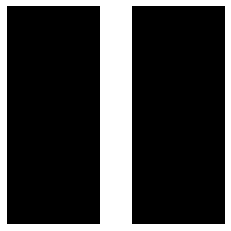

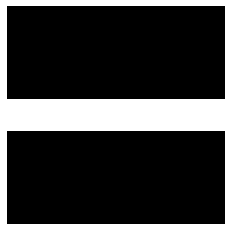

In [ ]:
fmap = np.zeros(shape=(7, 7, 1, 2), dtype=np.float32)
fmap[:, 3, 0, 0] = 1
fmap[3, :, 0, 1] = 1
plot_image(fmap[:, :, 0, 0])
plt.show()
plot_image(fmap[:, :, 0, 1])
plt.show()

Cria um grafo com entrada X mais uma camada convolucional aplicando os 2 filtros

 
*   X é o minilote de entrada (um tensor 4D);
*   filters é o conjunto de filtros a se aplicar (também um tensor 4D);
*   strides é um array 1D de quatro elementos nos quais os dois elementos centrais são os strides vertical e horizontal (sh e sw). O primeiro e o último elementos 
devem ser iguais a 1;
*   padding deve ser tanto “VALID” ou “SAME”:
 *  Se configurada para “VALID”, a camada convolucional não utiliza o zero padding 
e pode ignorar algumas linhas e colunas na parte inferior e direita da imagem 
de entrada, dependendo do incremento;
 *   Caso seja configurada para “SAME”, a camada convolucional utiliza o zero 
padding se necessário. Nesse caso, o número de neurônios de saída é igual 
ao número de neurônios de entrada dividido pelo stride, arredondado. Os zeros são adicionados em torno das entradas o 
mais uniformemente possível.



In [ ]:
reset_graph()

X = tf.placeholder(tf.float32, shape=(None, height, width, 1))
feature_maps = tf.constant(fmap)
convolution = tf.nn.conv2d(X, feature_maps, strides=[1,1,1,1], padding="SAME")

In [ ]:
with tf.Session() as sess:
    output = convolution.eval(feed_dict={X: images})

Saving figure china_original


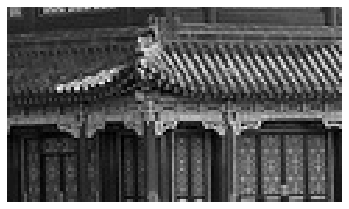

In [ ]:
plot_image(images[0, :, :, 0])
save_fig("china_original", tight_layout=False)
plt.show()

Saving figure china_vertical


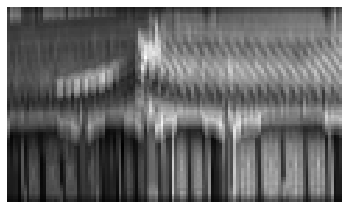

In [ ]:
plot_image(output[0, :, :, 0])
save_fig("china_vertical", tight_layout=False)
plt.show()

Saving figure china_horizontal


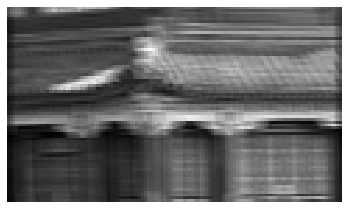

In [ ]:
plot_image(output[0, :, :, 1])
save_fig("china_horizontal", tight_layout=False)
plt.show()

### Simple example

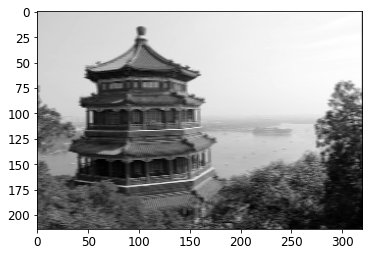

In [ ]:
import numpy as np
from sklearn.datasets import load_sample_images

# Load sample images
china = load_sample_image("china.jpg")
flower = load_sample_image("flower.jpg")
dataset = np.array([china, flower], dtype=np.float32)
batch_size, height, width, channels = dataset.shape

# Create 2 filters
filters = np.zeros(shape=(7, 7, channels, 2), dtype=np.float32)
filters[:, 3, :, 0] = 1  # vertical line
filters[3, :, :, 1] = 1  # horizontal line

# Create a graph with input X plus a convolutional layer applying the 2 filters
X = tf.placeholder(tf.float32, shape=(None, height, width, channels))
convolution = tf.nn.conv2d(X, filters, strides=[1,2,2,1], padding="SAME")

with tf.Session() as sess:
    output = sess.run(convolution, feed_dict={X: dataset})

plt.imshow(output[0, :, :, 1], cmap="gray") # plot 1st image's 2nd feature map
plt.show()

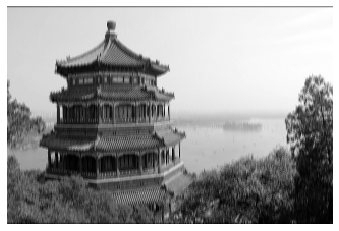

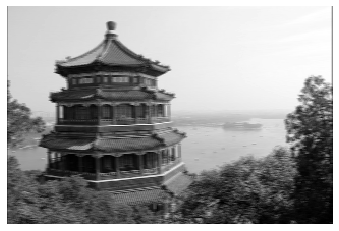

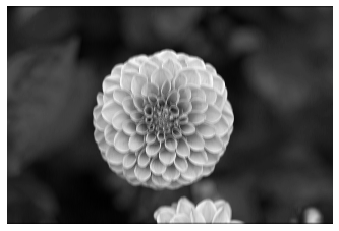

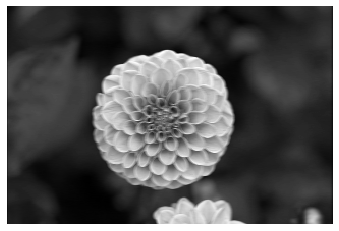

In [ ]:
for image_index in (0, 1):
    for feature_map_index in (0, 1):
        plot_image(output[image_index, :, :, feature_map_index])
        plt.show()

Usando `tf.layers.conv2d()`:

In [ ]:
reset_graph()

X = tf.placeholder(shape=(None, height, width, channels), dtype=tf.float32)
conv = tf.layers.conv2d(X, filters=2, kernel_size=7, strides=[2,2],
                        padding="SAME")

Instructions for updating:
Use `tf.keras.layers.Conv2D` instead.
Instructions for updating:
Please use `layer.__call__` method instead.


In [ ]:
init = tf.global_variables_initializer()

with tf.Session() as sess:
    init.run()
    output = sess.run(conv, feed_dict={X: dataset})

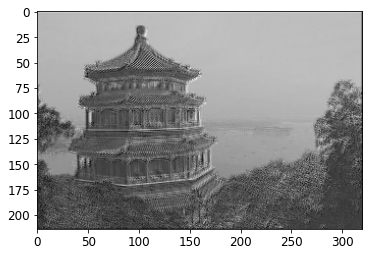

In [ ]:
plt.imshow(output[0, :, :, 1], cmap="gray") # plot 1st image's 2nd feature map
plt.show()

### VALID vs SAME padding

In [ ]:
reset_graph()

filter_primes = np.array([2., 3., 5., 7., 11., 13.], dtype=np.float32)
x = tf.constant(np.arange(1, 13+1, dtype=np.float32).reshape([1, 1, 13, 1]))
filters = tf.constant(filter_primes.reshape(1, 6, 1, 1))

valid_conv = tf.nn.conv2d(x, filters, strides=[1, 1, 5, 1], padding='VALID')
same_conv = tf.nn.conv2d(x, filters, strides=[1, 1, 5, 1], padding='SAME')

with tf.Session() as sess:
    print("VALID:\n", valid_conv.eval())
    print("SAME:\n", same_conv.eval())

VALID:
 [[[[184.]
   [389.]]]]
SAME:
 [[[[143.]
   [348.]
   [204.]]]]


In [ ]:
print("VALID:")
print(np.array([1,2,3,4,5,6]).T.dot(filter_primes))
print(np.array([6,7,8,9,10,11]).T.dot(filter_primes))
print("SAME:")
print(np.array([0,1,2,3,4,5]).T.dot(filter_primes))
print(np.array([5,6,7,8,9,10]).T.dot(filter_primes))
print(np.array([10,11,12,13,0,0]).T.dot(filter_primes))


VALID:
184.0
389.0
SAME:
143.0
348.0
204.0


## Camada Pooling

In [ ]:
batch_size, height, width, channels = dataset.shape

filters = np.zeros(shape=(7, 7, channels, 2), dtype=np.float32)
filters[:, 3, :, 0] = 1  # vertical line
filters[3, :, :, 1] = 1  # horizontal line

O argumento ksize contém o formato do kernel ao longo de todas as quatro dimensões 
do tensor de entrada: [batch size, height, width, channels].

Para criar uma camada average pooling, utilize a função `avg_pool()` em vez da `max_pool()`

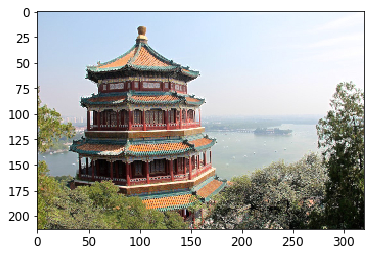

In [ ]:
X = tf.placeholder(tf.float32, shape=(None, height, width, channels))
max_pool = tf.nn.max_pool(X, ksize=[1,2,2,1], strides=[1,2,2,1],padding="VALID")

with tf.Session() as sess:
    output = sess.run(max_pool, feed_dict={X: dataset})

plt.imshow(output[0].astype(np.uint8))  # plot the output for the 1st image
plt.show()

Saving figure china_original


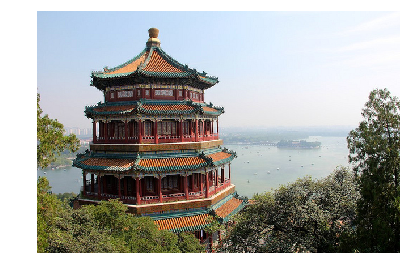

Saving figure china_max_pool


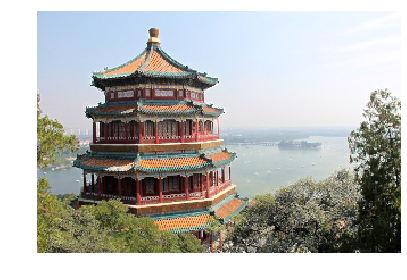

In [ ]:
plot_color_image(dataset[0])
save_fig("china_original")
plt.show()
    
plot_color_image(output[0])
save_fig("china_max_pool")
plt.show()

## MNIST

Nota: em vez de usar as funções full_connected(), conv2d() e dropout() do módulo tensorflow.contrib.layers (como no livro), agora usamos as funções densa(), conv2d() e dropout() ( respectivamente) do módulo tf.layers, que não existia quando este capítulo foi escrito. Isso é preferível porque qualquer coisa em contrib pode ser alterada ou excluída sem aviso prévio, enquanto tf.layers faz parte da API oficial. Como você verá, o código é basicamente o mesmo.


Para todas essas funções:
* o parâmetro `scope` foi renomeado para `name`, e o sufixo `_fn` foi removido em todos os parâmetros que o possuíam (por exemplo, o parâmetro `activation_fn` foi renomeado para `activation`).

As outras diferenças principais em `tf.layers.dense()` são:
* o parâmetro `weights` foi renomeado para `kernel` (e a variável weights agora é denominada `"kernel"` em vez de `"weights"`),
* a ativação padrão é `None` em vez de `tf.nn.relu`

As outras diferenças principais em `tf.layers.conv2d()` são:
* o parâmetro `num_outputs` foi renomeado para `filters`,
* o parâmetro `stride` foi renomeado para `stride`,
* o padrão `activation` agora é `None` em vez de `tf.nn.relu`.

As outras diferenças principais em `tf.layers.dropout()` são:
* leva a taxa de abandono (`rate`) em vez da probabilidade de manutenção (`keep_prob`). Claro, `rate == 1 - keep_prob`,
* os parâmetros `is_training` foram renomeados para `training`.

In [ ]:
height = 28
width = 28
channels = 1
n_inputs = height * width

conv1_fmaps = 32
conv1_ksize = 3
conv1_stride = 1
conv1_pad = "SAME"

conv2_fmaps = 64
conv2_ksize = 3
conv2_stride = 2
conv2_pad = "SAME"

pool3_fmaps = conv2_fmaps

n_fc1 = 64
n_outputs = 10

reset_graph()

with tf.name_scope("inputs"):
    X = tf.placeholder(tf.float32, shape=[None, n_inputs], name="X")
    X_reshaped = tf.reshape(X, shape=[-1, height, width, channels])
    y = tf.placeholder(tf.int32, shape=[None], name="y")

conv1 = tf.layers.conv2d(X_reshaped, filters=conv1_fmaps, kernel_size=conv1_ksize,
                         strides=conv1_stride, padding=conv1_pad,
                         activation=tf.nn.relu, name="conv1")
conv2 = tf.layers.conv2d(conv1, filters=conv2_fmaps, kernel_size=conv2_ksize,
                         strides=conv2_stride, padding=conv2_pad,
                         activation=tf.nn.relu, name="conv2")

with tf.name_scope("pool3"):
    pool3 = tf.nn.max_pool(conv2, ksize=[1, 2, 2, 1], strides=[1, 2, 2, 1], padding="VALID")
    pool3_flat = tf.reshape(pool3, shape=[-1, pool3_fmaps * 7 * 7])

with tf.name_scope("fc1"):
    fc1 = tf.layers.dense(pool3_flat, n_fc1, activation=tf.nn.relu, name="fc1")

with tf.name_scope("output"):
    logits = tf.layers.dense(fc1, n_outputs, name="output")
    Y_proba = tf.nn.softmax(logits, name="Y_proba")

with tf.name_scope("train"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(logits=logits, labels=y)
    loss = tf.reduce_mean(xentropy)
    optimizer = tf.train.AdamOptimizer()
    training_op = optimizer.minimize(loss)

with tf.name_scope("eval"):
    correct = tf.nn.in_top_k(logits, y, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))

with tf.name_scope("init_and_save"):
    init = tf.global_variables_initializer()
    saver = tf.train.Saver()

**Warning**: `tf.examples.tutorials.mnist` is deprecated. We will use `tf.keras.datasets.mnist` instead.

In [ ]:
(X_train, y_train), (X_test, y_test) = tf.keras.datasets.mnist.load_data()
X_train = X_train.astype(np.float32).reshape(-1, 28*28) / 255.0
X_test = X_test.astype(np.float32).reshape(-1, 28*28) / 255.0
y_train = y_train.astype(np.int32)
y_test = y_test.astype(np.int32)
X_valid, X_train = X_train[:5000], X_train[5000:]
y_valid, y_train = y_train[:5000], y_train[5000:]

In [ ]:
def shuffle_batch(X, y, batch_size):
    rnd_idx = np.random.permutation(len(X))
    n_batches = len(X) // batch_size
    for batch_idx in np.array_split(rnd_idx, n_batches):
        X_batch, y_batch = X[batch_idx], y[batch_idx]
        yield X_batch, y_batch

In [ ]:
n_epochs = 10
batch_size = 100

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        acc_batch = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        acc_test = accuracy.eval(feed_dict={X: X_test, y: y_test})
        print(epoch, "Last batch accuracy:", acc_batch, "Test accuracy:", acc_test)

        save_path = saver.save(sess, "./my_mnist_model")

0 Last batch accuracy: 0.99 Test accuracy: 0.9775
1 Last batch accuracy: 0.98 Test accuracy: 0.9841
2 Last batch accuracy: 0.98 Test accuracy: 0.979
3 Last batch accuracy: 0.99 Test accuracy: 0.9886
4 Last batch accuracy: 0.99 Test accuracy: 0.9883
5 Last batch accuracy: 1.0 Test accuracy: 0.9892
6 Last batch accuracy: 0.99 Test accuracy: 0.9891
7 Last batch accuracy: 1.0 Test accuracy: 0.9899
8 Last batch accuracy: 1.0 Test accuracy: 0.9871
9 Last batch accuracy: 1.0 Test accuracy: 0.989


#Capítulo 14 

Redes Neurais Recorrentes (RNN)

## Setup

First, let's make sure this notebook works well in both python 2 and 3, import a few common modules, ensure MatplotLib plots figures inline and prepare a function to save the figures:

In [ ]:
# To support both python 2 and python 3
from __future__ import division, print_function, unicode_literals

# Common imports
import numpy as np
import os

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 1.x
except Exception:
    pass

# to make this notebook's output stable across runs
def reset_graph(seed=42):
    tf.reset_default_graph()
    tf.set_random_seed(seed)
    np.random.seed(seed)

# To plot pretty figures
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "rnn"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

TensorFlow 1.x selected.


Then of course we will need TensorFlow:

In [ ]:
import tensorflow as tf

## RNNs Básicas no TensorFlow

### Manual RNN

 RNN composta por uma camada com cinco neurônios recorrentes.

In [ ]:
reset_graph()

n_inputs = 3
n_neurons = 5

X0 = tf.placeholder(tf.float32, [None, n_inputs])
X1 = tf.placeholder(tf.float32, [None, n_inputs])

Wx = tf.Variable(tf.random_normal(shape=[n_inputs, n_neurons],dtype=tf.float32))
Wy = tf.Variable(tf.random_normal(shape=[n_neurons,n_neurons],dtype=tf.float32))
b = tf.Variable(tf.zeros([1, n_neurons], dtype=tf.float32))

Y0 = tf.tanh(tf.matmul(X0, Wx) + b)
Y1 = tf.tanh(tf.matmul(Y0, Wy) + tf.matmul(X1, Wx) + b)

init = tf.global_variables_initializer()

Os mesmos pesos e termos de polarização são compartilhados por ambas as camadas e, segundo, alimentamos entradas em cada camada 
e obtemos saídas de cada camada.


Este minilote contém quatro instâncias, cada uma com uma sequência de entrada 
composta de exatamente duas entradas. Ao final, *Y0_val* e *Y1_val* conterá as saídas da 
rede em ambos os intervalos para todos os neurônios e todas as instâncias no minilote:

In [ ]:
import numpy as np

X0_batch = np.array([[0, 1, 2], [3, 4, 5], [6, 7, 8], [9, 0, 1]]) # t = 0
X1_batch = np.array([[9, 8, 7], [0, 0, 0], [6, 5, 4], [3, 2, 1]]) # t = 1

with tf.Session() as sess:
    init.run()
    Y0_val, Y1_val = sess.run([Y0, Y1], feed_dict={X0: X0_batch, X1: X1_batch})

In [ ]:
print(Y0_val)

[[-0.0664006   0.9625767   0.68105793  0.7091854  -0.898216  ]
 [ 0.9977755  -0.71978897 -0.9965762   0.9673924  -0.9998972 ]
 [ 0.99999785 -0.99898815 -0.9999989   0.9967762  -0.9999998 ]
 [ 1.         -1.         -1.         -0.9981893   0.9995087 ]]


In [ ]:
print(Y1_val)

[[ 1.         -1.         -1.          0.40200275 -0.9999998 ]
 [-0.12210425  0.6280529   0.9671843  -0.9937122  -0.25839356]
 [ 0.9999982  -0.9999994  -0.9999975  -0.85943305 -0.9999879 ]
 [ 0.99928284 -0.99999803 -0.9999058   0.98579615 -0.9220575 ]]


### Using `static_rnn()`


**Observação**: `tf.contrib.rnn` foi parcialmente movido para a API principal no TensorFlow 1.2. A maioria das classes `*Cell` e `*Wrapper` estão agora disponíveis em `tf.nn.rnn_cell`, e a função `tf.contrib.rnn.static_rnn()` está disponível como `tf.nn.static_rnn() `.

In [ ]:
n_inputs = 3
n_neurons = 5

In [ ]:
reset_graph()

X0 = tf.placeholder(tf.float32, [None, n_inputs])
X1 = tf.placeholder(tf.float32, [None, n_inputs])

basic_cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)
output_seqs, states = tf.nn.static_rnn(basic_cell, [X0, X1],
                                       dtype=tf.float32)
Y0, Y1 = output_seqs

Instructions for updating:
This class is equivalent as tf.keras.layers.SimpleRNNCell, and will be replaced by that in Tensorflow 2.0.
Instructions for updating:
Please use `keras.layers.RNN(cell, unroll=True)`, which is equivalent to this API
Instructions for updating:
Please use `layer.add_weight` method instead.
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


In [ ]:
init = tf.global_variables_initializer()

In [ ]:
X0_batch = np.array([[0, 1, 2], [3, 4, 5], [6, 7, 8], [9, 0, 1]])
X1_batch = np.array([[9, 8, 7], [0, 0, 0], [6, 5, 4], [3, 2, 1]])

with tf.Session() as sess:
    init.run()
    Y0_val, Y1_val = sess.run([Y0, Y1], feed_dict={X0: X0_batch, X1: X1_batch})

In [ ]:
Y0_val

array([[ 0.30741334, -0.32884315, -0.65428466, -0.9385059 ,  0.52089024],
       [ 0.99122757, -0.95425403, -0.75180787, -0.9995208 ,  0.9820235 ],
       [ 0.9999268 , -0.99783254, -0.8247353 , -0.9999963 ,  0.9994779 ],
       [ 0.996771  , -0.68750614,  0.8419969 ,  0.93039113,  0.81206834]],
      dtype=float32)

In [ ]:
Y1_val

array([[ 0.999989  , -0.99976057, -0.06679279, -0.9999803 ,  0.99982214],
       [-0.6524943 , -0.51520866, -0.37968948, -0.59225935, -0.08968402],
       [ 0.99862397, -0.99715203, -0.03308637, -0.9991566 ,  0.9932902 ],
       [ 0.99681675, -0.9598194 ,  0.3966063 , -0.83076054,  0.7967197 ]],
      dtype=float32)

In [ ]:
from datetime import datetime

root_logdir = os.path.join(os.curdir, "tf_logs")

def make_log_subdir(run_id=None):
    if run_id is None:
        run_id = datetime.utcnow().strftime("%Y%m%d%H%M%S")
    return "{}/run-{}/".format(root_logdir, run_id)

def save_graph(graph=None, run_id=None):
    if graph is None:
        graph = tf.get_default_graph()
    logdir = make_log_subdir(run_id)
    file_writer = tf.summary.FileWriter(logdir, graph=graph)
    file_writer.close()
    return logdir

In [ ]:
save_graph()

'./tf_logs/run-20220407173030/'

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir {root_logdir}

### Packing sequences

In [ ]:
n_steps = 2
n_inputs = 3
n_neurons = 5

A função `static_rnn()` cria uma rede RNN desenrolada encadeando células.

Como antes, primeiro criamos os placeholders de entrada. Em seguida, criamos uma 
BasicRNNCell, é como uma fábrica que cria cópias da célula 
para construir a RNN desenrolada (uma para cada intervalo de tempo). Em seguida, 
chamamos a `static_rnn()`, dando-lhe a fábrica de células e os tensores de entrada e 
informando o tipo de dados das entradas (isso é usado para criar a matriz de estado 
inicial, que por padrão é cheia de zeros).


A função `static_rnn()` chama a função `call()` 
da fábrica de células uma vez por entrada e as encadeia como fizemos anteriormente, 
criando duas cópias da célula (cada uma contendo uma camada de cinco neurônios recorrentes) com pesos e termos de polarização compartilhados. 


A função `static_rnn() `
retorna dois objetos. O primeiro é uma lista do Python que contém os tensores de saída 
para cada intervalo de tempo e o segundo é um tensor que contém os estados finais da 
rede. Quando você utiliza células básicas, o estado final é simplesmente igual ao último 
resultado.

O código a seguir cria a mesma RNN novamente, mas, dessa vez, é necessário um único placeholder 
para entrada no formato [None, n_steps, n_inputs] sendo que a primeira dimensão 
é o tamanho do minilote. 


Em seguida, extrai a lista de sequências de entrada para cada 
intervalo de tempo. X_seqs é uma lista Python de tensores n_steps no formato [None, 
n_inputs] e, mais uma vez, a primeira dimensão é do tamanho do minilote. Para fazer 
isto, primeiro trocamos as duas primeiras dimensões usando a função `transpose()` para 
que os intervalos de tempo sejam agora a primeira dimensão. Em seguida, extraímos 
uma lista de tensores Python na primeira dimensão (ou seja, um tensor por intervalo de 
tempo) usando a função `unstack()`. 


As próximas duas linhas são as mesmas de antes. 
Finalmente, mesclamos todos os tensores de saída usando a função `stack()` e trocamos 
as primeiras duas dimensões para obter um tensor outputs final no formato [None, 
n_steps, n_neurons] (de novo, a primeira dimensão é do tamanho de um minilote).

In [ ]:
reset_graph()

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
X_seqs = tf.unstack(tf.transpose(X, perm=[1, 0, 2]))

basic_cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)
output_seqs, states = tf.nn.static_rnn(basic_cell, X_seqs,
                                       dtype=tf.float32)
outputs = tf.transpose(tf.stack(output_seqs), perm=[1, 0, 2])

In [ ]:
init = tf.global_variables_initializer()

Agora podemos rodar a rede alimentando-a com um único tensor que contém todas as 
sequências do minilote:

In [ ]:
X_batch = np.array([
        # t = 0      t = 1 
        [[0, 1, 2], [9, 8, 7]], # instance 1
        [[3, 4, 5], [0, 0, 0]], # instance 2
        [[6, 7, 8], [6, 5, 4]], # instance 3
        [[9, 0, 1], [3, 2, 1]], # instance 4
    ])

with tf.Session() as sess:
    init.run()
    outputs_val = outputs.eval(feed_dict={X: X_batch})

E obtemos um único tensor outputs_val para todas as instâncias, todos os intervalos 
de tempo e todos os neurônios:

In [ ]:
print(outputs_val)

[[[-0.45652324 -0.68064123  0.40938237  0.63104504 -0.45732826]
  [-0.94288    -0.9998869   0.9405581   0.9999985  -0.99999976]]

 [[-0.80015343 -0.9921827   0.78177965  0.9971032  -0.9964609 ]
  [-0.637116    0.11300926  0.5798437   0.4310559  -0.6371699 ]]

 [[-0.93605185 -0.9998379   0.9308867   0.9999814  -0.9999831 ]
  [-0.9165386  -0.9945605   0.896054    0.99987185 -0.999975  ]]

 [[ 0.9927367  -0.9981933  -0.55543643  0.9989031  -0.9953323 ]
  [-0.02746338 -0.73191977  0.7827872   0.9525681  -0.978177  ]]]


In [ ]:
print(np.transpose(outputs_val, axes=[1, 0, 2])[1])

[[-0.94288    -0.9998869   0.9405581   0.9999985  -0.99999976]
 [-0.637116    0.11300926  0.5798437   0.4310559  -0.6371699 ]
 [-0.9165386  -0.9945605   0.896054    0.99987185 -0.999975  ]
 [-0.02746338 -0.73191977  0.7827872   0.9525681  -0.978177  ]]


### Using `dynamic_rnn()`

In [ ]:
n_steps = 2
n_inputs = 3
n_neurons = 5

A função `dynamic_rnn()` utiliza uma operação `while_loop()` para executar o número 
apropriado de vezes na célula, e você pode definir a *swap_memory=True* se quiser que ela 
troque a memória GPU para a memória CPU durante a retropropagação a fim de evitar 
erros do tipo OOM.

In [ ]:
reset_graph()

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])

basic_cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)
outputs, states = tf.nn.dynamic_rnn(basic_cell, X, dtype=tf.float32)

Instructions for updating:
Please use `keras.layers.RNN(cell)`, which is equivalent to this API


In [ ]:
init = tf.global_variables_initializer()

In [ ]:
X_batch = np.array([
        [[0, 1, 2], [9, 8, 7]], # instance 1
        [[3, 4, 5], [0, 0, 0]], # instance 2
        [[6, 7, 8], [6, 5, 4]], # instance 3
        [[9, 0, 1], [3, 2, 1]], # instance 4
    ])

with tf.Session() as sess:
    init.run()
    outputs_val = outputs.eval(feed_dict={X: X_batch})

In [ ]:
print(outputs_val)

[[[-0.85115266  0.87358344  0.5802911   0.8954789  -0.0557505 ]
  [-0.9999959   0.9999958   0.9981815   1.          0.37679607]]

 [[-0.9983293   0.9992038   0.98071444  0.999985    0.25192663]
  [-0.7081804  -0.07723374 -0.85227895  0.5845349  -0.7878095 ]]

 [[-0.9999826   0.99999535  0.9992863   1.          0.5159072 ]
  [-0.99939567  0.99840957  0.83422637  0.99999976 -0.47325206]]

 [[ 0.8788859   0.07356028  0.97216916  0.9998546  -0.7351168 ]
  [-0.9134514   0.36009565  0.7624866   0.99817705  0.80142003]]]


In [ ]:
save_graph()

'./tf_logs/run-20220407173111/'

In [ ]:
%tensorboard --logdir {root_logdir}

Reusing TensorBoard on port 6006 (pid 135), started 0:00:36 ago. (Use '!kill 135' to kill it.)

## Manipulando Sequências de Entrada de Comprimento Variável

Agora, a RNN produz vetores zero para cada vez que ultrapassa o comprimento da 
sequência:

In [ ]:
n_steps = 2
n_inputs = 3
n_neurons = 5

reset_graph()

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
basic_cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)

In [ ]:
seq_length = tf.placeholder(tf.int32, [None])
outputs, states = tf.nn.dynamic_rnn(basic_cell, X, dtype=tf.float32,
                                    sequence_length=seq_length)

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


In [ ]:
init = tf.global_variables_initializer()

In [ ]:
X_batch = np.array([
        # step 0     step 1
        [[0, 1, 2], [9, 8, 7]], # instance 1
        [[3, 4, 5], [0, 0, 0]], # instance 2 (padded with zero vectors)
        [[6, 7, 8], [6, 5, 4]], # instance 3
        [[9, 0, 1], [3, 2, 1]], # instance 4
    ])
seq_length_batch = np.array([2, 1, 2, 2])

In [ ]:
with tf.Session() as sess:
    init.run()
    outputs_val, states_val = sess.run(
        [outputs, states], feed_dict={X: X_batch, seq_length: seq_length_batch})

In [ ]:
print(outputs_val)

[[[-0.9123188   0.16516446  0.5548655  -0.39159346  0.20846416]
  [-1.          0.9567259   0.9983169   0.99970174  0.9651857 ]]

 [[-0.9998612   0.670229    0.9723653   0.6631046   0.74457586]
  [ 0.          0.          0.          0.          0.        ]]

 [[-0.9999998   0.8967998   0.9986295   0.9647514   0.93661994]
  [-0.9999526   0.96819544  0.96002865  0.98706263  0.85459226]]

 [[-0.96435434  0.995016   -0.36150697  0.9983377   0.99949706]
  [-0.96135855  0.9568762   0.7132288   0.97729224 -0.0958299 ]]]


In [ ]:
print(states_val)

[[-1.          0.9567259   0.9983169   0.99970174  0.9651857 ]
 [-0.9998612   0.670229    0.9723653   0.6631046   0.74457586]
 [-0.9999526   0.96819544  0.96002865  0.98706263  0.85459226]
 [-0.96135855  0.9568762   0.7132288   0.97729224 -0.0958299 ]]


## Treinando um classificador de sequência

Nota: o livro usa `tensorflow.contrib.layers.fully_connected()` em vez de `tf.layers.dense()` (que não existia quando este capítulo foi escrito). Agora é preferível usar `tf.layers.dense()`, porque qualquer coisa no módulo contrib pode ser alterada ou excluída sem aviso prévio. A função `dense()` é quase idêntica à função `full_connected()`. As principais diferenças relevantes para este capítulo são:

* vários parâmetros são renomeados: `scope` torna-se `name`, `activation_fn` torna-se `activation` (e similarmente o sufixo `_fn` é removido de outros parâmetros como `normalizer_fn`), `weights_initializer` torna-se `kernel_initializer` , etc .
* o padrão `activation` agora é `None` em vez de `tf.nn.relu`.

A fase de construção é bastante simples, é praticamente a mesma do classificador MNIST 
que criamos no Capítulo 10, exceto que uma RNN desenrolada substitui as camadas ocultas. 
Observe que a camada totalmente conectada está conectada ao tensor de estados que contém 
apenas o estado final da RNN (ou seja, a saída 28). Observe também que y é um placeholder
para as classes-alvo:

In [ ]:
reset_graph()

n_steps = 28
n_inputs = 28
n_neurons = 150
n_outputs = 10

learning_rate = 0.001

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
y = tf.placeholder(tf.int32, [None])

basic_cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)
outputs, states = tf.nn.dynamic_rnn(basic_cell, X, dtype=tf.float32)

logits = tf.layers.dense(states, n_outputs)
xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y,
                                                          logits=logits)
loss = tf.reduce_mean(xentropy)
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)
correct = tf.nn.in_top_k(logits, y, 1)
accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))

init = tf.global_variables_initializer()

Instructions for updating:
Use keras.layers.Dense instead.
Instructions for updating:
Please use `layer.__call__` method instead.


**Warning**: `tf.examples.tutorials.mnist` is deprecated. We will use `tf.keras.datasets.mnist` instead.

In [ ]:
(X_train, y_train), (X_test, y_test) = tf.keras.datasets.mnist.load_data()
X_train = X_train.astype(np.float32).reshape(-1, 28*28) / 255.0
X_test = X_test.astype(np.float32).reshape(-1, 28*28) / 255.0
y_train = y_train.astype(np.int32)
y_test = y_test.astype(np.int32)
X_valid, X_train = X_train[:5000], X_train[5000:]
y_valid, y_train = y_train[:5000], y_train[5000:]

11493376/11490434 [==============================] - 0s 0us/step


In [ ]:
def shuffle_batch(X, y, batch_size):
    rnd_idx = np.random.permutation(len(X))
    n_batches = len(X) // batch_size
    for batch_idx in np.array_split(rnd_idx, n_batches):
        X_batch, y_batch = X[batch_idx], y[batch_idx]
        yield X_batch, y_batch

In [ ]:
X_test = X_test.reshape((-1, n_steps, n_inputs))

In [ ]:
n_epochs = 100
batch_size = 150

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            X_batch = X_batch.reshape((-1, n_steps, n_inputs))
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        acc_batch = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        acc_test = accuracy.eval(feed_dict={X: X_test, y: y_test})
        print(epoch, "Last batch accuracy:", acc_batch, "Test accuracy:", acc_test)

0 Last batch accuracy: 0.9533333 Test accuracy: 0.9288
1 Last batch accuracy: 0.96 Test accuracy: 0.9471
2 Last batch accuracy: 0.96 Test accuracy: 0.9498
3 Last batch accuracy: 0.96 Test accuracy: 0.9656
4 Last batch accuracy: 0.98 Test accuracy: 0.9649
5 Last batch accuracy: 0.9266667 Test accuracy: 0.9635
6 Last batch accuracy: 0.97333336 Test accuracy: 0.9494
7 Last batch accuracy: 0.96666664 Test accuracy: 0.9703
8 Last batch accuracy: 0.9866667 Test accuracy: 0.9679
9 Last batch accuracy: 0.99333334 Test accuracy: 0.9728
10 Last batch accuracy: 0.99333334 Test accuracy: 0.9757
11 Last batch accuracy: 0.99333334 Test accuracy: 0.9774
12 Last batch accuracy: 0.94666666 Test accuracy: 0.965
13 Last batch accuracy: 0.9866667 Test accuracy: 0.9748
14 Last batch accuracy: 0.98 Test accuracy: 0.9775
15 Last batch accuracy: 0.97333336 Test accuracy: 0.9686
16 Last batch accuracy: 1.0 Test accuracy: 0.9764
17 Last batch accuracy: 0.99333334 Test accuracy: 0.969
18 Last batch accuracy: 0.9

## Multi-layer RNN

Primeiro, criaremos a RNN, que conterá 100 neurônios recorrentes e a desenrolaremos 
em 28 intervalos de tempo, já que cada instância de treinamento terá 20 entradas. Cada 
entrada conterá apenas uma característica (o valor naquele momento). Os alvos são 
também sequências de 28 entradas, cada uma contendo um único valor. O código é 
quase o mesmo de antes:

In [ ]:
reset_graph()

n_steps = 28
n_inputs = 28
n_outputs = 10

learning_rate = 0.001

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
y = tf.placeholder(tf.int32, [None])

In [ ]:
n_neurons = 100
n_layers = 3

layers = [tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons,
                                      activation=tf.nn.relu)
          for layer in range(n_layers)]
multi_layer_cell = tf.nn.rnn_cell.MultiRNNCell(layers)
outputs, states = tf.nn.dynamic_rnn(multi_layer_cell, X, dtype=tf.float32)

Instructions for updating:
This class is equivalent as tf.keras.layers.StackedRNNCells, and will be replaced by that in Tensorflow 2.0.


In [ ]:
states_concat = tf.concat(axis=1, values=states)
logits = tf.layers.dense(states_concat, n_outputs)
xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
loss = tf.reduce_mean(xentropy)
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)
correct = tf.nn.in_top_k(logits, y, 1)
accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))

init = tf.global_variables_initializer()

In [ ]:
n_epochs = 10
batch_size = 150

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            X_batch = X_batch.reshape((-1, n_steps, n_inputs))
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        acc_batch = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        acc_test = accuracy.eval(feed_dict={X: X_test, y: y_test})
        print(epoch, "Last batch accuracy:", acc_batch, "Test accuracy:", acc_test)

0 Last batch accuracy: 0.94 Test accuracy: 0.9247
1 Last batch accuracy: 0.96666664 Test accuracy: 0.9622
2 Last batch accuracy: 0.96666664 Test accuracy: 0.965
3 Last batch accuracy: 0.99333334 Test accuracy: 0.9749
4 Last batch accuracy: 0.98 Test accuracy: 0.9738
5 Last batch accuracy: 0.9533333 Test accuracy: 0.974
6 Last batch accuracy: 0.9866667 Test accuracy: 0.9785
7 Last batch accuracy: 0.97333336 Test accuracy: 0.9813
8 Last batch accuracy: 1.0 Test accuracy: 0.9776
9 Last batch accuracy: 0.9866667 Test accuracy: 0.9782


## Time series

In [ ]:
t_min, t_max = 0, 30
resolution = 0.1

def time_series(t):
    return t * np.sin(t) / 3 + 2 * np.sin(t*5)

def next_batch(batch_size, n_steps):
    t0 = np.random.rand(batch_size, 1) * (t_max - t_min - n_steps * resolution)
    Ts = t0 + np.arange(0., n_steps + 1) * resolution
    ys = time_series(Ts)
    return ys[:, :-1].reshape(-1, n_steps, 1), ys[:, 1:].reshape(-1, n_steps, 1)

Saving figure time_series_plot


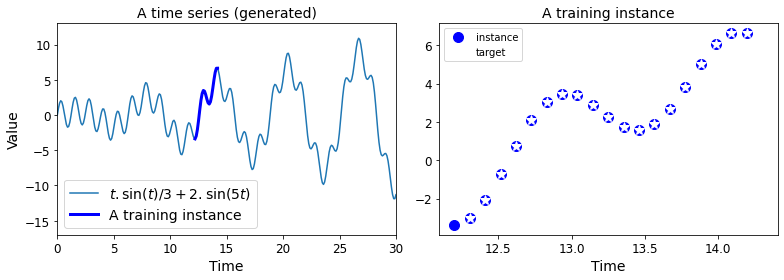

In [ ]:
t = np.linspace(t_min, t_max, int((t_max - t_min) / resolution))

n_steps = 20
t_instance = np.linspace(12.2, 12.2 + resolution * (n_steps + 1), n_steps + 1)

plt.figure(figsize=(11,4))
plt.subplot(121)
plt.title("A time series (generated)", fontsize=14)
plt.plot(t, time_series(t), label=r"$t . \sin(t) / 3 + 2 . \sin(5t)$")
plt.plot(t_instance[:-1], time_series(t_instance[:-1]), "b-", linewidth=3, label="A training instance")
plt.legend(loc="lower left", fontsize=14)
plt.axis([0, 30, -17, 13])
plt.xlabel("Time")
plt.ylabel("Value")

plt.subplot(122)
plt.title("A training instance", fontsize=14)
plt.plot(t_instance[:-1], time_series(t_instance[:-1]), "bo", markersize=10, label="instance")
plt.plot(t_instance[1:], time_series(t_instance[1:]), "w*", markersize=10, label="target")
plt.legend(loc="upper left")
plt.xlabel("Time")


save_fig("time_series_plot")
plt.show()

In [ ]:
X_batch, y_batch = next_batch(1, n_steps)

In [ ]:
np.c_[X_batch[0], y_batch[0]]

array([[ 1.38452097,  2.05081182],
       [ 2.05081182,  2.29742291],
       [ 2.29742291,  2.0465599 ],
       [ 2.0465599 ,  1.34009916],
       [ 1.34009916,  0.32948704],
       [ 0.32948704, -0.76115235],
       [-0.76115235, -1.68967022],
       [-1.68967022, -2.25492776],
       [-2.25492776, -2.34576159],
       [-2.34576159, -1.96789418],
       [-1.96789418, -1.24220428],
       [-1.24220428, -0.37478448],
       [-0.37478448,  0.39387907],
       [ 0.39387907,  0.84815766],
       [ 0.84815766,  0.85045064],
       [ 0.85045064,  0.3752526 ],
       [ 0.3752526 , -0.48422846],
       [-0.48422846, -1.53852738],
       [-1.53852738, -2.54795941],
       [-2.54795941, -3.28097239]])

### Using an `OuputProjectionWrapper`




Vamos criar o RNN. Ele conterá 100 neurônios recorrentes e o desenrolaremos em 20 etapas de tempo, pois cada instância de treinamento terá 20 entradas. Cada entrada conterá apenas um recurso (o valor naquele momento). Os alvos também são sequências de 20 entradas, cada uma contendo um único valor:


In [ ]:
reset_graph()

n_steps = 20
n_inputs = 1
n_neurons = 100
n_outputs = 1

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
y = tf.placeholder(tf.float32, [None, n_steps, n_outputs])

cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons, activation=tf.nn.relu)
outputs, states = tf.nn.dynamic_rnn(cell, X, dtype=tf.float32)

A cada passo de tempo, agora temos um vetor de saída de tamanho 100. Mas o que realmente queremos é um único valor de saída em cada passo de tempo. A solução mais simples é envolver a célula em um `OutputProjectionWrapper`.


In [ ]:
reset_graph()

n_steps = 20
n_inputs = 1
n_neurons = 100
n_outputs = 1

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
y = tf.placeholder(tf.float32, [None, n_steps, n_outputs])

In [ ]:
cell = tf.contrib.rnn.OutputProjectionWrapper(
    tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons, activation=tf.nn.relu),
    output_size=n_outputs)

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



In [ ]:
outputs, states = tf.nn.dynamic_rnn(cell, X, dtype=tf.float32)

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


In [ ]:
learning_rate = 0.001

loss = tf.reduce_mean(tf.square(outputs - y)) # MSE
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()

In [ ]:
saver = tf.train.Saver()

In [ ]:
n_iterations = 1500
batch_size = 50

with tf.Session() as sess:
    init.run()
    for iteration in range(n_iterations):
        X_batch, y_batch = next_batch(batch_size, n_steps)
        sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        if iteration % 100 == 0:
            mse = loss.eval(feed_dict={X: X_batch, y: y_batch})
            print(iteration, "\tMSE:", mse)
    
    saver.save(sess, "./my_time_series_model") # not shown in the book

0 	MSE: 11.967254
100 	MSE: 0.52262706
200 	MSE: 0.15091658
300 	MSE: 0.07304221
400 	MSE: 0.06540783
500 	MSE: 0.06114641
600 	MSE: 0.05559596
700 	MSE: 0.048409674
800 	MSE: 0.050002623
900 	MSE: 0.047026325
1000 	MSE: 0.04690625
1100 	MSE: 0.048500296
1200 	MSE: 0.042432413
1300 	MSE: 0.04738324
1400 	MSE: 0.04172075


In [ ]:
with tf.Session() as sess:                          # not shown in the book
    saver.restore(sess, "./my_time_series_model")   # not shown

    X_new = time_series(np.array(t_instance[:-1].reshape(-1, n_steps, n_inputs)))
    y_pred = sess.run(outputs, feed_dict={X: X_new})

INFO:tensorflow:Restoring parameters from ./my_time_series_model


In [ ]:
y_pred

array([[[-3.4070497],
        [-2.4566221],
        [-1.1277736],
        [ 0.7955163],
        [ 2.1542785],
        [ 3.0847049],
        [ 3.4109173],
        [ 3.2879913],
        [ 2.874794 ],
        [ 2.2432363],
        [ 1.6264454],
        [ 1.4843462],
        [ 1.8751698],
        [ 2.6878204],
        [ 3.874992 ],
        [ 5.1104503],
        [ 6.1085806],
        [ 6.611841 ],
        [ 6.5759287],
        [ 6.0211473]]], dtype=float32)

Saving figure time_series_pred_plot


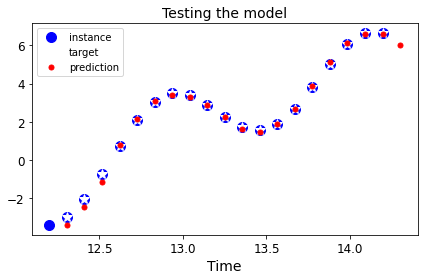

In [ ]:
plt.title("Testing the model", fontsize=14)
plt.plot(t_instance[:-1], time_series(t_instance[:-1]), "bo", markersize=10, label="instance")
plt.plot(t_instance[1:], time_series(t_instance[1:]), "w*", markersize=10, label="target")
plt.plot(t_instance[1:], y_pred[0,:,0], "r.", markersize=10, label="prediction")
plt.legend(loc="upper left")
plt.xlabel("Time")

save_fig("time_series_pred_plot")
plt.show()

### Without using an `OutputProjectionWrapper`

In [ ]:
reset_graph()

n_steps = 20
n_inputs = 1
n_neurons = 100

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
y = tf.placeholder(tf.float32, [None, n_steps, n_outputs])

In [ ]:
cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons, activation=tf.nn.relu)
rnn_outputs, states = tf.nn.dynamic_rnn(cell, X, dtype=tf.float32)

In [ ]:
n_outputs = 1
learning_rate = 0.001

In [ ]:
stacked_rnn_outputs = tf.reshape(rnn_outputs, [-1, n_neurons])
stacked_outputs = tf.layers.dense(stacked_rnn_outputs, n_outputs)
outputs = tf.reshape(stacked_outputs, [-1, n_steps, n_outputs])

In [ ]:
loss = tf.reduce_mean(tf.square(outputs - y))
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
n_iterations = 1500
batch_size = 50

with tf.Session() as sess:
    init.run()
    for iteration in range(n_iterations):
        X_batch, y_batch = next_batch(batch_size, n_steps)
        sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        if iteration % 100 == 0:
            mse = loss.eval(feed_dict={X: X_batch, y: y_batch})
            print(iteration, "\tMSE:", mse)
    
    X_new = time_series(np.array(t_instance[:-1].reshape(-1, n_steps, n_inputs)))
    y_pred = sess.run(outputs, feed_dict={X: X_new})
    
    saver.save(sess, "./my_time_series_model")

0 	MSE: 13.907029
100 	MSE: 0.5059415
200 	MSE: 0.1965846
300 	MSE: 0.101318896
400 	MSE: 0.0681408
500 	MSE: 0.06261934
600 	MSE: 0.0561679
700 	MSE: 0.04952694
800 	MSE: 0.050325118
900 	MSE: 0.048306838
1000 	MSE: 0.04790802
1100 	MSE: 0.049596015
1200 	MSE: 0.041353695
1300 	MSE: 0.050212566
1400 	MSE: 0.044630058


In [ ]:
y_pred

array([[[-3.4336784],
        [-2.449793 ],
        [-1.0974978],
        [ 0.6552456],
        [ 2.1511118],
        [ 3.117295 ],
        [ 3.519666 ],
        [ 3.3218045],
        [ 2.8050797],
        [ 2.195936 ],
        [ 1.7055851],
        [ 1.5712751],
        [ 1.90782  ],
        [ 2.7199807],
        [ 3.884405 ],
        [ 5.1232824],
        [ 6.115179 ],
        [ 6.658629 ],
        [ 6.6256514],
        [ 6.0401845]]], dtype=float32)

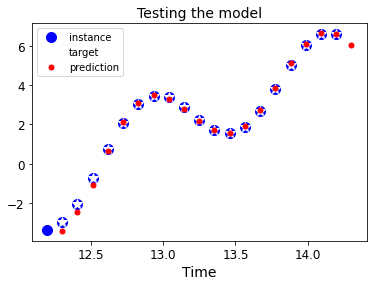

In [ ]:
plt.title("Testing the model", fontsize=14)
plt.plot(t_instance[:-1], time_series(t_instance[:-1]), "bo", markersize=10, label="instance")
plt.plot(t_instance[1:], time_series(t_instance[1:]), "w*", markersize=10, label="target")
plt.plot(t_instance[1:], y_pred[0,:,0], "r.", markersize=10, label="prediction")
plt.legend(loc="upper left")
plt.xlabel("Time")

plt.show()

### Generating a creative new sequence

In [ ]:
with tf.Session() as sess:                        # not shown in the book
    saver.restore(sess, "./my_time_series_model") # not shown

    sequence = [0.] * n_steps
    for iteration in range(300):
        X_batch = np.array(sequence[-n_steps:]).reshape(1, n_steps, 1)
        y_pred = sess.run(outputs, feed_dict={X: X_batch})
        sequence.append(y_pred[0, -1, 0])

INFO:tensorflow:Restoring parameters from ./my_time_series_model


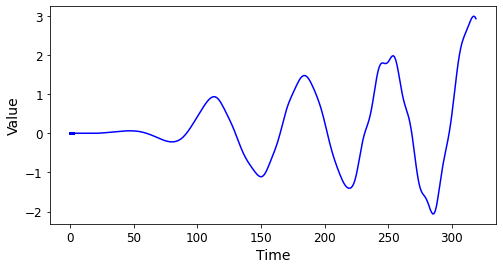

In [ ]:
plt.figure(figsize=(8,4))
plt.plot(np.arange(len(sequence)), sequence, "b-")
plt.plot(t[:n_steps], sequence[:n_steps], "b-", linewidth=3)
plt.xlabel("Time")
plt.ylabel("Value")
plt.show()

INFO:tensorflow:Restoring parameters from ./my_time_series_model
Saving figure creative_sequence_plot


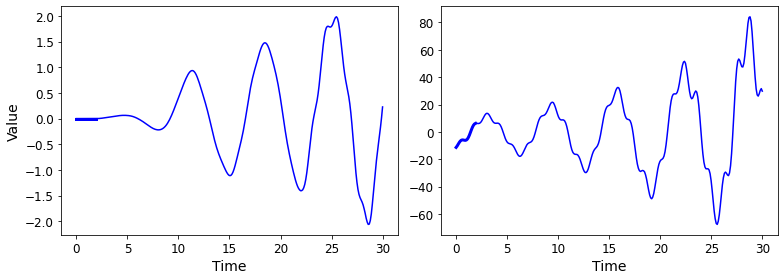

In [ ]:
with tf.Session() as sess:
    saver.restore(sess, "./my_time_series_model")

    sequence1 = [0. for i in range(n_steps)]
    for iteration in range(len(t) - n_steps):
        X_batch = np.array(sequence1[-n_steps:]).reshape(1, n_steps, 1)
        y_pred = sess.run(outputs, feed_dict={X: X_batch})
        sequence1.append(y_pred[0, -1, 0])

    sequence2 = [time_series(i * resolution + t_min + (t_max-t_min/3)) for i in range(n_steps)]
    for iteration in range(len(t) - n_steps):
        X_batch = np.array(sequence2[-n_steps:]).reshape(1, n_steps, 1)
        y_pred = sess.run(outputs, feed_dict={X: X_batch})
        sequence2.append(y_pred[0, -1, 0])

plt.figure(figsize=(11,4))
plt.subplot(121)
plt.plot(t, sequence1, "b-")
plt.plot(t[:n_steps], sequence1[:n_steps], "b-", linewidth=3)
plt.xlabel("Time")
plt.ylabel("Value")

plt.subplot(122)
plt.plot(t, sequence2, "b-")
plt.plot(t[:n_steps], sequence2[:n_steps], "b-", linewidth=3)
plt.xlabel("Time")
save_fig("creative_sequence_plot")
plt.show()

## RNNs Profundas

### MultiRNNCell

 No código a seguir, empilharemos três células 
idênticas (mas você poderia muito bem utilizar vários tipos de células com um número 
diferente de neurônios):

In [ ]:
reset_graph()

n_inputs = 2
n_steps = 5

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])

In [ ]:
n_neurons = 100
n_layers = 3

layers = [tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)
          for layer in range(n_layers)]
multi_layer_cell = tf.nn.rnn_cell.MultiRNNCell(layers)
outputs, states = tf.nn.dynamic_rnn(multi_layer_cell, X, dtype=tf.float32)

A variável states é uma tupla que contém um tensor por camada, cada um 
representando o estado final daquela célula da camada (com formato [batch_size, n_neu 
rons]). Se você configurar state_is_tuple=False ao criar uma MultiRNNCell, então 
states se torna um tensor único contendo os estados de cada camada concatenado no 
eixo coluna (ou seja, seu formato é [batch_size, n_layers * n_neurons]). 

In [ ]:
init = tf.global_variables_initializer()

In [ ]:
X_batch = np.random.rand(2, n_steps, n_inputs)

In [ ]:
with tf.Session() as sess:
    init.run()
    outputs_val, states_val = sess.run([outputs, states], feed_dict={X: X_batch})

In [ ]:
outputs_val.shape

(2, 5, 100)

### Distribuindo uma RNN Profunda Através de Múltiplas GPUs

**NÃO FAÇA ISSO**:

Não funcionará se tentar criar cada célula em um bloco 
`device()` diferente.

In [ ]:
with tf.device("/gpu:0"):  # BAD! This is ignored.
    layer1 = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)

with tf.device("/gpu:1"):  # BAD! Ignored again.
    layer2 = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)

Instead, you need a `DeviceCellWrapper`:

In [ ]:
import tensorflow as tf

class DeviceCellWrapper(tf.nn.rnn_cell.RNNCell):
  def __init__(self, device, cell):
    self._cell = cell
    self._device = device

  @property
  def state_size(self):
    return self._cell.state_size

  @property
  def output_size(self):
    return self._cell.output_size

  def __call__(self, inputs, state, scope=None):
    with tf.device(self._device):
        return self._cell(inputs, state, scope)

In [ ]:
reset_graph()

n_inputs = 5
n_steps = 20
n_neurons = 100

X = tf.placeholder(tf.float32, shape=[None, n_steps, n_inputs])

In [ ]:
devices = ["/cpu:0", "/cpu:0", "/cpu:0"] # replace with ["/gpu:0", "/gpu:1", "/gpu:2"] if you have 3 GPUs
cells = [DeviceCellWrapper(dev,tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons))
         for dev in devices]
multi_layer_cell = tf.nn.rnn_cell.MultiRNNCell(cells)
outputs, states = tf.nn.dynamic_rnn(multi_layer_cell, X, dtype=tf.float32)

Alternatively, since TensorFlow 1.1, you can use the `tf.contrib.rnn.DeviceWrapper` class (alias `tf.nn.rnn_cell.DeviceWrapper` since TF 1.2).

In [ ]:
init = tf.global_variables_initializer()

In [ ]:
with tf.Session() as sess:
    init.run()
    print(sess.run(outputs, feed_dict={X: np.random.rand(2, n_steps, n_inputs)}))

[[[-3.2902025e-02  1.1701925e-01 -4.5899268e-02 ...  3.8447708e-02
   -5.2490026e-02  5.8043696e-02]
  [ 3.5428789e-02 -7.4261159e-02 -6.4237520e-02 ... -2.4575698e-01
   -1.7762673e-01 -3.2653990e-03]
  [ 2.5972626e-01  1.4460507e-01  3.2931200e-01 ...  3.3882216e-01
    5.9885371e-02 -8.3145097e-02]
  ...
  [ 1.1804386e-01 -2.4166374e-01 -8.2779819e-01 ... -1.8578245e-01
    1.8968232e-01 -1.3526247e-01]
  [ 2.8783140e-01  3.9295375e-01 -3.1523669e-01 ... -7.8560747e-02
    4.3272460e-01 -6.6182829e-02]
  [ 7.4977994e-01  6.1105335e-01 -3.0168533e-01 ...  1.9564991e-01
   -1.6245708e-01 -5.2396655e-02]]

 [[-6.6802807e-02  7.3557675e-02 -2.9027527e-02 ... -7.7996820e-02
   -3.6577336e-02 -4.6675205e-02]
  [ 1.7154646e-01  4.2841542e-03  2.1881871e-03 ...  3.6853798e-02
   -8.1324175e-02  9.0100184e-02]
  [ 3.4563508e-02 -9.5752366e-02  1.5945026e-01 ...  1.6302206e-01
   -6.8304420e-02  1.0799031e-01]
  ...
  [ 1.9641414e-01 -2.1523061e-01 -5.8253765e-01 ...  3.0253285e-01
    5.4786

## Aplicando o Dropout

In [ ]:
reset_graph()

n_inputs = 1
n_neurons = 100
n_layers = 3
n_steps = 20
n_outputs = 1

In [ ]:
X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
y = tf.placeholder(tf.float32, [None, n_steps, n_outputs])

**Nota:** o parâmetro `input_keep_prob` pode ser um placeholder, tornando possível configurá-lo para qualquer valor desejado durante o treinamento e para 1.0 durante o teste (desativando efetivamente o dropout). Esta é uma solução muito mais elegante do que o recomendado nas versões anteriores do livro (ou seja, escrever sua própria classe wrapper ou ter um modelo separado para treinamento e teste).

O código a seguir aplica na 
RNN o dropout às entradas de cada camada:

In [ ]:
keep_prob = tf.placeholder_with_default(1.0, shape=())
cells = [tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)
         for layer in range(n_layers)]
cells_drop = [tf.nn.rnn_cell.DropoutWrapper(cell, input_keep_prob=keep_prob)
              for cell in cells]
multi_layer_cell = tf.nn.rnn_cell.MultiRNNCell(cells_drop)
rnn_outputs, states = tf.nn.dynamic_rnn(multi_layer_cell, X, dtype=tf.float32)

In [ ]:
learning_rate = 0.01

stacked_rnn_outputs = tf.reshape(rnn_outputs, [-1, n_neurons])
stacked_outputs = tf.layers.dense(stacked_rnn_outputs, n_outputs)
outputs = tf.reshape(stacked_outputs, [-1, n_steps, n_outputs])

loss = tf.reduce_mean(tf.square(outputs - y))
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
n_iterations = 1500
batch_size = 50
train_keep_prob = 0.5

with tf.Session() as sess:
    init.run()
    for iteration in range(n_iterations):
        X_batch, y_batch = next_batch(batch_size, n_steps)
        _, mse = sess.run([training_op, loss],
                          feed_dict={X: X_batch, y: y_batch,
                                     keep_prob: train_keep_prob})
        if iteration % 100 == 0:                   # not shown in the book
            print(iteration, "Training MSE:", mse) # not shown
    
    saver.save(sess, "./my_dropout_time_series_model")

0 Training MSE: 14.33215
100 Training MSE: 4.3290033
200 Training MSE: 3.9591365
300 Training MSE: 3.9542217
400 Training MSE: 3.7137098
500 Training MSE: 2.830646
600 Training MSE: 3.518297
700 Training MSE: 3.3831685
800 Training MSE: 4.174786
900 Training MSE: 4.6293907
1000 Training MSE: 3.5641384
1100 Training MSE: 3.80664
1200 Training MSE: 2.9258811
1300 Training MSE: 4.5471277
1400 Training MSE: 4.055207


Desativando o dropout durante o teste, você deve deixar o `keep_prob` no padrão 1.0 
(lembre-se de que ele deve estar ativo somente durante o treinamento):

In [ ]:
with tf.Session() as sess:
    saver.restore(sess, "./my_dropout_time_series_model")

    X_new = time_series(np.array(t_instance[:-1].reshape(-1, n_steps, n_inputs)))
    y_pred = sess.run(outputs, feed_dict={X: X_new})

INFO:tensorflow:Restoring parameters from ./my_dropout_time_series_model


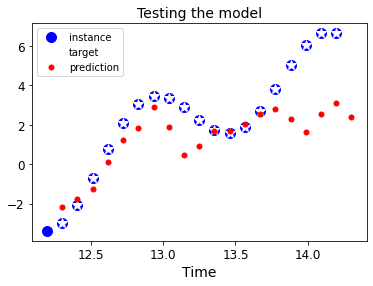

In [ ]:
plt.title("Testing the model", fontsize=14)
plt.plot(t_instance[:-1], time_series(t_instance[:-1]), "bo", markersize=10, label="instance")
plt.plot(t_instance[1:], time_series(t_instance[1:]), "w*", markersize=10, label="target")
plt.plot(t_instance[1:], y_pred[0,:,0], "r.", markersize=10, label="prediction")
plt.legend(loc="upper left")
plt.xlabel("Time")

plt.show()

Oops, it seems that Dropout does not help at all in this particular case. :/

## LSTM

In [ ]:
reset_graph()

lstm_cell = tf.nn.rnn_cell.BasicLSTMCell(num_units=n_neurons)

Instructions for updating:
This class is equivalent as tf.keras.layers.LSTMCell, and will be replaced by that in Tensorflow 2.0.


In [ ]:
n_steps = 28
n_inputs = 28
n_neurons = 150
n_outputs = 10
n_layers = 3

learning_rate = 0.001

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
y = tf.placeholder(tf.int32, [None])

lstm_cells = [tf.nn.rnn_cell.BasicLSTMCell(num_units=n_neurons)
              for layer in range(n_layers)]
multi_cell = tf.nn.rnn_cell.MultiRNNCell(lstm_cells)
outputs, states = tf.nn.dynamic_rnn(multi_cell, X, dtype=tf.float32)
top_layer_h_state = states[-1][1]
logits = tf.layers.dense(top_layer_h_state, n_outputs, name="softmax")
xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
loss = tf.reduce_mean(xentropy, name="loss")
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)
correct = tf.nn.in_top_k(logits, y, 1)
accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))
    
init = tf.global_variables_initializer()

In [ ]:
states

(LSTMStateTuple(c=<tf.Tensor 'rnn/while/Exit_3:0' shape=(?, 150) dtype=float32>, h=<tf.Tensor 'rnn/while/Exit_4:0' shape=(?, 150) dtype=float32>),
 LSTMStateTuple(c=<tf.Tensor 'rnn/while/Exit_5:0' shape=(?, 150) dtype=float32>, h=<tf.Tensor 'rnn/while/Exit_6:0' shape=(?, 150) dtype=float32>),
 LSTMStateTuple(c=<tf.Tensor 'rnn/while/Exit_7:0' shape=(?, 150) dtype=float32>, h=<tf.Tensor 'rnn/while/Exit_8:0' shape=(?, 150) dtype=float32>))

In [ ]:
top_layer_h_state

<tf.Tensor 'rnn/while/Exit_8:0' shape=(?, 150) dtype=float32>

In [ ]:
n_epochs = 10
batch_size = 150

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            X_batch = X_batch.reshape((-1, n_steps, n_inputs))
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        acc_batch = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        acc_test = accuracy.eval(feed_dict={X: X_test, y: y_test})
        print(epoch, "Last batch accuracy:", acc_batch, "Test accuracy:", acc_test)

0 Last batch accuracy: 0.96666664 Test accuracy: 0.9566
1 Last batch accuracy: 0.94666666 Test accuracy: 0.9712
2 Last batch accuracy: 0.94666666 Test accuracy: 0.9664
3 Last batch accuracy: 1.0 Test accuracy: 0.9828
4 Last batch accuracy: 0.98 Test accuracy: 0.9818
5 Last batch accuracy: 0.9866667 Test accuracy: 0.9816
6 Last batch accuracy: 0.99333334 Test accuracy: 0.9832
7 Last batch accuracy: 0.9866667 Test accuracy: 0.987
8 Last batch accuracy: 0.99333334 Test accuracy: 0.9809
9 Last batch accuracy: 1.0 Test accuracy: 0.9877


In [ ]:
lstm_cell = tf.nn.rnn_cell.LSTMCell(num_units=n_neurons, use_peepholes=True)

Instructions for updating:
This class is equivalent as tf.keras.layers.LSTMCell, and will be replaced by that in Tensorflow 2.0.


In [ ]:
gru_cell = tf.nn.rnn_cell.GRUCell(num_units=n_neurons)

Instructions for updating:
This class is equivalent as tf.keras.layers.GRUCell, and will be replaced by that in Tensorflow 2.0.


## Embeddings

### Busque os dados

In [ ]:
import urllib.request

import errno
import os
import zipfile

WORDS_PATH = "datasets/words"
WORDS_URL = 'http://mattmahoney.net/dc/text8.zip'

def mkdir_p(path):
    """Create directories, ok if they already exist.
    
    This is for python 2 support. In python >=3.2, simply use:
    >>> os.makedirs(path, exist_ok=True)
    """
    try:
        os.makedirs(path)
    except OSError as exc:
        if exc.errno == errno.EEXIST and os.path.isdir(path):
            pass
        else:
            raise

def fetch_words_data(words_url=WORDS_URL, words_path=WORDS_PATH):
    os.makedirs(words_path, exist_ok=True)
    zip_path = os.path.join(words_path, "words.zip")
    if not os.path.exists(zip_path):
        urllib.request.urlretrieve(words_url, zip_path)
    with zipfile.ZipFile(zip_path) as f:
        data = f.read(f.namelist()[0])
    return data.decode("ascii").split()

In [ ]:
words = fetch_words_data()

In [ ]:
words[:5]

### Construir o dicionário

In [ ]:
from collections import Counter

vocabulary_size = 50000

vocabulary = [("UNK", None)] + Counter(words).most_common(vocabulary_size - 1)
vocabulary = np.array([word for word, _ in vocabulary])
dictionary = {word: code for code, word in enumerate(vocabulary)}
data = np.array([dictionary.get(word, 0) for word in words])

In [ ]:
" ".join(words[:9]), data[:9]

In [ ]:
" ".join([vocabulary[word_index] for word_index in [5241, 3081, 12, 6, 195, 2, 3134, 46, 59]])

In [ ]:
words[24], data[24]

('culottes', 0)

### Gerar lotes

In [ ]:
from collections import deque

def generate_batch(batch_size, num_skips, skip_window):
    global data_index
    assert batch_size % num_skips == 0
    assert num_skips <= 2 * skip_window
    batch = np.ndarray(shape=[batch_size], dtype=np.int32)
    labels = np.ndarray(shape=[batch_size, 1], dtype=np.int32)
    span = 2 * skip_window + 1 # [ skip_window target skip_window ]
    buffer = deque(maxlen=span)
    for _ in range(span):
        buffer.append(data[data_index])
        data_index = (data_index + 1) % len(data)
    for i in range(batch_size // num_skips):
        target = skip_window  # target label at the center of the buffer
        targets_to_avoid = [ skip_window ]
        for j in range(num_skips):
            while target in targets_to_avoid:
                target = np.random.randint(0, span)
            targets_to_avoid.append(target)
            batch[i * num_skips + j] = buffer[skip_window]
            labels[i * num_skips + j, 0] = buffer[target]
        buffer.append(data[data_index])
        data_index = (data_index + 1) % len(data)
    return batch, labels

In [ ]:
np.random.seed(42)

In [ ]:
data_index = 0
batch, labels = generate_batch(8, 2, 1)

In [ ]:
batch, [vocabulary[word] for word in batch]

(array([3081, 3081,   12,   12,    6,    6,  195,  195], dtype=int32),
 ['originated', 'originated', 'as', 'as', 'a', 'a', 'term', 'term'])

In [ ]:
labels, [vocabulary[word] for word in labels[:, 0]]

(array([[  12],
        [5234],
        [   6],
        [3081],
        [  12],
        [ 195],
        [   2],
        [   6]], dtype=int32),
 ['as', 'anarchism', 'a', 'originated', 'as', 'term', 'of', 'a'])

### Construir o modelo


In [ ]:
batch_size = 128
embedding_size = 128  # Dimension of the embedding vector.
skip_window = 1       # How many words to consider left and right.
num_skips = 2         # How many times to reuse an input to generate a label.

# We pick a random validation set to sample nearest neighbors. Here we limit the
# validation samples to the words that have a low numeric ID, which by
# construction are also the most frequent.
valid_size = 16     # Random set of words to evaluate similarity on.
valid_window = 100  # Only pick dev samples in the head of the distribution.
valid_examples = np.random.choice(valid_window, valid_size, replace=False)
num_sampled = 64    # Number of negative examples to sample.

learning_rate = 0.01

In [ ]:
reset_graph()

# Input data.
train_labels = tf.placeholder(tf.int32, shape=[batch_size, 1])
valid_dataset = tf.constant(valid_examples, dtype=tf.int32)

In [ ]:
vocabulary_size = 50000
embedding_size = 150

# Look up embeddings for inputs.
init_embeds = tf.random_uniform([vocabulary_size, embedding_size], -1.0, 1.0)
embeddings = tf.Variable(init_embeds)

In [ ]:
train_inputs = tf.placeholder(tf.int32, shape=[None])
embed = tf.nn.embedding_lookup(embeddings, train_inputs)

In [ ]:
# Construct the variables for the NCE loss
nce_weights = tf.Variable(
    tf.truncated_normal([vocabulary_size, embedding_size],
                        stddev=1.0 / np.sqrt(embedding_size)))
nce_biases = tf.Variable(tf.zeros([vocabulary_size]))

# Compute the average NCE loss for the batch.
# tf.nce_loss automatically draws a new sample of the negative labels each
# time we evaluate the loss.
loss = tf.reduce_mean(
    tf.nn.nce_loss(nce_weights, nce_biases, train_labels, embed,
                   num_sampled, vocabulary_size))

# Construct the Adam optimizer
optimizer = tf.train.AdamOptimizer(learning_rate)
training_op = optimizer.minimize(loss)

# Compute the cosine similarity between minibatch examples and all embeddings.
norm = tf.sqrt(tf.reduce_sum(tf.square(embeddings), axis=1, keepdims=True))
normalized_embeddings = embeddings / norm
valid_embeddings = tf.nn.embedding_lookup(normalized_embeddings, valid_dataset)
similarity = tf.matmul(valid_embeddings, normalized_embeddings, transpose_b=True)

# Add variable initializer.
init = tf.global_variables_initializer()

### Treine o modelo


In [ ]:
num_steps = 10001

with tf.Session() as session:
    init.run()

    average_loss = 0
    for step in range(num_steps):
        print("\rIteration: {}".format(step), end="\t")
        batch_inputs, batch_labels = generate_batch(batch_size, num_skips, skip_window)
        feed_dict = {train_inputs : batch_inputs, train_labels : batch_labels}

        # We perform one update step by evaluating the training op (including it
        # in the list of returned values for session.run()
        _, loss_val = session.run([training_op, loss], feed_dict=feed_dict)
        average_loss += loss_val

        if step % 2000 == 0:
            if step > 0:
                average_loss /= 2000
            # The average loss is an estimate of the loss over the last 2000 batches.
            print("Average loss at step ", step, ": ", average_loss)
            average_loss = 0

        # Note that this is expensive (~20% slowdown if computed every 500 steps)
        if step % 10000 == 0:
            sim = similarity.eval()
            for i in range(valid_size):
                valid_word = vocabulary[valid_examples[i]]
                top_k = 8 # number of nearest neighbors
                nearest = (-sim[i, :]).argsort()[1:top_k+1]
                log_str = "Nearest to %s:" % valid_word
                for k in range(top_k):
                    close_word = vocabulary[nearest[k]]
                    log_str = "%s %s," % (log_str, close_word)
                print(log_str)

    final_embeddings = normalized_embeddings.eval()

Iteration: 0	Average loss at step  0 :  289.90948486328125
Nearest to over: tt, tuned, manichaeans, fractional, cambridge, balaguer, fluoride, strenuously,
Nearest to one: imagines, tijuana, hindrance, motorcyclist, steadfastly, lords, letting, hutchinson,
Nearest to were: bezier, antibodies, nicknamed, panthers, compiler, tao, smarter, busy,
Nearest to may: failure, rna, efficacious, aspirin, lecompton, definitive, geese, amphibious,
Nearest to two: annihilate, bettors, wir, cindy, epinephrine, team, voluntarily, crystallize,
Nearest to its: knob, abeokuta, bracelet, bastards, ivens, objectivity, blanton, cold,
Nearest to than: lame, watts, stones, sram, elves, zarqawi, applets, cloves,
Nearest to these: pedro, condoned, neck, ssn, supervising, doug, thereto, melton,
Nearest to they: lowly, deportation, shrewd, reznor, tojo, decadent, occured, risotto,
Nearest to is: interests, golfers, dropouts, egyptians, richards, legionnaires, opener, leonel,
Nearest to up: clair, drives, steadfas

Let's save the final embeddings (of course you can use a TensorFlow `Saver` if you prefer):

In [ ]:
np.save("./my_final_embeddings.npy", final_embeddings)

### Plote as incorporações


In [ ]:
def plot_with_labels(low_dim_embs, labels):
    assert low_dim_embs.shape[0] >= len(labels), "More labels than embeddings"
    plt.figure(figsize=(18, 18))  #in inches
    for i, label in enumerate(labels):
        x, y = low_dim_embs[i,:]
        plt.scatter(x, y)
        plt.annotate(label,
                     xy=(x, y),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


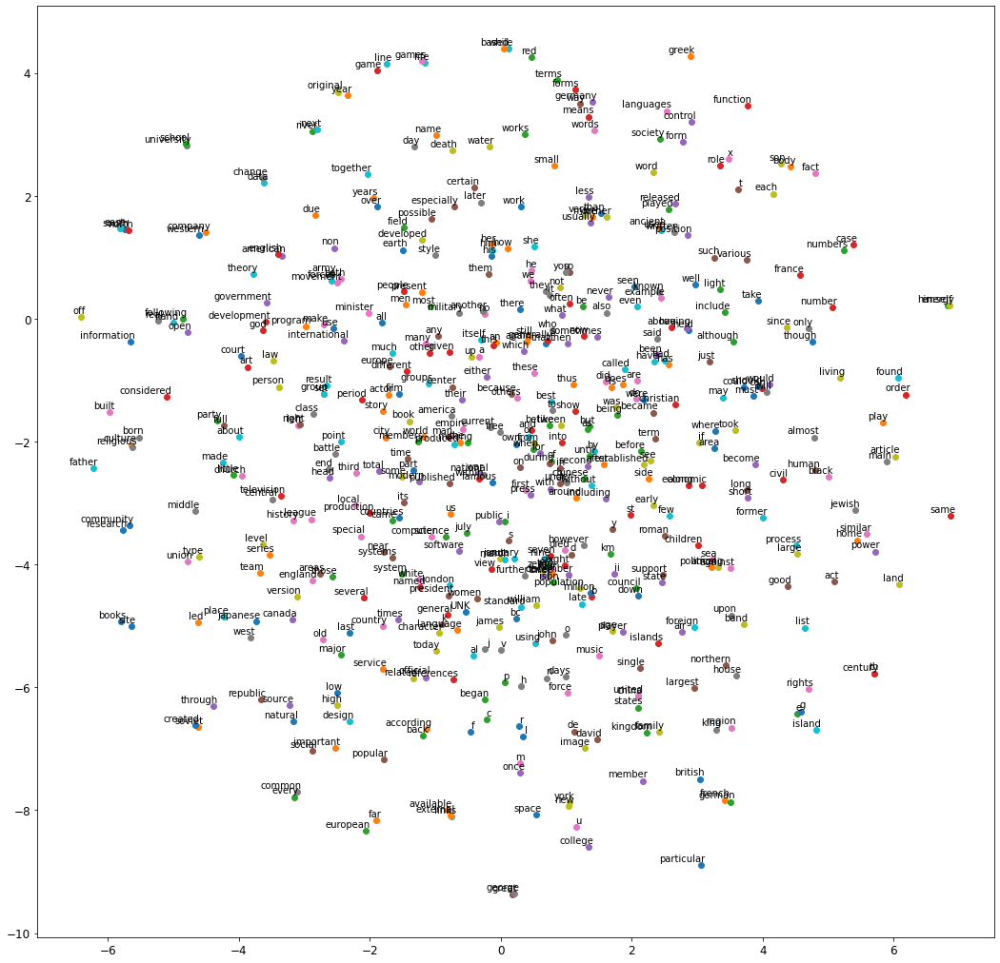

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(perplexity=30, n_components=2, init='pca', n_iter=5000)
plot_only = 500
low_dim_embs = tsne.fit_transform(final_embeddings[:plot_only,:])
labels = [vocabulary[i] for i in range(plot_only)]
plot_with_labels(low_dim_embs, labels)

## Maquina de Tradução


A função `basic_rnn_seq2seq()` cria um modelo Encoder/Decoder simples: primeiro executa um RNN para codificar `encoder_inputs` em um vetor de estado, depois executa um decodificador inicializado com o último estado do codificador em `decoder_inputs`. O codificador e o decodificador usam o mesmo tipo de célula RNN, mas não compartilham parâmetros.

In [ ]:
import tensorflow as tf
reset_graph()

n_steps = 50
n_neurons = 200
n_layers = 3
num_encoder_symbols = 20000
num_decoder_symbols = 20000
embedding_size = 150
learning_rate = 0.01

X = tf.placeholder(tf.int32, [None, n_steps]) # English sentences
Y = tf.placeholder(tf.int32, [None, n_steps]) # French translations
W = tf.placeholder(tf.float32, [None, n_steps - 1, 1])
Y_input = Y[:, :-1]
Y_target = Y[:, 1:]

encoder_inputs = tf.unstack(tf.transpose(X)) # list of 1D tensors
decoder_inputs = tf.unstack(tf.transpose(Y_input)) # list of 1D tensors

lstm_cells = [tf.nn.rnn_cell.BasicLSTMCell(num_units=n_neurons)
              for layer in range(n_layers)]
cell = tf.nn.rnn_cell.MultiRNNCell(lstm_cells)

output_seqs, states = tf.contrib.legacy_seq2seq.embedding_rnn_seq2seq(
    encoder_inputs,
    decoder_inputs,
    cell,
    num_encoder_symbols,
    num_decoder_symbols,
    embedding_size)

logits = tf.transpose(tf.unstack(output_seqs), perm=[1, 0, 2])

In [ ]:
logits_flat = tf.reshape(logits, [-1, num_decoder_symbols])
Y_target_flat = tf.reshape(Y_target, [-1])
W_flat = tf.reshape(W, [-1])
xentropy = W_flat * tf.nn.sparse_softmax_cross_entropy_with_logits(labels=Y_target_flat, logits=logits_flat)
loss = tf.reduce_mean(xentropy)
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()


#Capítulo 15

Autoencoders

## Setup

Primeiro, vamos garantir que este notebook funcione bem em python 2 e 3, importe alguns módulos comuns, assegure-se de que o MatplotLib plote as figuras inline e prepare uma função para salvar as figuras:


In [ ]:
# To support both python 2 and python 3
from __future__ import division, print_function, unicode_literals

# Common imports
import numpy as np
import os
import sys

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 1.x
except Exception:
    pass

# to make this notebook's output stable across runs
def reset_graph(seed=42):
    tf.reset_default_graph()
    tf.set_random_seed(seed)
    np.random.seed(seed)

# To plot pretty figures
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "autoencoders"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

TensorFlow 1.x selected.


Algumas funções utilitárias para plotar uma imagem 28x28 em escala de cinza:


In [ ]:
def plot_image(image, shape=[28, 28]):
    plt.imshow(image.reshape(shape), cmap="Greys", interpolation="nearest")
    plt.axis("off")

In [ ]:
def plot_multiple_images(images, n_rows, n_cols, pad=2):
    images = images - images.min()  # make the minimum == 0, so the padding looks white
    w,h = images.shape[1:]
    image = np.zeros(((w+pad)*n_rows+pad, (h+pad)*n_cols+pad))
    for y in range(n_rows):
        for x in range(n_cols):
            image[(y*(h+pad)+pad):(y*(h+pad)+pad+h),(x*(w+pad)+pad):(x*(w+pad)+pad+w)] = images[y*n_cols+x]
    plt.imshow(image, cmap="Greys", interpolation="nearest")
    plt.axis("off")

## Executando o PCA com um Autoencoder Linear Incompleto

Construir conjunto de dados 3D:


In [ ]:
import numpy.random as rnd

rnd.seed(4)
m = 200
w1, w2 = 0.1, 0.3
noise = 0.1

angles = rnd.rand(m) * 3 * np.pi / 2 - 0.5
data = np.empty((m, 3))
data[:, 0] = np.cos(angles) + np.sin(angles)/2 + noise * rnd.randn(m) / 2
data[:, 1] = np.sin(angles) * 0.7 + noise * rnd.randn(m) / 2
data[:, 2] = data[:, 0] * w1 + data[:, 1] * w2 + noise * rnd.randn(m)

Normalize os dados:


In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train = scaler.fit_transform(data[:100])
X_test = scaler.transform(data[100:])

Agora vamos construir o Autoencoder...


**Nota:** em vez de usar a função `full_connected()` do módulo `tensorflow.contrib.layers` (como no livro), agora usamos a função `dense()` do módulo `tf.layers`, que não não existiam quando este capítulo foi escrito. Isso é preferível porque qualquer coisa no contrib pode ser alterada ou excluída sem aviso prévio, enquanto `tf.layers` faz parte da API oficial. Como você verá, o código é basicamente o mesmo.


As principais diferenças relevantes para este capítulo são:
* o parâmetro `scope` foi renomeado para `name`, e o sufixo `_fn` foi removido em todos os parâmetros que o possuíam (por exemplo, o parâmetro `activation_fn` foi renomeado para `activation`).
* o parâmetro `weights` foi renomeado para `kernel` e a variável weights agora é denominada `"kernel"` em vez de `"weights"`,
* a variável bias agora é chamada de `"bias"` em vez de `"biases"`,
* a ativação padrão é `None` em vez de `tf.nn.relu`

O código a seguir cria um autoencoder linear simples para a execução do PCA em um 
conjunto de dados 3D, projetando-o para 2D:

In [ ]:
import tensorflow as tf

reset_graph()

n_inputs = 3
n_hidden = 2  # codings
n_outputs = n_inputs

learning_rate = 0.01

X = tf.placeholder(tf.float32, shape=[None, n_inputs])
hidden = tf.layers.dense(X, n_hidden)
outputs = tf.layers.dense(hidden, n_outputs)

reconstruction_loss = tf.reduce_mean(tf.square(outputs - X))

optimizer = tf.train.AdamOptimizer(learning_rate)
training_op = optimizer.minimize(reconstruction_loss)

init = tf.global_variables_initializer()

Instructions for updating:
Use keras.layers.Dense instead.
Instructions for updating:
Please use `layer.__call__` method instead.


As duas coisas a notar são:
* O número de saídas é igual ao número de entradas;
* Para executar o PCA simples, não utilizamos nenhuma função de ativação (ou 
seja, todos os neurônios são lineares) e a função de custo é o MSE.

Agora vamos carregar o conjunto de dados, treinar o modelo no conjunto de treinamento 
e utilizá-lo para programar o conjunto de teste (ou seja, projetá-lo para 2D):

In [ ]:
n_iterations = 1000
codings = hidden

with tf.Session() as sess:
    init.run()
    for iteration in range(n_iterations):
        training_op.run(feed_dict={X: X_train})
    codings_val = codings.eval(feed_dict={X: X_test})

Saving figure linear_autoencoder_pca_plot


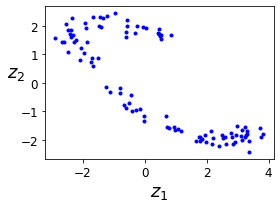

In [ ]:
fig = plt.figure(figsize=(4,3))
plt.plot(codings_val[:,0], codings_val[:, 1], "b.")
plt.xlabel("$z_1$", fontsize=18)
plt.ylabel("$z_2$", fontsize=18, rotation=0)
save_fig("linear_autoencoder_pca_plot")
plt.show()

## Autoencoders Empilhados

Vamos usar o MNIST:


Um autoencoder do MNIST pode ter 784 entradas, seguidas 
por uma camada oculta com 300 neurônios, depois uma camada oculta central de 150 
neurônios e, então, outra camada oculta com 300 neurônios e uma camada de saída com 
784. Parece um sanduíche.

In [ ]:
from tensorflow.examples.tutorials.mnist import input_data
mnist = input_data.read_data_sets("/tmp/data/")

Instructions for updating:
Please use alternatives such as official/mnist/dataset.py from tensorflow/models.
Instructions for updating:
Please write your own downloading logic.
Instructions for updating:
Please use urllib or similar directly.
Successfully downloaded train-images-idx3-ubyte.gz 9912422 bytes.
Instructions for updating:
Please use tf.data to implement this functionality.
Extracting /tmp/data/train-images-idx3-ubyte.gz
Successfully downloaded train-labels-idx1-ubyte.gz 28881 bytes.
Instructions for updating:
Please use tf.data to implement this functionality.
Extracting /tmp/data/train-labels-idx1-ubyte.gz
Successfully downloaded t10k-images-idx3-ubyte.gz 1648877 bytes.
Extracting /tmp/data/t10k-images-idx3-ubyte.gz
Successfully downloaded t10k-labels-idx1-ubyte.gz 4542 bytes.
Extracting /tmp/data/t10k-labels-idx1-ubyte.gz
Instructions for updating:
Please use alternatives such as official/mnist/dataset.py from tensorflow/models.



### Implementação do TensorFlow

Vamos construir um Autoencoder empilhado com 3 camadas ocultas e 1 camada de saída (ou seja, 2 Autoencoders empilhados). Usaremos ativação ELU, inicialização He e regularização L2.


**Nota:** como a função `tf.layers.dense()` é incompatível com `tf.contrib.layers.arg_scope()` (que é usada no livro), agora usamos a função `functools.partial()` do python . Isso facilita a criação de uma função `my_dense_layer()` que apenas chama `tf.layers.dense()` com os parâmetros desejados definidos automaticamente (a menos que sejam substituídos ao chamar `my_dense_layer()`).


O código a seguir com a utilização da inicialização He, a função de ativação ELU e a 
regularização ℓ2 cria um autoencoder empilhado para o MNIST. O código deve parecer bem 
familiar, porém não existem labels (sem y).

In [ ]:
reset_graph()

from functools import partial

n_inputs = 28 * 28
n_hidden1 = 300
n_hidden2 = 150  # codings
n_hidden3 = n_hidden1
n_outputs = n_inputs

learning_rate = 0.01
l2_reg = 0.0001

X = tf.placeholder(tf.float32, shape=[None, n_inputs])

he_init = tf.contrib.layers.variance_scaling_initializer() # He initialization
#Equivalent to:
#he_init = lambda shape, dtype=tf.float32: tf.truncated_normal(shape, 0., stddev=np.sqrt(2/shape[0]))
l2_regularizer = tf.contrib.layers.l2_regularizer(l2_reg)
my_dense_layer = partial(tf.layers.dense,
                         activation=tf.nn.elu,
                         kernel_initializer=he_init,
                         kernel_regularizer=l2_regularizer)

hidden1 = my_dense_layer(X, n_hidden1)
hidden2 = my_dense_layer(hidden1, n_hidden2)
hidden3 = my_dense_layer(hidden2, n_hidden3)
outputs = my_dense_layer(hidden3, n_outputs, activation=None)

reconstruction_loss = tf.reduce_mean(tf.square(outputs - X))

reg_losses = tf.get_collection(tf.GraphKeys.REGULARIZATION_LOSSES)
loss = tf.add_n([reconstruction_loss] + reg_losses)

optimizer = tf.train.AdamOptimizer(learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()
saver = tf.train.Saver() # not shown in the book

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



Agora vamos treinar! Observe que não alimentamos valores de destino (`y_batch` não é usado). Este é um treinamento não supervisionado.


In [ ]:
n_epochs = 5
batch_size = 150

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        n_batches = mnist.train.num_examples // batch_size
        for iteration in range(n_batches):
            print("\r{}%".format(100 * iteration // n_batches), end="") # not shown in the book
            sys.stdout.flush()                                          # not shown
            X_batch, y_batch = mnist.train.next_batch(batch_size)
            sess.run(training_op, feed_dict={X: X_batch})
        loss_train = reconstruction_loss.eval(feed_dict={X: X_batch})   # not shown
        print("\r{}".format(epoch), "Train MSE:", loss_train)           # not shown
        saver.save(sess, "./my_model_all_layers.ckpt")                  # not shown

0 Train MSE: 0.020552896
1 Train MSE: 0.011453541
2 Train MSE: 0.010228417
3 Train MSE: 0.009904081
4 Train MSE: 0.010379249


Esta função carrega o modelo, avalia-o no conjunto de teste (mede o erro de reconstrução), depois exibe a imagem original e sua reconstrução:


In [ ]:
def show_reconstructed_digits(X, outputs, model_path = None, n_test_digits = 2):
    with tf.Session() as sess:
        if model_path:
            saver.restore(sess, model_path)
        X_test = mnist.test.images[:n_test_digits]
        outputs_val = outputs.eval(feed_dict={X: X_test})

    fig = plt.figure(figsize=(8, 3 * n_test_digits))
    for digit_index in range(n_test_digits):
        plt.subplot(n_test_digits, 2, digit_index * 2 + 1)
        plot_image(X_test[digit_index])
        plt.subplot(n_test_digits, 2, digit_index * 2 + 2)
        plot_image(outputs_val[digit_index])

INFO:tensorflow:Restoring parameters from ./my_model_all_layers.ckpt
Saving figure reconstruction_plot


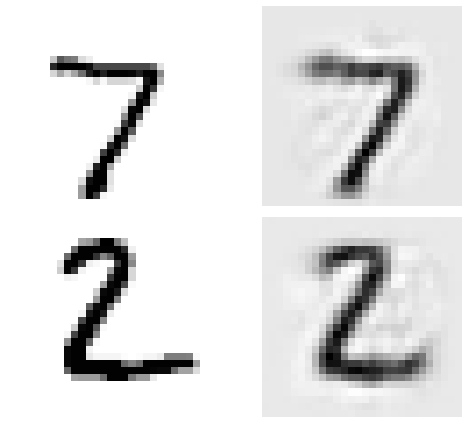

In [ ]:
show_reconstructed_digits(X, outputs, "./my_model_all_layers.ckpt")
save_fig("reconstruction_plot")

### Amarrando Pesos

É comum amarrar os pesos do codificador e do decodificador (`weights_decoder = tf.transpose(weights_encoder)`). Infelizmente isso torna impossível (ou muito complicado) usar a função `tf.layers.dense()`, então precisamos construir o Autoencoder manualmente:


In [ ]:
reset_graph()

n_inputs = 28 * 28
n_hidden1 = 300
n_hidden2 = 150  # codings
n_hidden3 = n_hidden1
n_outputs = n_inputs

learning_rate = 0.01
l2_reg = 0.0005

In [ ]:
activation = tf.nn.elu
regularizer = tf.contrib.layers.l2_regularizer(l2_reg)
initializer = tf.contrib.layers.variance_scaling_initializer()

X = tf.placeholder(tf.float32, shape=[None, n_inputs])

weights1_init = initializer([n_inputs, n_hidden1])
weights2_init = initializer([n_hidden1, n_hidden2])

weights1 = tf.Variable(weights1_init, dtype=tf.float32, name="weights1")
weights2 = tf.Variable(weights2_init, dtype=tf.float32, name="weights2")
weights3 = tf.transpose(weights2, name="weights3")  # tied weights
weights4 = tf.transpose(weights1, name="weights4")  # tied weights

biases1 = tf.Variable(tf.zeros(n_hidden1), name="biases1")
biases2 = tf.Variable(tf.zeros(n_hidden2), name="biases2")
biases3 = tf.Variable(tf.zeros(n_hidden3), name="biases3")
biases4 = tf.Variable(tf.zeros(n_outputs), name="biases4")

hidden1 = activation(tf.matmul(X, weights1) + biases1)
hidden2 = activation(tf.matmul(hidden1, weights2) + biases2)
hidden3 = activation(tf.matmul(hidden2, weights3) + biases3)
outputs = tf.matmul(hidden3, weights4) + biases4

reconstruction_loss = tf.reduce_mean(tf.square(outputs - X))
reg_loss = regularizer(weights1) + regularizer(weights2)
loss = reconstruction_loss + reg_loss

optimizer = tf.train.AdamOptimizer(learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()

Este código é bastante simples, mas há algumas coisas importantes a serem observadas:
* Primeiro, weight3 e weights4 não são variáveis, são a transposição de weights2 
e weights1 (eles estão “amarrados” a eles), respectivamente;
* Segundo, como não são variáveis, não adianta regularizá-las: só regularizamos 
weights1 e weights2;
* Terceiro, vieses nunca são amarrados, e nunca regularizados.


In [ ]:
saver = tf.train.Saver()

In [ ]:
n_epochs = 5
batch_size = 150

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        n_batches = mnist.train.num_examples // batch_size
        for iteration in range(n_batches):
            print("\r{}%".format(100 * iteration // n_batches), end="")
            sys.stdout.flush()
            X_batch, y_batch = mnist.train.next_batch(batch_size)
            sess.run(training_op, feed_dict={X: X_batch})
        loss_train = reconstruction_loss.eval(feed_dict={X: X_batch})
        print("\r{}".format(epoch), "Train MSE:", loss_train)
        saver.save(sess, "./my_model_tying_weights.ckpt")

0 Train MSE: 0.0176115
1 Train MSE: 0.016345043
2 Train MSE: 0.015885431
3 Train MSE: 0.014880197
4 Train MSE: 0.01721996


INFO:tensorflow:Restoring parameters from ./my_model_tying_weights.ckpt


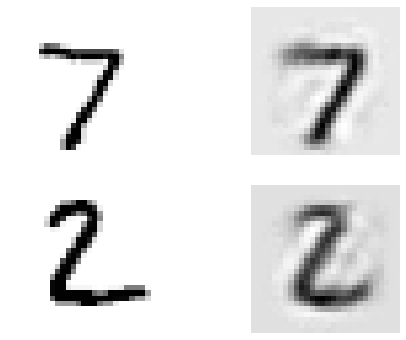

In [ ]:
show_reconstructed_digits(X, outputs, "./my_model_tying_weights.ckpt")

### Treinando um Autoencoder por vez em vários gráficos


Há muitas maneiras de treinar um Autoencoder por vez. A primeira abordagem é treinar cada Autoencoder usando um gráfico diferente, então criamos o Stacked Autoencoder simplesmente inicializando-o com os pesos e bias copiados desses Autoencoders.


Vamos criar uma função que treinará um autoencoder e retornará o conjunto de treinamento transformado (ou seja, a saída da camada oculta) e os parâmetros do modelo.


In [ ]:
reset_graph()

from functools import partial

def train_autoencoder(X_train, n_neurons, n_epochs, batch_size,
                      learning_rate = 0.01, l2_reg = 0.0005, seed=42,
                      hidden_activation=tf.nn.elu,
                      output_activation=tf.nn.elu):
    graph = tf.Graph()
    with graph.as_default():
        tf.set_random_seed(seed)

        n_inputs = X_train.shape[1]

        X = tf.placeholder(tf.float32, shape=[None, n_inputs])
        
        my_dense_layer = partial(
            tf.layers.dense,
            kernel_initializer=tf.contrib.layers.variance_scaling_initializer(),
            kernel_regularizer=tf.contrib.layers.l2_regularizer(l2_reg))

        hidden = my_dense_layer(X, n_neurons, activation=hidden_activation, name="hidden")
        outputs = my_dense_layer(hidden, n_inputs, activation=output_activation, name="outputs")

        reconstruction_loss = tf.reduce_mean(tf.square(outputs - X))

        reg_losses = tf.get_collection(tf.GraphKeys.REGULARIZATION_LOSSES)
        loss = tf.add_n([reconstruction_loss] + reg_losses)

        optimizer = tf.train.AdamOptimizer(learning_rate)
        training_op = optimizer.minimize(loss)

        init = tf.global_variables_initializer()

    with tf.Session(graph=graph) as sess:
        init.run()
        for epoch in range(n_epochs):
            n_batches = len(X_train) // batch_size
            for iteration in range(n_batches):
                print("\r{}%".format(100 * iteration // n_batches), end="")
                sys.stdout.flush()
                indices = rnd.permutation(len(X_train))[:batch_size]
                X_batch = X_train[indices]
                sess.run(training_op, feed_dict={X: X_batch})
            loss_train = reconstruction_loss.eval(feed_dict={X: X_batch})
            print("\r{}".format(epoch), "Train MSE:", loss_train)
        params = dict([(var.name, var.eval()) for var in tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES)])
        hidden_val = hidden.eval(feed_dict={X: X_train})
        return hidden_val, params["hidden/kernel:0"], params["hidden/bias:0"], params["outputs/kernel:0"], params["outputs/bias:0"]

Agora vamos treinar dois Autoencoders. O primeiro é treinado nos dados de treinamento e o segundo é treinado na saída da camada oculta do Autoencoder anterior:


In [ ]:
hidden_output, W1, b1, W4, b4 = train_autoencoder(mnist.train.images, n_neurons=300, n_epochs=4, batch_size=150,
                                                  output_activation=None)
_, W2, b2, W3, b3 = train_autoencoder(hidden_output, n_neurons=150, n_epochs=4, batch_size=150)

0 Train MSE: 0.018284036
1 Train MSE: 0.018530114
2 Train MSE: 0.019215489
3 Train MSE: 0.01993764
0 Train MSE: 0.0043923776
1 Train MSE: 0.0047732485
2 Train MSE: 0.0046483013
3 Train MSE: 0.004639984


Por fim, podemos criar um Autoencoder empilhado simplesmente reutilizando os pesos e tendências dos Autoencoders que acabamos de treinar:


In [ ]:
reset_graph()

n_inputs = 28*28

X = tf.placeholder(tf.float32, shape=[None, n_inputs])
hidden1 = tf.nn.elu(tf.matmul(X, W1) + b1)
hidden2 = tf.nn.elu(tf.matmul(hidden1, W2) + b2)
hidden3 = tf.nn.elu(tf.matmul(hidden2, W3) + b3)
outputs = tf.matmul(hidden3, W4) + b4

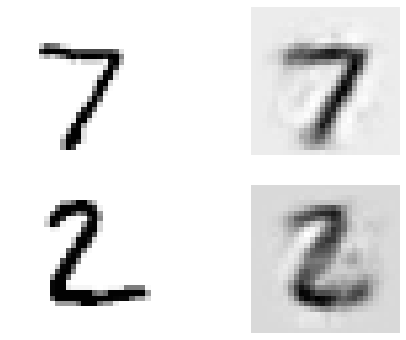

In [ ]:
show_reconstructed_digits(X, outputs)

### Treinando um Autoencoder por vez em um único gráfico


Outra abordagem é usar um único gráfico. Para fazer isso, criamos o gráfico para o Autoencoder empilhado completo, mas também adicionamos operações para treinar cada Autoencoder independentemente: a fase 1 treina a camada inferior e superior (ou seja, o primeiro Autoencoder) e a fase 2 treina as duas camadas intermediárias ( ou seja, o segundo Autoencoder).


In [ ]:
reset_graph()

n_inputs = 28 * 28
n_hidden1 = 300
n_hidden2 = 150  # codings
n_hidden3 = n_hidden1
n_outputs = n_inputs

learning_rate = 0.01
l2_reg = 0.0001

activation = tf.nn.elu
regularizer = tf.contrib.layers.l2_regularizer(l2_reg)
initializer = tf.contrib.layers.variance_scaling_initializer()

X = tf.placeholder(tf.float32, shape=[None, n_inputs])

weights1_init = initializer([n_inputs, n_hidden1])
weights2_init = initializer([n_hidden1, n_hidden2])
weights3_init = initializer([n_hidden2, n_hidden3])
weights4_init = initializer([n_hidden3, n_outputs])

weights1 = tf.Variable(weights1_init, dtype=tf.float32, name="weights1")
weights2 = tf.Variable(weights2_init, dtype=tf.float32, name="weights2")
weights3 = tf.Variable(weights3_init, dtype=tf.float32, name="weights3")
weights4 = tf.Variable(weights4_init, dtype=tf.float32, name="weights4")

biases1 = tf.Variable(tf.zeros(n_hidden1), name="biases1")
biases2 = tf.Variable(tf.zeros(n_hidden2), name="biases2")
biases3 = tf.Variable(tf.zeros(n_hidden3), name="biases3")
biases4 = tf.Variable(tf.zeros(n_outputs), name="biases4")

hidden1 = activation(tf.matmul(X, weights1) + biases1)
hidden2 = activation(tf.matmul(hidden1, weights2) + biases2)
hidden3 = activation(tf.matmul(hidden2, weights3) + biases3)
outputs = tf.matmul(hidden3, weights4) + biases4

reconstruction_loss = tf.reduce_mean(tf.square(outputs - X))

In [ ]:
optimizer = tf.train.AdamOptimizer(learning_rate)

with tf.name_scope("phase1"):
    phase1_outputs = tf.matmul(hidden1, weights4) + biases4  # bypass hidden2 and hidden3
    phase1_reconstruction_loss = tf.reduce_mean(tf.square(phase1_outputs - X))
    phase1_reg_loss = regularizer(weights1) + regularizer(weights4)
    phase1_loss = phase1_reconstruction_loss + phase1_reg_loss
    phase1_training_op = optimizer.minimize(phase1_loss)

with tf.name_scope("phase2"):
    phase2_reconstruction_loss = tf.reduce_mean(tf.square(hidden3 - hidden1))
    phase2_reg_loss = regularizer(weights2) + regularizer(weights3)
    phase2_loss = phase2_reconstruction_loss + phase2_reg_loss
    train_vars = [weights2, biases2, weights3, biases3]
    phase2_training_op = optimizer.minimize(phase2_loss, var_list=train_vars) # freeze hidden1

A primeira fase é bastante direta: apenas criamos uma camada de saída que pula as camadas ocultas 2 e 3, depois construímos as operações de treinamento para minimizar 
a distância entre as saídas e as entradas (mais alguma regularização).


A segunda fase apenas adiciona as operações necessárias para minimizar a distância 
entre a saída da camada oculta 3 e a camada oculta 1 (também com alguma regularização). Mais importante, deixando de fora *weights1* e *biases1*, fornecemos a lista 
de variáveis treináveis para o método `minimize();` efetivamente congelando a camada 
oculta 1 durante a fase 2.


Durante a fase de execução, você só precisa executar o treinamento da fase 1 para um 
número de épocas, depois o treinamento de fase 2 para mais algumas épocas.

In [ ]:
init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
training_ops = [phase1_training_op, phase2_training_op]
reconstruction_losses = [phase1_reconstruction_loss, phase2_reconstruction_loss]
n_epochs = [4, 4]
batch_sizes = [150, 150]

with tf.Session() as sess:
    init.run()
    for phase in range(2):
        print("Training phase #{}".format(phase + 1))
        for epoch in range(n_epochs[phase]):
            n_batches = mnist.train.num_examples // batch_sizes[phase]
            for iteration in range(n_batches):
                print("\r{}%".format(100 * iteration // n_batches), end="")
                sys.stdout.flush()
                X_batch, y_batch = mnist.train.next_batch(batch_sizes[phase])
                sess.run(training_ops[phase], feed_dict={X: X_batch})
            loss_train = reconstruction_losses[phase].eval(feed_dict={X: X_batch})
            print("\r{}".format(epoch), "Train MSE:", loss_train)
            saver.save(sess, "./my_model_one_at_a_time.ckpt")
    loss_test = reconstruction_loss.eval(feed_dict={X: mnist.test.images})
    print("Test MSE:", loss_test)

Training phase #1
0 Train MSE: 0.007929094
1 Train MSE: 0.007738199
2 Train MSE: 0.007619132
3 Train MSE: 0.007821332
Training phase #2
0 Train MSE: 0.13818401
1 Train MSE: 0.004372259
2 Train MSE: 0.0024463371
3 Train MSE: 0.0018817892
Test MSE: 0.009756848


### Armazenar em cache as saídas da camada congelada


In [ ]:
training_ops = [phase1_training_op, phase2_training_op]
reconstruction_losses = [phase1_reconstruction_loss, phase2_reconstruction_loss]
n_epochs = [4, 4]
batch_sizes = [150, 150]

with tf.Session() as sess:
    init.run()
    for phase in range(2):
        print("Training phase #{}".format(phase + 1))
        if phase == 1:
            hidden1_cache = hidden1.eval(feed_dict={X: mnist.train.images})
        for epoch in range(n_epochs[phase]):
            n_batches = mnist.train.num_examples // batch_sizes[phase]
            for iteration in range(n_batches):
                print("\r{}%".format(100 * iteration // n_batches), end="")
                sys.stdout.flush()
                if phase == 1:
                    indices = rnd.permutation(mnist.train.num_examples)
                    hidden1_batch = hidden1_cache[indices[:batch_sizes[phase]]]
                    feed_dict = {hidden1: hidden1_batch}
                    sess.run(training_ops[phase], feed_dict=feed_dict)
                else:
                    X_batch, y_batch = mnist.train.next_batch(batch_sizes[phase])
                    feed_dict = {X: X_batch}
                    sess.run(training_ops[phase], feed_dict=feed_dict)
            loss_train = reconstruction_losses[phase].eval(feed_dict=feed_dict)
            print("\r{}".format(epoch), "Train MSE:", loss_train)
            saver.save(sess, "./my_model_cache_frozen.ckpt")
    loss_test = reconstruction_loss.eval(feed_dict={X: mnist.test.images})
    print("Test MSE:", loss_test)

Training phase #1
0 Train MSE: 0.007987019
1 Train MSE: 0.0072099417
2 Train MSE: 0.007870152
3 Train MSE: 0.0078888675
Training phase #2
0 Train MSE: 0.10977355
1 Train MSE: 0.007983105
2 Train MSE: 0.0025972242
3 Train MSE: 0.0020451692
Test MSE: 0.009830706


### Visualizando as Reconstruções

INFO:tensorflow:Restoring parameters from ./my_model_one_at_a_time.ckpt


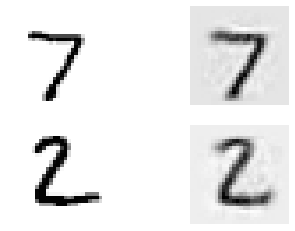

In [ ]:
n_test_digits = 2
X_test = mnist.test.images[:n_test_digits]

with tf.Session() as sess:
    saver.restore(sess, "./my_model_one_at_a_time.ckpt") # not shown in the book
    outputs_val = outputs.eval(feed_dict={X: X_test})

def plot_image(image, shape=[28, 28]):
    plt.imshow(image.reshape(shape), cmap="Greys", interpolation="nearest")
    plt.axis("off")

for digit_index in range(n_test_digits):
    plt.subplot(n_test_digits, 2, digit_index * 2 + 1)
    plot_image(X_test[digit_index])
    plt.subplot(n_test_digits, 2, digit_index * 2 + 2)
    plot_image(outputs_val[digit_index])

### Visualizando as Características

Para cada neurônio na primeira camada oculta é possível criar uma 
imagem cuja intensidade de um pixel corresponde ao peso da conexão com o mesmo neurônio. 
Por exemplo, o código a seguir mapeia as características aprendidas por cinco neurônios na 
primeira camada oculta:

INFO:tensorflow:Restoring parameters from ./my_model_one_at_a_time.ckpt
Saving figure extracted_features_plot


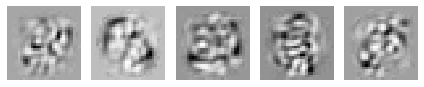

In [ ]:
with tf.Session() as sess:
    saver.restore(sess, "./my_model_one_at_a_time.ckpt") # not shown in the book
    weights1_val = weights1.eval()

for i in range(5):
    plt.subplot(1, 5, i + 1)
    plot_image(weights1_val.T[i])

save_fig("extracted_features_plot") # not shown
plt.show()                          # not shown

## Pré-treinamento Não Supervisionado

Vamos criar uma pequena rede neural para classificação MNIST:


In [ ]:
reset_graph()

n_inputs = 28 * 28
n_hidden1 = 300
n_hidden2 = 150
n_outputs = 10

learning_rate = 0.01
l2_reg = 0.0005

activation = tf.nn.elu
regularizer = tf.contrib.layers.l2_regularizer(l2_reg)
initializer = tf.contrib.layers.variance_scaling_initializer()

X = tf.placeholder(tf.float32, shape=[None, n_inputs])
y = tf.placeholder(tf.int32, shape=[None])

weights1_init = initializer([n_inputs, n_hidden1])
weights2_init = initializer([n_hidden1, n_hidden2])
weights3_init = initializer([n_hidden2, n_outputs])

weights1 = tf.Variable(weights1_init, dtype=tf.float32, name="weights1")
weights2 = tf.Variable(weights2_init, dtype=tf.float32, name="weights2")
weights3 = tf.Variable(weights3_init, dtype=tf.float32, name="weights3")

biases1 = tf.Variable(tf.zeros(n_hidden1), name="biases1")
biases2 = tf.Variable(tf.zeros(n_hidden2), name="biases2")
biases3 = tf.Variable(tf.zeros(n_outputs), name="biases3")

hidden1 = activation(tf.matmul(X, weights1) + biases1)
hidden2 = activation(tf.matmul(hidden1, weights2) + biases2)
logits = tf.matmul(hidden2, weights3) + biases3

cross_entropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
reg_loss = regularizer(weights1) + regularizer(weights2) + regularizer(weights3)
loss = cross_entropy + reg_loss
optimizer = tf.train.AdamOptimizer(learning_rate)
training_op = optimizer.minimize(loss)

correct = tf.nn.in_top_k(logits, y, 1)
accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))

init = tf.global_variables_initializer()
pretrain_saver = tf.train.Saver([weights1, weights2, biases1, biases2])
saver = tf.train.Saver()

Treinamento regular (sem pré-treinamento):


In [ ]:
n_epochs = 4
batch_size = 150
n_labeled_instances = 20000

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        n_batches = n_labeled_instances // batch_size
        for iteration in range(n_batches):
            print("\r{}%".format(100 * iteration // n_batches), end="")
            sys.stdout.flush()
            indices = rnd.permutation(n_labeled_instances)[:batch_size]
            X_batch, y_batch = mnist.train.images[indices], mnist.train.labels[indices]
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        print("\r{}".format(epoch), "Train accuracy:", accuracy_val, end=" ")
        saver.save(sess, "./my_model_supervised.ckpt")
        accuracy_val = accuracy.eval(feed_dict={X: mnist.test.images, y: mnist.test.labels})
        print("Test accuracy:", accuracy_val)

0 Train accuracy: 0.92 Test accuracy: 0.9076
1 Train accuracy: 0.94666666 Test accuracy: 0.9418
2 Train accuracy: 0.96666664 Test accuracy: 0.9393
3 Train accuracy: 0.9866667 Test accuracy: 0.9306


Agora, reutilizando as duas primeiras camadas do autoencoder que pré-treinamos:


In [ ]:
n_epochs = 4
batch_size = 150
n_labeled_instances = 20000

#training_op = optimizer.minimize(loss, var_list=[weights3, biases3])  # Freeze layers 1 and 2 (optional)

with tf.Session() as sess:
    init.run()
    pretrain_saver.restore(sess, "./my_model_cache_frozen.ckpt")
    for epoch in range(n_epochs):
        n_batches = n_labeled_instances // batch_size
        for iteration in range(n_batches):
            print("\r{}%".format(100 * iteration // n_batches), end="")
            sys.stdout.flush()
            indices = rnd.permutation(n_labeled_instances)[:batch_size]
            X_batch, y_batch = mnist.train.images[indices], mnist.train.labels[indices]
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        accuracy_val = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        print("\r{}".format(epoch), "Train accuracy:", accuracy_val, end="\t")
        saver.save(sess, "./my_model_supervised_pretrained.ckpt")
        accuracy_val = accuracy.eval(feed_dict={X: mnist.test.images, y: mnist.test.labels})
        print("Test accuracy:", accuracy_val)

INFO:tensorflow:Restoring parameters from ./my_model_cache_frozen.ckpt
0 Train accuracy: 0.94666666	Test accuracy: 0.923
1 Train accuracy: 0.9533333	Test accuracy: 0.9238
2 Train accuracy: 0.97333336	Test accuracy: 0.9399
3 Train accuracy: 0.98	Test accuracy: 0.9399


## Autoencoders de Remoção de Ruídos


**Nota: **o livro usa `tf.contrib.layers.dropout()` ao invés de `tf.layers.dropout()` (que não existia quando este capítulo foi escrito). Agora é preferível usar `tf.layers.dropout()`, porque qualquer coisa no módulo contrib pode ser alterada ou excluída sem aviso prévio. A função `tf.layers.dropout()` é quase idêntica à função `tf.contrib.layers.dropout()`, exceto por algumas pequenas diferenças. Mais importante:



* você deve especificar a taxa de abandono (`rate`) em vez da probabilidade de manutenção (`keep_prob`), onde `rate` é simplesmente igual a `1 - keep_prob`,
* o parâmetro `is_training` foi renomeado para `training`.

Usando ruído Gaussiano:


In [ ]:
reset_graph()

n_inputs = 28 * 28
n_hidden1 = 300
n_hidden2 = 150  # codings
n_hidden3 = n_hidden1
n_outputs = n_inputs

learning_rate = 0.01

É como treinar um autoencoder regular, 
mas você adiciona ruído às entradas e a perda de reconstrução é calculada com base 
nas entradas originais:

In [ ]:
noise_level = 1.0

X = tf.placeholder(tf.float32, shape=[None, n_inputs])
X_noisy = X + noise_level * tf.random_normal(tf.shape(X))

hidden1 = tf.layers.dense(X_noisy, n_hidden1, activation=tf.nn.relu,
                          name="hidden1")
hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=tf.nn.relu, # not shown in the book
                          name="hidden2")                            # not shown
hidden3 = tf.layers.dense(hidden2, n_hidden3, activation=tf.nn.relu, # not shown
                          name="hidden3")                            # not shown
outputs = tf.layers.dense(hidden3, n_outputs, name="outputs")        # not shown

reconstruction_loss = tf.reduce_mean(tf.square(outputs - X)) # MSE

In [ ]:
optimizer = tf.train.AdamOptimizer(learning_rate)
training_op = optimizer.minimize(reconstruction_loss)
    
init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
n_epochs = 10
batch_size = 150

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        n_batches = mnist.train.num_examples // batch_size
        for iteration in range(n_batches):
            print("\r{}%".format(100 * iteration // n_batches), end="")
            sys.stdout.flush()
            X_batch, y_batch = mnist.train.next_batch(batch_size)
            sess.run(training_op, feed_dict={X: X_batch})
        loss_train = reconstruction_loss.eval(feed_dict={X: X_batch})
        print("\r{}".format(epoch), "Train MSE:", loss_train)
        saver.save(sess, "./my_model_stacked_denoising_gaussian.ckpt")

0 Train MSE: 0.044002086
1 Train MSE: 0.043245282
2 Train MSE: 0.041218203
3 Train MSE: 0.040499676
4 Train MSE: 0.041683596
5 Train MSE: 0.039764594
6 Train MSE: 0.039729685
7 Train MSE: 0.04079272
8 Train MSE: 0.04013142
9 Train MSE: 0.04185616


Usando o dropout:


In [ ]:
reset_graph()

n_inputs = 28 * 28
n_hidden1 = 300
n_hidden2 = 150  # codings
n_hidden3 = n_hidden1
n_outputs = n_inputs

learning_rate = 0.01

In [ ]:
dropout_rate = 0.3

training = tf.placeholder_with_default(False, shape=(), name='training')

X = tf.placeholder(tf.float32, shape=[None, n_inputs])
X_drop = tf.layers.dropout(X, dropout_rate, training=training)

hidden1 = tf.layers.dense(X_drop, n_hidden1, activation=tf.nn.relu,
                          name="hidden1")
hidden2 = tf.layers.dense(hidden1, n_hidden2, activation=tf.nn.relu, # not shown in the book
                          name="hidden2")                            # not shown
hidden3 = tf.layers.dense(hidden2, n_hidden3, activation=tf.nn.relu, # not shown
                          name="hidden3")                            # not shown
outputs = tf.layers.dense(hidden3, n_outputs, name="outputs")        # not shown

reconstruction_loss = tf.reduce_mean(tf.square(outputs - X)) # MSE

Instructions for updating:
Use keras.layers.dropout instead.


In [ ]:
optimizer = tf.train.AdamOptimizer(learning_rate)
training_op = optimizer.minimize(reconstruction_loss)
    
init = tf.global_variables_initializer()
saver = tf.train.Saver()

Durante o treinamento, devemos configurar training para True (como explicado no 
Capítulo 11) utilizando o feed_dict:


`sess.run(training_op, feed_dict={X: X_batch, training: True})`


Durante o teste, não é necessário configurar training para False, já que definimos isto 
como padrão na chamada para a função `placeholder_with_default()`.

In [ ]:
n_epochs = 10
batch_size = 150

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        n_batches = mnist.train.num_examples // batch_size
        for iteration in range(n_batches):
            print("\r{}%".format(100 * iteration // n_batches), end="")
            sys.stdout.flush()
            X_batch, y_batch = mnist.train.next_batch(batch_size)
            sess.run(training_op, feed_dict={X: X_batch, training: True})
        loss_train = reconstruction_loss.eval(feed_dict={X: X_batch})
        print("\r{}".format(epoch), "Train MSE:", loss_train)
        saver.save(sess, "./my_model_stacked_denoising_dropout.ckpt")

0 Train MSE: 0.027357638
1 Train MSE: 0.025612302
2 Train MSE: 0.024029154
3 Train MSE: 0.024632564
4 Train MSE: 0.02219624
5 Train MSE: 0.023656176
6 Train MSE: 0.022224046
7 Train MSE: 0.022703089
8 Train MSE: 0.022928625
9 Train MSE: 0.022474162


INFO:tensorflow:Restoring parameters from ./my_model_stacked_denoising_dropout.ckpt


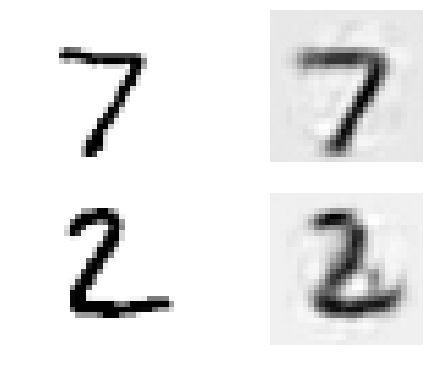

In [ ]:
show_reconstructed_digits(X, outputs, "./my_model_stacked_denoising_dropout.ckpt")

## Autoencoders Esparsos

Saving figure sparsity_loss_plot


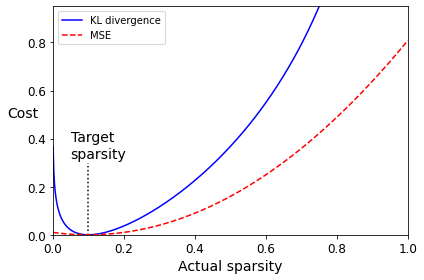

In [ ]:
p = 0.1
q = np.linspace(0.001, 0.999, 500)
kl_div = p * np.log(p / q) + (1 - p) * np.log((1 - p) / (1 - q))
mse = (p - q)**2
plt.plot([p, p], [0, 0.3], "k:")
plt.text(0.05, 0.32, "Target\nsparsity", fontsize=14)
plt.plot(q, kl_div, "b-", label="KL divergence")
plt.plot(q, mse, "r--", label="MSE")
plt.legend(loc="upper left")
plt.xlabel("Actual sparsity")
plt.ylabel("Cost", rotation=0)
plt.axis([0, 1, 0, 0.95])
save_fig("sparsity_loss_plot")

In [ ]:
reset_graph()

n_inputs = 28 * 28
n_hidden1 = 1000  # sparse codings
n_outputs = n_inputs

In [ ]:
def kl_divergence(p, q):
    # Kullback Leibler divergence
    return p * tf.log(p / q) + (1 - p) * tf.log((1 - p) / (1 - q))

learning_rate = 0.01
sparsity_target = 0.1
sparsity_weight = 0.2

X = tf.placeholder(tf.float32, shape=[None, n_inputs])            # not shown in the book

hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.sigmoid) # not shown
outputs = tf.layers.dense(hidden1, n_outputs)                     # not shown

hidden1_mean = tf.reduce_mean(hidden1, axis=0) # batch mean
sparsity_loss = tf.reduce_sum(kl_divergence(sparsity_target, hidden1_mean))
reconstruction_loss = tf.reduce_mean(tf.square(outputs - X)) # MSE
loss = reconstruction_loss + sparsity_weight * sparsity_loss

optimizer = tf.train.AdamOptimizer(learning_rate)
training_op = optimizer.minimize(loss)

In [ ]:
init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
n_epochs = 100
batch_size = 1000

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        n_batches = mnist.train.num_examples // batch_size
        for iteration in range(n_batches):
            print("\r{}%".format(100 * iteration // n_batches), end="")
            sys.stdout.flush()
            X_batch, y_batch = mnist.train.next_batch(batch_size)
            sess.run(training_op, feed_dict={X: X_batch})
        reconstruction_loss_val, sparsity_loss_val, loss_val = sess.run([reconstruction_loss, sparsity_loss, loss], feed_dict={X: X_batch})
        print("\r{}".format(epoch), "Train MSE:", reconstruction_loss_val, "\tSparsity loss:", sparsity_loss_val, "\tTotal loss:", loss_val)
        saver.save(sess, "./my_model_sparse.ckpt")

0 Train MSE: 0.12666322 	Sparsity loss: 0.19089228 	Total loss: 0.16484168
1 Train MSE: 0.05909176 	Sparsity loss: 0.01178915 	Total loss: 0.06144959
2 Train MSE: 0.052573323 	Sparsity loss: 0.06309222 	Total loss: 0.06519177
3 Train MSE: 0.047684476 	Sparsity loss: 0.009568557 	Total loss: 0.049598187
4 Train MSE: 0.043891862 	Sparsity loss: 0.053229336 	Total loss: 0.05453773
5 Train MSE: 0.041435514 	Sparsity loss: 0.01455592 	Total loss: 0.044346698
6 Train MSE: 0.03847766 	Sparsity loss: 0.008200348 	Total loss: 0.04011773
7 Train MSE: 0.03689117 	Sparsity loss: 0.17089714 	Total loss: 0.0710706
8 Train MSE: 0.032015424 	Sparsity loss: 0.10586896 	Total loss: 0.053189218
9 Train MSE: 0.030402808 	Sparsity loss: 0.044012547 	Total loss: 0.039205316
10 Train MSE: 0.027979467 	Sparsity loss: 0.17646909 	Total loss: 0.06327328
11 Train MSE: 0.02640052 	Sparsity loss: 0.04244394 	Total loss: 0.034889307
12 Train MSE: 0.024497679 	Sparsity loss: 0.127201 	Total loss: 0.04993788
13 Train

INFO:tensorflow:Restoring parameters from ./my_model_sparse.ckpt


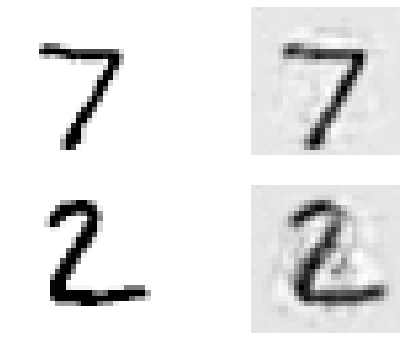

In [ ]:
show_reconstructed_digits(X, outputs, "./my_model_sparse.ckpt")

Observe que a camada de codificação deve gerar valores de 0 a 1, razão pela qual usamos a função de ativação sigmóide:


In [ ]:
hidden1 = tf.layers.dense(X, n_hidden1, activation=tf.nn.sigmoid)

Para acelerar o treinamento, você pode normalizar as entradas entre 0 e 1 e usar a entropia cruzada em vez do MSE para a função de custo. A função do TensorFlow `sigmoid_cross_entropy_with_logits()` cuida de aplicar eficientemente a função de 
ativação logística (sigmoide) às saídas e calcular a entropia cruzada:


In [ ]:
logits = tf.layers.dense(hidden1, n_outputs)
outputs = tf.nn.sigmoid(logits)

xentropy = tf.nn.sigmoid_cross_entropy_with_logits(labels=X, logits=logits)
reconstruction_loss = tf.reduce_mean(xentropy)

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


## Autoencoders Variacionais

In [ ]:
reset_graph()

from functools import partial

n_inputs = 28 * 28
n_hidden1 = 500
n_hidden2 = 500
n_hidden3 = 20  # codings
n_hidden4 = n_hidden2
n_hidden5 = n_hidden1
n_outputs = n_inputs
learning_rate = 0.001

initializer = tf.contrib.layers.variance_scaling_initializer()

my_dense_layer = partial(
    tf.layers.dense,
    activation=tf.nn.elu,
    kernel_initializer=initializer)

X = tf.placeholder(tf.float32, [None, n_inputs])
hidden1 = my_dense_layer(X, n_hidden1)
hidden2 = my_dense_layer(hidden1, n_hidden2)
hidden3_mean = my_dense_layer(hidden2, n_hidden3, activation=None)
hidden3_sigma = my_dense_layer(hidden2, n_hidden3, activation=None)
noise = tf.random_normal(tf.shape(hidden3_sigma), dtype=tf.float32)
hidden3 = hidden3_mean + hidden3_sigma * noise
hidden4 = my_dense_layer(hidden3, n_hidden4)
hidden5 = my_dense_layer(hidden4, n_hidden5)
logits = my_dense_layer(hidden5, n_outputs, activation=None)
outputs = tf.sigmoid(logits)

xentropy = tf.nn.sigmoid_cross_entropy_with_logits(labels=X, logits=logits)
reconstruction_loss = tf.reduce_sum(xentropy)

In [ ]:
eps = 1e-10 # smoothing term to avoid computing log(0) which is NaN
latent_loss = 0.5 * tf.reduce_sum(
    tf.square(hidden3_sigma) + tf.square(hidden3_mean)
    - 1 - tf.log(eps + tf.square(hidden3_sigma)))

In [ ]:
loss = reconstruction_loss + latent_loss

optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [ ]:
n_epochs = 50
batch_size = 150

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        n_batches = mnist.train.num_examples // batch_size
        for iteration in range(n_batches):
            print("\r{}%".format(100 * iteration // n_batches), end="")
            sys.stdout.flush()
            X_batch, y_batch = mnist.train.next_batch(batch_size)
            sess.run(training_op, feed_dict={X: X_batch})
        loss_val, reconstruction_loss_val, latent_loss_val = sess.run([loss, reconstruction_loss, latent_loss], feed_dict={X: X_batch})
        print("\r{}".format(epoch), "Train total loss:", loss_val, "\tReconstruction loss:", reconstruction_loss_val, "\tLatent loss:", latent_loss_val)
        saver.save(sess, "./my_model_variational.ckpt")

0 Train total loss: 34370.832 	Reconstruction loss: 24085.049 	Latent loss: 10285.784
1 Train total loss: 26118.504 	Reconstruction loss: 21368.152 	Latent loss: 4750.352
2 Train total loss: 28556.285 	Reconstruction loss: 22850.396 	Latent loss: 5705.8896
3 Train total loss: 30933.479 	Reconstruction loss: 26776.645 	Latent loss: 4156.834
4 Train total loss: 24248.078 	Reconstruction loss: 19725.424 	Latent loss: 4522.6553
5 Train total loss: 18290.098 	Reconstruction loss: 15665.338 	Latent loss: 2624.7603
6 Train total loss: 18143.525 	Reconstruction loss: 15188.556 	Latent loss: 2954.9695
7 Train total loss: 17180.46 	Reconstruction loss: 14268.104 	Latent loss: 2912.3584
8 Train total loss: 17308.598 	Reconstruction loss: 14255.65 	Latent loss: 3052.9482
9 Train total loss: 16659.844 	Reconstruction loss: 13491.857 	Latent loss: 3167.986
10 Train total loss: 16552.492 	Reconstruction loss: 13284.121 	Latent loss: 3268.3716
11 Train total loss: 16583.81 	Reconstruction loss: 13412.

O código a seguir constrói o autoencoder variacional
utilizando a variante *log(σ2
)*:

In [ ]:
reset_graph()

from functools import partial

n_inputs = 28 * 28
n_hidden1 = 500
n_hidden2 = 500
n_hidden3 = 20  # codings
n_hidden4 = n_hidden2
n_hidden5 = n_hidden1
n_outputs = n_inputs
learning_rate = 0.001

initializer = tf.contrib.layers.variance_scaling_initializer()
my_dense_layer = partial(
    tf.layers.dense,
    activation=tf.nn.elu,
    kernel_initializer=initializer)

X = tf.placeholder(tf.float32, [None, n_inputs])
hidden1 = my_dense_layer(X, n_hidden1)
hidden2 = my_dense_layer(hidden1, n_hidden2)
hidden3_mean = my_dense_layer(hidden2, n_hidden3, activation=None)
hidden3_gamma = my_dense_layer(hidden2, n_hidden3, activation=None)
noise = tf.random_normal(tf.shape(hidden3_gamma), dtype=tf.float32)
hidden3 = hidden3_mean + tf.exp(0.5 * hidden3_gamma) * noise
hidden4 = my_dense_layer(hidden3, n_hidden4)
hidden5 = my_dense_layer(hidden4, n_hidden5)
logits = my_dense_layer(hidden5, n_outputs, activation=None)
outputs = tf.sigmoid(logits)

xentropy = tf.nn.sigmoid_cross_entropy_with_logits(labels=X, logits=logits)
reconstruction_loss = tf.reduce_sum(xentropy)
latent_loss = 0.5 * tf.reduce_sum(
    tf.exp(hidden3_gamma) + tf.square(hidden3_mean) - 1 - hidden3_gamma)
loss = reconstruction_loss + latent_loss

optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

### Gerando Dígitos

Vamos treinar o modelo e gerar alguns dígitos aleatórios. Precisamos apenas treinar o modelo, amostrar códigos aleatórios 
de uma distribuição Gaussiana e decodificá-los:


In [ ]:
import numpy as np

n_digits = 60
n_epochs = 50
batch_size = 150

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        n_batches = mnist.train.num_examples // batch_size
        for iteration in range(n_batches):
            print("\r{}%".format(100 * iteration // n_batches), end="") # not shown in the book
            sys.stdout.flush()                                          # not shown
            X_batch, y_batch = mnist.train.next_batch(batch_size)
            sess.run(training_op, feed_dict={X: X_batch})
        loss_val, reconstruction_loss_val, latent_loss_val = sess.run([loss, reconstruction_loss, latent_loss], feed_dict={X: X_batch}) # not shown
        print("\r{}".format(epoch), "Train total loss:", loss_val, "\tReconstruction loss:", reconstruction_loss_val, "\tLatent loss:", latent_loss_val)  # not shown
        saver.save(sess, "./my_model_variational.ckpt")  # not shown
    
    codings_rnd = np.random.normal(size=[n_digits, n_hidden3])
    outputs_val = outputs.eval(feed_dict={hidden3: codings_rnd})

0 Train total loss: 17933.027 	Reconstruction loss: 14215.826 	Latent loss: 3717.2007
1 Train total loss: 17455.27 	Reconstruction loss: 13649.984 	Latent loss: 3805.2847
2 Train total loss: 16269.673 	Reconstruction loss: 12487.32 	Latent loss: 3782.3525
3 Train total loss: 16213.9 	Reconstruction loss: 12481.599 	Latent loss: 3732.302
4 Train total loss: 16099.045 	Reconstruction loss: 12294.029 	Latent loss: 3805.0156
5 Train total loss: 16149.363 	Reconstruction loss: 12401.33 	Latent loss: 3748.0332
6 Train total loss: 16505.367 	Reconstruction loss: 12617.979 	Latent loss: 3887.3877
7 Train total loss: 15730.742 	Reconstruction loss: 11985.993 	Latent loss: 3744.749
8 Train total loss: 16057.308 	Reconstruction loss: 12233.609 	Latent loss: 3823.698
9 Train total loss: 15719.806 	Reconstruction loss: 11930.211 	Latent loss: 3789.5945
10 Train total loss: 15874.049 	Reconstruction loss: 12119.518 	Latent loss: 3754.5308
11 Train total loss: 16322.968 	Reconstruction loss: 12400.82

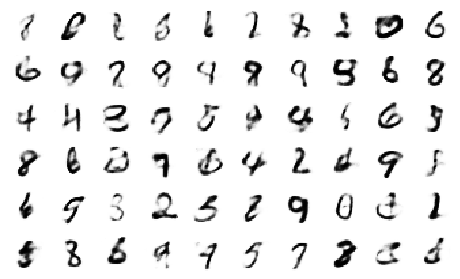

In [ ]:
plt.figure(figsize=(8,50)) # not shown in the book
for iteration in range(n_digits):
    plt.subplot(n_digits, 10, iteration + 1)
    plot_image(outputs_val[iteration])

Saving figure generated_digits_plot


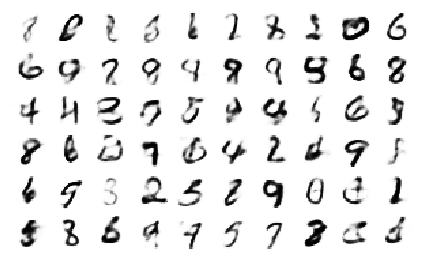

In [ ]:
n_rows = 6
n_cols = 10
plot_multiple_images(outputs_val.reshape(-1, 28, 28), n_rows, n_cols)
save_fig("generated_digits_plot")
plt.show()

Observe que a perda latente é calculada de forma diferente nesta segunda variante:


In [ ]:
latent_loss = 0.5 * tf.reduce_sum(
    tf.exp(hidden3_gamma) + tf.square(hidden3_mean) - 1 - hidden3_gamma)

### Outros Autoencoders 
Encode & Decode

Encode:

In [ ]:
n_digits = 3
X_test, y_test = mnist.test.next_batch(batch_size)
codings = hidden3

with tf.Session() as sess:
    saver.restore(sess, "./my_model_variational.ckpt")
    codings_val = codings.eval(feed_dict={X: X_test})

INFO:tensorflow:Restoring parameters from ./my_model_variational.ckpt


Decode:

In [ ]:
with tf.Session() as sess:
    saver.restore(sess, "./my_model_variational.ckpt")
    outputs_val = outputs.eval(feed_dict={codings: codings_val})

INFO:tensorflow:Restoring parameters from ./my_model_variational.ckpt


Vamos plotar as reconstruções:


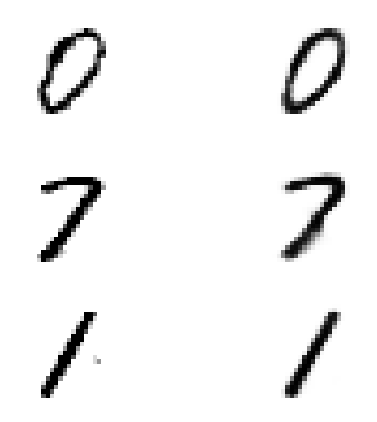

In [ ]:
fig = plt.figure(figsize=(8, 2.5 * n_digits))
for iteration in range(n_digits):
    plt.subplot(n_digits, 2, 1 + 2 * iteration)
    plot_image(X_test[iteration])
    plt.subplot(n_digits, 2, 2 + 2 * iteration)
    plot_image(outputs_val[iteration])

### Interpolar dígitos


INFO:tensorflow:Restoring parameters from ./my_model_variational.ckpt


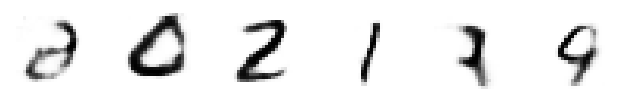

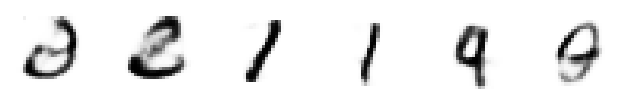

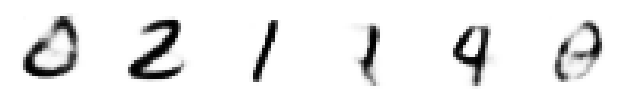

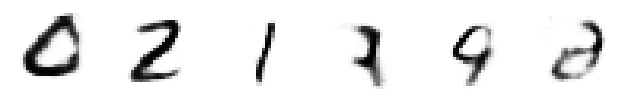

In [ ]:
n_iterations = 3
n_digits = 6
codings_rnd = np.random.normal(size=[n_digits, n_hidden3])

with tf.Session() as sess:
    saver.restore(sess, "./my_model_variational.ckpt")
    target_codings = np.roll(codings_rnd, -1, axis=0)
    for iteration in range(n_iterations + 1):
        codings_interpolate = codings_rnd + (target_codings - codings_rnd) * iteration / n_iterations
        outputs_val = outputs.eval(feed_dict={codings: codings_interpolate})
        plt.figure(figsize=(11, 1.5*n_iterations))
        for digit_index in range(n_digits):
            plt.subplot(1, n_digits, digit_index + 1)
            plot_image(outputs_val[digit_index])
        plt.show()

# Capítulo 16

Aprendizado por Reforço

## Setup

Primeiro, vamos garantir que este notebook funcione bem em python 2 e 3, importe alguns módulos comuns, assegure-se de que o MatplotLib plote as figuras inline e prepare uma função para salvar as figuras:


In [ ]:
import numpy as np
import os
import sklearn
import sys

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 1.x
    !apt update && apt install -y libpq-dev libsdl2-dev swig xorg-dev xvfb
    !pip install -q -U pyvirtualdisplay gym[atari,box2d]
    IS_COLAB = True
except Exception:
    IS_COLAB = False

# to make this notebook's output stable across runs
def reset_graph(seed=42):
    tf.reset_default_graph()
    tf.set_random_seed(seed)
    np.random.seed(seed)

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# To get smooth animations
import matplotlib.animation as animation
mpl.rc('animation', html='jshtml')

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "rl"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

Hit:1 http://archive.ubuntu.com/ubuntu bionic InRelease
Ign:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Get:3 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Ign:4 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Get:5 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease [15.9 kB]
Get:6 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release [696 B]
Hit:7 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Get:8 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release.gpg [836 B]
Get:9 http://archive.ubuntu.com/ubuntu bionic-backports InRelease [74.6 kB]
Get:10 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Get:11 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Hit:12 http://ppa.launchpad.net/cran/libgit2/u

In [ ]:
import urllib.request
urllib.request.urlretrieve('http://www.atarimania.com/roms/Roms.rar','Roms.rar')
!pip install unrar
!unrar x Roms.rar
!mkdir rars
!mv HC\ ROMS.zip   rars
!mv ROMS.zip  rars
!python -m atari_py.import_roms rars

A saída de streaming foi truncada nas últimas 5000 linhas.
Extracting  ROMS/Air-Sea Battle - Air Sea Battle (Anti-Aircraft) (1977) (Atari, Larry Kaplan) (CX2602, CX2602P) (PAL).bin       1%  OK 
Extracting  ROMS/Air-Sea Battle - Air Sea Battle - Target Fun (Anti-Aircraft) (1977) (Atari, Larry Kaplan - Sears) (CX2602 - 99802, 6-99802, 49-75102) ~.bin       1%  OK 
Extracting  ROMS/Airlock (1982) (Data Age) (DA1004) (Prototype).bin        1%  OK 
Extracting  ROMS/Airlock (1982) (Data Age) (DA1004) ~.bin                  1%  OK 
Extracting  ROMS/Airlock (1983) (Gameworld) (133-004) (PAL).bin            1%  OK 
Extracting  ROMS/Alices Abenteuer - Lilly Adventure (1983) (Quelle - Otto Versand) (732.273 8 - 600273, 781644) (PAL).bin       1%  OK 
Extracting  ROMS/Alien (1982) (20th Century Fox Video Games, Douglas 'Dallas North' Neubauer) (11006) ~.bin       1%  OK 
Extracting  ROMS/Alien (CCE).bin                                

**Observação**: pode haver pequenas diferenças entre a saída deste notebook e os exemplos mostrados no livro. Você pode ignorar com segurança essas diferenças. Devem-se principalmente ao fato de que a maioria dos ambientes disponibilizados pela academia OpenAI possuem alguma aleatoriedade.


## Introdução ao OpenAI Gym



> A OpenAI é uma empresa de pesquisa de inteligência artificial sem fins lucrativos financiada em parte por 
Elon Musk. Seu objetivo declarado é promover e desenvolver IAs amigáveis que beneficiem a humanidade 
(em vez de exterminá-la).



Neste notebook, usaremos o [Academia OpenAI](https://gym.openai.com/), um ótimo kit de ferramentas (que fornece uma 
ampla variedade de ambientes simulados (jogos de Atari, jogos de tabuleiro, simulações 
físicas em 2D e 3D e assim por diante) ) para desenvolver e comparar algoritmos de Aprendizado por Reforço. Ele fornece muitos ambientes para seus *agentes* de aprendizagem interagirem. Vamos começar importando `gym`:




In [ ]:
import gym


Para importar ROMS, você precisa baixar Roms.rar da coleção de [ROMs do Atari 2600 VCS](http://www.atarimania.com/rom_collection_archive_atari_2600_roms.html) e extrair o arquivo `.rar`. Feito isso, execute:

`python -m atari_py.import_roms <caminho para a pasta>`

Isso deve imprimir os nomes das ROMs à medida que as importa. As ROMs serão copiadas para o diretório de instalação do` atari_py`.

In [ ]:
python -m atari_py.import_roms <C:\Users\Marina\Downloads\Roms>

SyntaxError: ignored

Em seguida carregaremos o ambiente MsPacman, versão 0. 


A função` make() `cria um ambiente, neste caso um ambiente CartPole. Esta é uma simulação 2D na qual um carrinho pode ser acelerado para a esquerda ou para a direita 
a fim de equilibrar um bastão posicionado sobre ele.


In [ ]:
env = gym.make('MsPacman-v0')

Exception: ignored

Vamos inicializar o ambiente chamando o método `reset()`. Isso retorna uma observação. As observações dependem do tipo de ambiente, cada uma delas é 
um array 1D NumPy que contém quatro floats para o ambiente CartPole: esses floats 
representam a posição horizontal do carrinho (0.0 = centro), sua velocidade, o ângulo do 
bastão (0.0 = vertical) e sua velocidade angular.


In [ ]:
env.seed(42)
obs = env.reset()

As observações variam de acordo com o ambiente. Neste caso é uma imagem RGB representada como um array NumPy 3D de forma [largura, altura, canais] (com 3 canais: Vermelho, Verde e Azul). Em outros ambientes pode retornar objetos diferentes, como veremos mais adiante.


In [ ]:
obs.shape

(210, 160, 3)

Um ambiente pode ser visualizado chamando seu método `render()`, e você pode escolher o modo de renderização (as opções de renderização dependem do ambiente).


**Aviso**: alguns ambientes requerem acesso ao seu monitor, que abre uma janela separada, mesmo se você especificar `mode="rgb_array"`. Em geral, você pode ignorar com segurança essa janela. No entanto, se o Jupyter estiver sendo executado em um servidor headless (ou seja, sem uma tela), ele gerará uma exceção. Uma maneira de evitar isso é instalar um servidor X falso como [Xvfb](http://en.wikipedia.org/wiki/Xvfb). No Debian ou Ubuntu:


```bash
$ apt update
$ apt install -y xvfb
```

Você pode então iniciar o Jupyter usando o comando `xvfb-run`:

```bash
$ xvfb-run -s "-screen 0 1400x900x24" jupyter notebook
```

Alternativamente, você pode instalar a biblioteca Python [pyvirtualdisplay](https://github.com/ponty/pyvirtualdisplay) que envolve o Xvfb:

```bash
python3 -m pip install -U pyvirtualdisplay
```

E execute o seguinte código:


In [ ]:
try:
    import pyvirtualdisplay
    display = pyvirtualdisplay.Display(visible=0, size=(1400, 900)).start()
except ImportError:
    pass

In [ ]:
env.render()

Neste exemplo, definiremos `mode="rgb_array"` para obter uma imagem do ambiente como um array NumPy. 


Ajuste o parâmetro se quiser que `render() `retorne a imagem 
renderizada como um array NumPy (note que outros ambientes podem suportar diferentes modos):


In [ ]:
img = env.render(mode="rgb_array")
img.shape

Vamos plotar esta imagem:


In [ ]:
plt.figure(figsize=(5,4))
plt.imshow(img)
plt.axis("off")
save_fig("MsPacman")
plt.show()

Bem-vindo de volta aos anos 80! :)


Neste ambiente, a imagem renderizada é simplesmente igual à observação (mas em muitos ambientes este não é o caso):


In [ ]:
(img == obs).all()

Vamos criar uma pequena função auxiliar para plotar um ambiente:


In [ ]:
def plot_environment(env, figsize=(5,4)):
    plt.figure(figsize=figsize)
    img = env.render(mode="rgb_array")
    plt.imshow(img)
    plt.axis("off")

Vamos ver como interagir com um ambiente. Seu agente precisará selecionar uma ação de um "espaço de ação" (o conjunto de ações possíveis). Vamos ver como é o espaço de ação deste ambiente:


In [ ]:
env.action_space

`Discrete(9)` significa que as ações possíveis são inteiros de 0 a 8, que representam as 9 posições possíveis do joystick (0=centro, 1=cima, 2=direita, 3=esquerda, 4=baixo, 5=superior -direita, 6=superior esquerdo, 7=inferior direito, 8=inferior esquerdo).


Em seguida, precisamos informar ao ambiente qual ação jogar, e ele calculará a próxima etapa do jogo. Vamos para a esquerda por 110 passos, depois para a esquerda por 40 passos:


In [ ]:
env.seed(42)
env.reset()
for step in range(110):
    env.step(3) #left
for step in range(40):
    env.step(8) #lower-left

Onde estamos agora?


In [ ]:
plot_environment(env)
plt.show()

A função `step()` na verdade retorna vários objetos importantes:


In [ ]:
obs, reward, done, info = env.step(0)

A observação informa ao agente como é o ambiente, conforme discutido anteriormente. Esta é uma imagem RGB de 210x160:


In [ ]:
obs.shape

O ambiente também informa ao agente quanta recompensa ele recebeu durante a última etapa:


In [ ]:
reward

Quando o jogo termina, o ambiente retorna `done=True`:


In [ ]:
done

Finalmente, `info` é um dicionário específico do ambiente que pode fornecer algumas informações extras sobre o estado interno do ambiente. Isso é útil para depuração, mas seu agente não deve usar essas informações para aprendizado (seria trapacear).


In [ ]:
info

Vamos jogar um jogo completo (com 3 vidas), movendo-se em direções aleatórias por 10 passos de cada vez, gravando cada quadro:


In [ ]:
frames = []

n_max_steps = 1000
n_change_steps = 10

env.seed(42)
obs = env.reset()
for step in range(n_max_steps):
    img = env.render(mode="rgb_array")
    frames.append(img)
    if step % n_change_steps == 0:
        action = env.action_space.sample() # play randomly
    obs, reward, done, info = env.step(action)
    if done:
        break

Agora mostre a animação:


In [ ]:
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch,

def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

In [ ]:
plot_animation(frames)

Depois de terminar de jogar com um ambiente, você deve fechá-lo para liberar recursos:


In [ ]:
env.close()

Para codificar nosso primeiro agente de aprendizado, usaremos um ambiente mais simples: o Cart-Pole.


## Um ambiente simples: o Cart-Pole


O Cart-Pole é um ambiente muito simples composto por um carrinho que pode se mover para a esquerda ou para a direita, e um poste colocado verticalmente em cima dele. O agente deve mover o carrinho para a esquerda ou direita para manter o poste na posição vertical.


In [ ]:
env = gym.make("CartPole-v0")

In [ ]:
env.seed(42)
obs = env.reset()

In [ ]:
obs

A observação é uma matriz NumPy 1D composta por 4 flutuadores: eles representam a posição horizontal do carrinho, sua velocidade, o ângulo do poste (0 = vertical) e a velocidade angular. Vamos renderizar o ambiente...


In [ ]:
plot_environment(env)
plt.show()

Agora vamos olhar para o espaço de ação:


In [ ]:
env.action_space

Sim, apenas duas ações possíveis: acelerar para a esquerda ou para a direita. Vamos empurrar o carrinho para a esquerda até que o poste caia:


In [ ]:
env.seed(42)
obs = env.reset()
while True:
    obs, reward, done, info = env.step(0)
    if done:
        break

Saving figure cart_pole_plot


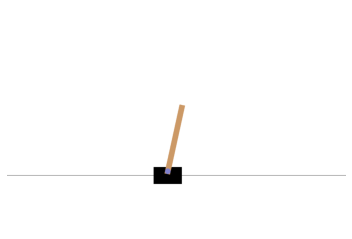

In [ ]:
plot_environment(env)
save_fig("cart_pole_plot")

In [ ]:
img.shape

(210, 160, 3)

Observe que o jogo acaba quando o mastro se inclina demais, não quando ele realmente cai. Agora vamos redefinir o ambiente e empurrar o carrinho para a direita:


In [ ]:
obs = env.reset()
while True:
    obs, reward, done, info = env.step(1)
    if done:
        break

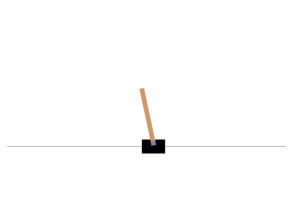

In [ ]:
plot_environment(env)
plt.show()

Parece que está fazendo o que estamos dizendo para fazer. Agora, como podemos fazer a enquete permanecer na vertical? 


Precisaremos definir uma _policy_ para isso. Essa é a estratégia que o agente usará para selecionar uma ação em cada etapa. Ele pode usar todas as ações e observações passadas para decidir o que fazer.


## Uma política simples codificada


Vamos codificar uma estratégia simples: se o poste estiver inclinado para a esquerda, empurre o carrinho para a esquerda e _vice-versa_. Vamos ver se isso funciona:


In [ ]:
frames = []

n_max_steps = 1000
n_change_steps = 10

env.seed(42)
obs = env.reset()
for step in range(n_max_steps):
    img = env.render(mode="rgb_array")
    frames.append(img)

    # hard-coded policy
    position, velocity, angle, angular_velocity = obs
    if angle < 0:
        action = 0
    else:
        action = 1

    obs, reward, done, info = env.step(action)
    if done:
        break

In [ ]:
plot_animation(frames)

Não, o sistema é instável e depois de apenas algumas oscilações, o poste acaba muito inclinado: game over. Precisamos ser mais espertos do que isso!


## Políticas de Rede Neural

Vamos criar uma rede neural que receberá observações como entradas e emitirá a ação a ser executada para cada observação. Para escolher uma ação, a rede primeiro estimará uma probabilidade para cada ação e, em seguida, selecionará uma ação aleatoriamente de acordo com as probabilidades estimadas. No caso do ambiente Cart-Pole, existem apenas duas ações possíveis (esquerda ou direita), então precisamos apenas de um neurônio de saída: ele produzirá a probabilidade `p` da ação 0 (esquerda) e, claro, o probabilidade da ação 1 (direita) será `1 - p`.

**Observação**: em vez de usar a função `full_connected()` do módulo `tensorflow.contrib.layers` (como no livro), agora usamos a função `dense()` do módulo `tf.layers` módulo, que não existia quando este capítulo foi escrito. Isso é preferível porque qualquer coisa no contrib pode ser alterada ou excluída sem aviso prévio, enquanto `tf.layers` faz parte da API oficial. Como você verá, o código é basicamente o mesmo.


As principais diferenças relevantes para este capítulo são:
* o sufixo `_fn` foi removido em todos os parâmetros que o possuíam (por exemplo, o parâmetro `activation_fn` foi renomeado para `activation`).
* o parâmetro `weights` foi renomeado para `kernel`,
* a ativação padrão é `None` em vez de `tf.nn.relu`

In [ ]:
import tensorflow as tf

# 1. Specify the network architecture
n_inputs = 4  # == env.observation_space.shape[0]
n_hidden = 4  # it's a simple task, we don't need more than this
n_outputs = 1 # only outputs the probability of accelerating left
initializer = tf.variance_scaling_initializer()

# 2. Build the neural network
X = tf.placeholder(tf.float32, shape=[None, n_inputs])
hidden = tf.layers.dense(X, n_hidden, activation=tf.nn.elu,
                         kernel_initializer=initializer)
outputs = tf.layers.dense(hidden, n_outputs, activation=tf.nn.sigmoid,
                          kernel_initializer=initializer)

# 3. Select a random action based on the estimated probabilities
p_left_and_right = tf.concat(axis=1, values=[outputs, 1 - outputs])
action = tf.multinomial(tf.log(p_left_and_right), num_samples=1)

init = tf.global_variables_initializer()

Instructions for updating:
Use keras.layers.Dense instead.
Instructions for updating:
Please use `layer.__call__` method instead.
Instructions for updating:
Use `tf.random.categorical` instead.


Nesse ambiente específico, as ações e observações passadas podem ser ignoradas com segurança, pois cada observação contém o estado completo do ambiente. Se houver algum estado oculto, talvez seja necessário considerar ações e observações passadas para tentar inferir o estado oculto do ambiente. Por exemplo, se o ambiente revelasse apenas a posição do carrinho, mas não sua velocidade, você teria que considerar não apenas a observação atual, mas também a observação anterior para estimar a velocidade atual. Outro exemplo é se as observações forem ruidosas: você pode querer usar as últimas observações para estimar o estado atual mais provável. Nosso problema é, portanto, o mais simples possível: a observação atual é livre de ruído e contém o estado completo do ambiente.

Você pode se perguntar por que estamos escolhendo uma ação aleatória com base na probabilidade dada pela rede de políticas, em vez de apenas escolher a ação com a maior probabilidade. Essa abordagem permite que o agente encontre o equilíbrio certo entre _explorar_ novas ações e _explorar_ as ações que funcionam bem. Aqui está uma analogia: suponha que você vá a um restaurante pela primeira vez e todos os pratos pareçam igualmente atraentes, então você escolhe um aleatoriamente. Se ficar bom, você pode aumentar a probabilidade de pedir na próxima vez, mas não deve aumentar essa probabilidade para 100%, ou então você nunca experimentará os outros pratos, alguns dos quais podem ser ainda melhores do que aquele que você tentou.

Vamos inicializar aleatoriamente esta rede neural de política e usá-la para jogar um jogo:


In [ ]:
n_max_steps = 1000
frames = []

with tf.Session() as sess:
    init.run()
    env.seed(42)
    obs = env.reset()
    for step in range(n_max_steps):
        img = env.render(mode="rgb_array")
        frames.append(img)
        action_val = action.eval(feed_dict={X: obs.reshape(1, n_inputs)})
        obs, reward, done, info = env.step(action_val[0][0])
        if done:
            break

env.close()

Agora vamos ver o desempenho dessa rede de políticas inicializada aleatoriamente:


In [ ]:
plot_animation(frames)

Sim... muito ruim. A rede neural terá que aprender a fazer melhor. Primeiro vamos ver se ele é capaz de aprender a política básica que usamos anteriormente: vá para a esquerda se o poste estiver inclinando para a esquerda e vá para a direita se estiver inclinando para a direita. O código a seguir define a mesma rede neural, mas adicionamos as probabilidades de destino `y` e as operações de treinamento (`cross_entropy`, `optimizer` e `training_op`):

In [ ]:
import tensorflow as tf

reset_graph()

n_inputs = 4
n_hidden = 4
n_outputs = 1

learning_rate = 0.01

initializer = tf.variance_scaling_initializer()

X = tf.placeholder(tf.float32, shape=[None, n_inputs])
y = tf.placeholder(tf.float32, shape=[None, n_outputs])

hidden = tf.layers.dense(X, n_hidden, activation=tf.nn.elu, kernel_initializer=initializer)
logits = tf.layers.dense(hidden, n_outputs)
outputs = tf.nn.sigmoid(logits) # probability of action 0 (left)
p_left_and_right = tf.concat(axis=1, values=[outputs, 1 - outputs])
action = tf.multinomial(tf.log(p_left_and_right), num_samples=1)

cross_entropy = tf.nn.sigmoid_cross_entropy_with_logits(labels=y, logits=logits)
optimizer = tf.train.AdamOptimizer(learning_rate)
training_op = optimizer.minimize(cross_entropy)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Vamos entender esse código:
1. Após as importações, definimos a arquitetura da rede neural. O número de entradas é o tamanho do espaço de observação (que no caso do CartPole é quatro), temos apenas quatro unidades ocultas e não há necessidade de mais, e temos apenas 
uma probabilidade de saída (a probabilidade de ir para a esquerda);
2. Em seguida, construímos a rede neural. Neste exemplo, é um perceptron normal 
de várias camadas com uma única saída. Observe que a camada de saída utiliza a 
função de ativação logística (sigmoide) para gerar uma probabilidade de 0,0 a 1,0. 
Se houvesse mais de duas ações possíveis, haveria um neurônio de saída por ação 
e você utilizaria a função de ativação do softmax;
3. Por fim, chamamos a função `multinomial()` para escolher uma ação aleatória. Esta 
função, dada a probabilidade de log de cada inteiro, amostra um (ou mais) inteiros. Por exemplo, se você a chamar com o array [np.log(0.5), np.log(0.2), 
np.log(0.3)] e com num_samples=5, ela produzirá cinco inteiros, cada um dos 
quais terá 50% de probabilidade de ser 0, 20% de ser 1 e 30% de ser 2. No nosso caso, precisamos apenas de um inteiro representando a ação a ser executada. 
Como o tensor outputs contém apenas a probabilidade de ir para a esquerda, devemos primeiro concatenar 1-outputs para que ele tenha um tensor que contenha 
a probabilidade de ambas as ações, esquerda e direita. Observe que, se houvesse 
mais de duas ações possíveis, a rede neural teria que gerar uma probabilidade por 
ação para que você não precisasse da etapa de concatenação.

Podemos fazer a mesma rede jogar em 10 ambientes diferentes em paralelo e treinar para 1000 iterações. Também redefinimos os ambientes quando eles são concluídos.


In [ ]:
n_environments = 10
n_iterations = 1000

envs = [gym.make("CartPole-v0") for _ in range(n_environments)]
observations = [env.reset() for env in envs]

with tf.Session() as sess:
    init.run()
    for iteration in range(n_iterations):
        target_probas = np.array([([1.] if obs[2] < 0 else [0.]) for obs in observations]) # if angle<0 we want proba(left)=1., or else proba(left)=0.
        action_val, _ = sess.run([action, training_op], feed_dict={X: np.array(observations), y: target_probas})
        for env_index, env in enumerate(envs):
            obs, reward, done, info = env.step(action_val[env_index][0])
            observations[env_index] = obs if not done else env.reset()
    saver.save(sess, "./my_policy_net_basic.ckpt")

for env in envs:
    env.close()

In [ ]:
def render_policy_net(model_path, action, X, n_max_steps=1000):
    frames = []
    env = gym.make("CartPole-v0")
    obs = env.reset()
    with tf.Session() as sess:
        saver.restore(sess, model_path)
        for step in range(n_max_steps):
            img = env.render(mode="rgb_array")
            frames.append(img)
            action_val = action.eval(feed_dict={X: obs.reshape(1, n_inputs)})
            obs, reward, done, info = env.step(action_val[0][0])
            if done:
                break
    env.close()
    return frames        

In [ ]:
frames = render_policy_net("./my_policy_net_basic.ckpt", action, X)
plot_animation(frames)

Parece que aprendeu a política corretamente. Agora vamos ver se ele pode aprender uma política melhor por conta própria.


## Gradientes de Política

Para treinar esta rede neural, precisaremos definir as probabilidades alvo `y`. Se uma ação é boa, devemos aumentar sua probabilidade e, inversamente, se é ruim, devemos reduzi-la. Mas como sabemos se uma ação é boa ou ruim? O problema é que a maioria das ações tem efeitos atrasados, então quando você ganha ou perde pontos em um jogo, não fica claro quais ações contribuíram para esse resultado: foi apenas a última ação? Ou os 10 últimos? Ou apenas uma ação 50 passos antes? Isso é chamado de _problema de atribuição de crédito_.


O algoritmo _Policy Gradients_ aborda esse problema primeiro jogando vários jogos e, em seguida, tornando as ações em bons jogos um pouco mais prováveis, enquanto as ações em jogos ruins são um pouco menos prováveis. Primeiro jogamos, depois voltamos e pensamos no que fizemos.

In [ ]:
import tensorflow as tf

reset_graph()

n_inputs = 4
n_hidden = 4
n_outputs = 1

learning_rate = 0.01

initializer = tf.variance_scaling_initializer()

X = tf.placeholder(tf.float32, shape=[None, n_inputs])

hidden = tf.layers.dense(X, n_hidden, activation=tf.nn.elu, kernel_initializer=initializer)
logits = tf.layers.dense(hidden, n_outputs)
outputs = tf.nn.sigmoid(logits)  # probability of action 0 (left)
p_left_and_right = tf.concat(axis=1, values=[outputs, 1 - outputs])
action = tf.multinomial(tf.log(p_left_and_right), num_samples=1)

y = 1. - tf.to_float(action)
cross_entropy = tf.nn.sigmoid_cross_entropy_with_logits(labels=y, logits=logits)
optimizer = tf.train.AdamOptimizer(learning_rate)
grads_and_vars = optimizer.compute_gradients(cross_entropy)
gradients = [grad for grad, variable in grads_and_vars]
gradient_placeholders = []
grads_and_vars_feed = []
for grad, variable in grads_and_vars:
    gradient_placeholder = tf.placeholder(tf.float32, shape=grad.get_shape())
    gradient_placeholders.append(gradient_placeholder)
    grads_and_vars_feed.append((gradient_placeholder, variable))
training_op = optimizer.apply_gradients(grads_and_vars_feed)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

Instructions for updating:
Use `tf.cast` instead.


Rumo à fase de execução! Dadas as recompensas cruas, precisaremos de algumas funções 
para calcular as recompensas totais com desconto na fase de execução, e normalizar os 
resultados em múltiplos episódios:

In [ ]:
def discount_rewards(rewards, discount_rate):
    discounted_rewards = np.zeros(len(rewards))
    cumulative_rewards = 0
    for step in reversed(range(len(rewards))):
        cumulative_rewards = rewards[step] + cumulative_rewards * discount_rate
        discounted_rewards[step] = cumulative_rewards
    return discounted_rewards

def discount_and_normalize_rewards(all_rewards, discount_rate):
    all_discounted_rewards = [discount_rewards(rewards, discount_rate) for rewards in all_rewards]
    flat_rewards = np.concatenate(all_discounted_rewards)
    reward_mean = flat_rewards.mean()
    reward_std = flat_rewards.std()
    return [(discounted_rewards - reward_mean)/reward_std for discounted_rewards in all_discounted_rewards]

In [ ]:
discount_rewards([10, 0, -50], discount_rate=0.8)

array([-22., -40., -50.])

In [ ]:
discount_and_normalize_rewards([[10, 0, -50], [10, 20]], discount_rate=0.8)

[array([-0.28435071, -0.86597718, -1.18910299]),
 array([1.26665318, 1.0727777 ])]

Temos agora tudo o que precisamos para treinar a política.

In [ ]:
env = gym.make("CartPole-v0")

n_games_per_update = 10
n_max_steps = 1000
n_iterations = 250
save_iterations = 10
discount_rate = 0.95

with tf.Session() as sess:
    init.run()
    for iteration in range(n_iterations):
        print("\rIteration: {}".format(iteration), end="")
        all_rewards = []
        all_gradients = []
        for game in range(n_games_per_update):
            current_rewards = []
            current_gradients = []
            obs = env.reset()
            for step in range(n_max_steps):
                action_val, gradients_val = sess.run([action, gradients], feed_dict={X: obs.reshape(1, n_inputs)})
                obs, reward, done, info = env.step(action_val[0][0])
                current_rewards.append(reward)
                current_gradients.append(gradients_val)
                if done:
                    break
            all_rewards.append(current_rewards)
            all_gradients.append(current_gradients)

        all_rewards = discount_and_normalize_rewards(all_rewards, discount_rate=discount_rate)
        feed_dict = {}
        for var_index, gradient_placeholder in enumerate(gradient_placeholders):
            mean_gradients = np.mean([reward * all_gradients[game_index][step][var_index]
                                      for game_index, rewards in enumerate(all_rewards)
                                          for step, reward in enumerate(rewards)], axis=0)
            feed_dict[gradient_placeholder] = mean_gradients
        sess.run(training_op, feed_dict=feed_dict)
        if iteration % save_iterations == 0:
            saver.save(sess, "./my_policy_net_pg.ckpt")

Iteration: 249

Cada iteração do treinamento começa executando a política de 10 episódios (com o 
máximo de 1 mil etapas por episódio, para evitar a execução para sempre). Também calculamos os gradientes em cada etapa fingindo que a ação escolhida foi a melhor. Depois 
que esses 10 episódios foram executados, calculamos as pontuações de ação usando a 
função `discount_and_normalize_rewards()`; passamos por cada variável treinável, em 
todos os episódios e passos, para multiplicar cada vetor gradiente por sua ação de pontuação correspondente, e calculamos a média dos gradientes resultantes.


Finalmente, 
executamos a operação de treinamento alimentando esses gradientes médios (um por 
variável treinável). Também salvamos o modelo a cada 10 operações de treinamento.

In [ ]:
env.close()

In [ ]:
frames = render_policy_net("./my_policy_net_pg.ckpt", action, X, n_max_steps=1000)
plot_animation(frames)

## Cadeias de Markov.

In [ ]:
transition_probabilities = [
        [0.7, 0.2, 0.0, 0.1],  # from s0 to s0, s1, s2, s3
        [0.0, 0.0, 0.9, 0.1],  # from s1 to ...
        [0.0, 1.0, 0.0, 0.0],  # from s2 to ...
        [0.0, 0.0, 0.0, 1.0],  # from s3 to ...
    ]

n_max_steps = 50

def print_sequence(start_state=0):
    current_state = start_state
    print("States:", end=" ")
    for step in range(n_max_steps):
        print(current_state, end=" ")
        if current_state == 3:
            break
        current_state = np.random.choice(range(4), p=transition_probabilities[current_state])
    else:
        print("...", end="")
    print()

for _ in range(10):
    print_sequence()

States: 0 0 3 
States: 0 1 2 1 2 1 2 1 2 1 3 
States: 0 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 3 
States: 0 3 
States: 0 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 3 
States: 0 1 3 
States: 0 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 ...
States: 0 0 3 
States: 0 0 0 1 2 1 2 1 3 
States: 0 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 2 1 3 


## Processos de Decisão de Markov

In [ ]:
transition_probabilities = [
        [[0.7, 0.3, 0.0], [1.0, 0.0, 0.0], [0.8, 0.2, 0.0]], # in s0, if action a0 then proba 0.7 to state s0 and 0.3 to state s1, etc.
        [[0.0, 1.0, 0.0], None, [0.0, 0.0, 1.0]],
        [None, [0.8, 0.1, 0.1], None],
    ]

rewards = [
        [[+10, 0, 0], [0, 0, 0], [0, 0, 0]],
        [[0, 0, 0], [0, 0, 0], [0, 0, -50]],
        [[0, 0, 0], [+40, 0, 0], [0, 0, 0]],
    ]

possible_actions = [[0, 1, 2], [0, 2], [1]]

def policy_fire(state):
    return [0, 2, 1][state]

def policy_random(state):
    return np.random.choice(possible_actions[state])

def policy_safe(state):
    return [0, 0, 1][state]

class MDPEnvironment(object):
    def __init__(self, start_state=0):
        self.start_state=start_state
        self.reset()
    def reset(self):
        self.total_rewards = 0
        self.state = self.start_state
    def step(self, action):
        next_state = np.random.choice(range(3), p=transition_probabilities[self.state][action])
        reward = rewards[self.state][action][next_state]
        self.state = next_state
        self.total_rewards += reward
        return self.state, reward

def run_episode(policy, n_steps, start_state=0, display=True):
    env = MDPEnvironment()
    if display:
        print("States (+rewards):", end=" ")
    for step in range(n_steps):
        if display:
            if step == 10:
                print("...", end=" ")
            elif step < 10:
                print(env.state, end=" ")
        action = policy(env.state)
        state, reward = env.step(action)
        if display and step < 10:
            if reward:
                print("({})".format(reward), end=" ")
    if display:
        print("Total rewards =", env.total_rewards)
    return env.total_rewards

for policy in (policy_fire, policy_random, policy_safe):
    all_totals = []
    print(policy.__name__)
    for episode in range(1000):
        all_totals.append(run_episode(policy, n_steps=100, display=(episode<5)))
    print("Summary: mean={:.1f}, std={:1f}, min={}, max={}".format(np.mean(all_totals), np.std(all_totals), np.min(all_totals), np.max(all_totals)))
    print()

policy_fire
States (+rewards): 0 (10) 0 (10) 0 1 (-50) 2 2 2 (40) 0 (10) 0 (10) 0 (10) ... Total rewards = 210
States (+rewards): 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 1 (-50) 2 2 (40) 0 (10) ... Total rewards = 70
States (+rewards): 0 (10) 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) ... Total rewards = 70
States (+rewards): 0 1 (-50) 2 1 (-50) 2 (40) 0 (10) 0 1 (-50) 2 (40) 0 ... Total rewards = -10
States (+rewards): 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 1 (-50) 2 (40) 0 (10) 0 (10) ... Total rewards = 290
Summary: mean=121.1, std=129.333766, min=-330, max=470

policy_random
States (+rewards): 0 1 (-50) 2 1 (-50) 2 (40) 0 1 (-50) 2 2 (40) 0 ... Total rewards = -60
States (+rewards): 0 (10) 0 0 0 0 0 (10) 0 0 0 (10) 0 ... Total rewards = -30
States (+rewards): 0 1 1 (-50) 2 (40) 0 0 1 1 1 1 ... Total rewards = 10
States (+rewards): 0 (10) 0 (10) 0 0 0 0 1 (-50) 2 (40) 0 0 ... Total rewards = 0
States (+rewards): 0 0 (10) 0 1 (-50) 2 (40) 0 0 0 0 (10) 0 (10) ... Total rewards = 40

## Q-Learning

O Q-Learning funciona observando um agente jogar (por exemplo, aleatoriamente) e melhorando gradualmente suas estimativas dos Q-Values. Uma vez que tenha estimativas de Q-Value precisas (ou próximas o suficiente), então a política ótima consiste em escolher a ação que possui o maior Q-Value (ou seja, a política gulosa).


In [ ]:
n_states = 3
n_actions = 3
n_steps = 20000
alpha = 0.01
gamma = 0.99
exploration_policy = policy_random
q_values = np.full((n_states, n_actions), -np.inf)
for state, actions in enumerate(possible_actions):
    q_values[state][actions]=0

env = MDPEnvironment()
for step in range(n_steps):
    action = exploration_policy(env.state)
    state = env.state
    next_state, reward = env.step(action)
    next_value = np.max(q_values[next_state]) # greedy policy
    q_values[state, action] = (1-alpha)*q_values[state, action] + alpha*(reward + gamma * next_value)

In [ ]:
def optimal_policy(state):
    return np.argmax(q_values[state])

In [ ]:
q_values

array([[ 39.13508139,  38.88079412,  35.23025716],
       [ 18.9117071 ,         -inf,  20.54567816],
       [        -inf,  72.53192111,         -inf]])

In [ ]:
all_totals = []
for episode in range(1000):
    all_totals.append(run_episode(optimal_policy, n_steps=100, display=(episode<5)))
print("Summary: mean={:.1f}, std={:1f}, min={}, max={}".format(np.mean(all_totals), np.std(all_totals), np.min(all_totals), np.max(all_totals)))
print()

States (+rewards): 0 (10) 0 (10) 0 1 (-50) 2 (40) 0 (10) 0 1 (-50) 2 (40) 0 (10) ... Total rewards = 230
States (+rewards): 0 (10) 0 (10) 0 (10) 0 1 (-50) 2 2 1 (-50) 2 (40) 0 (10) ... Total rewards = 90
States (+rewards): 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) ... Total rewards = 170
States (+rewards): 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) ... Total rewards = 220
States (+rewards): 0 1 (-50) 2 (40) 0 (10) 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 (10) ... Total rewards = -50
Summary: mean=125.6, std=127.363464, min=-290, max=500



## Aprendendo a jogar MsPacman usando o algoritmo DQN


**Aviso**: Infelizmente, a primeira versão do livro continha dois erros importantes nesta seção.

1. O ator DQN e o crítico DQN deveriam ter sido nomeados _online DQN_ e _target DQN_ respectivamente. Algoritmos críticos de ator são uma classe distinta de algoritmos.
2. O DQN online é aquele que aprende e é copiado para o DQN alvo em intervalos regulares. O único papel do DQN alvo é estimar os Q-Values ​​do próximo estado para cada ação possível. Isso é necessário para calcular os Q-Values ​​alvo para treinar o DQN online, conforme mostrado nesta equação:

$y(s,a) = \text{r} + \gamma . \underset{a'}{\max} \, Q_\text{target}(s', a')$

* $y(s,a)$ é o Q-Value alvo para treinar o DQN online para o par estado-ação $(s, a)$.
* $r$ é a recompensa realmente coletada após jogar a ação $a$ no estado $s$.
* $\gamma$ é a taxa de desconto.
* $s'$ é o estado realmente alcançado após a ação $a$ jogada no estado $s$.
* $a'$ é uma das ações possíveis no estado $s'$.
* $Q_\text{target}(s', a')$ é a estimativa do DQN alvo do Q-Value da ação $a'$ enquanto estiver no estado $s'$.

Espero que esses erros não tenham afetado você e, se afetaram, peço sinceras desculpas.

### Criando o ambiente MsPacman


In [ ]:
env = gym.make("MsPacman-v0")
obs = env.reset()
obs.shape

(210, 160, 3)

In [ ]:
env.action_space

Discrete(9)

### Pré-processando


Essas 
imagens são um pouco grandes, então criaremos uma pequena função de pré-processamento que recortará a imagem e a reduzirá para 88x80 pixels, a converterá em tons 
de cinza e melhorará o contraste da Ms. Pac-Man, reduzindo a quantidade de cálculos 
exigidos pelo DQN.

O pré-processamento das imagens é opcional, mas acelera bastante o treinamento.


In [ ]:
mspacman_color = 210 + 164 + 74

def preprocess_observation(obs):
    img = obs[1:176:2, ::2] # crop and downsize
    img = img.sum(axis=2) # to greyscale
    img[img==mspacman_color] = 0 # Improve contrast
    img = (img // 3 - 128).astype(np.int8) # normalize from -128 to 127
    return img.reshape(88, 80, 1)

img = preprocess_observation(obs)

Nota: a função `preprocess_observation()` é um pouco diferente da do livro: em vez de representar pixels como floats de 64 bits de -1.0 a 1.0, ela os representa como bytes assinados (de -128 a 127). O benefício é que a memória de replay ocupará cerca de 8 vezes menos RAM (cerca de 6,5 GB em vez de 52 GB). A precisão reduzida não tem impacto visível no treinamento.


<IPython.core.display.Javascript object>


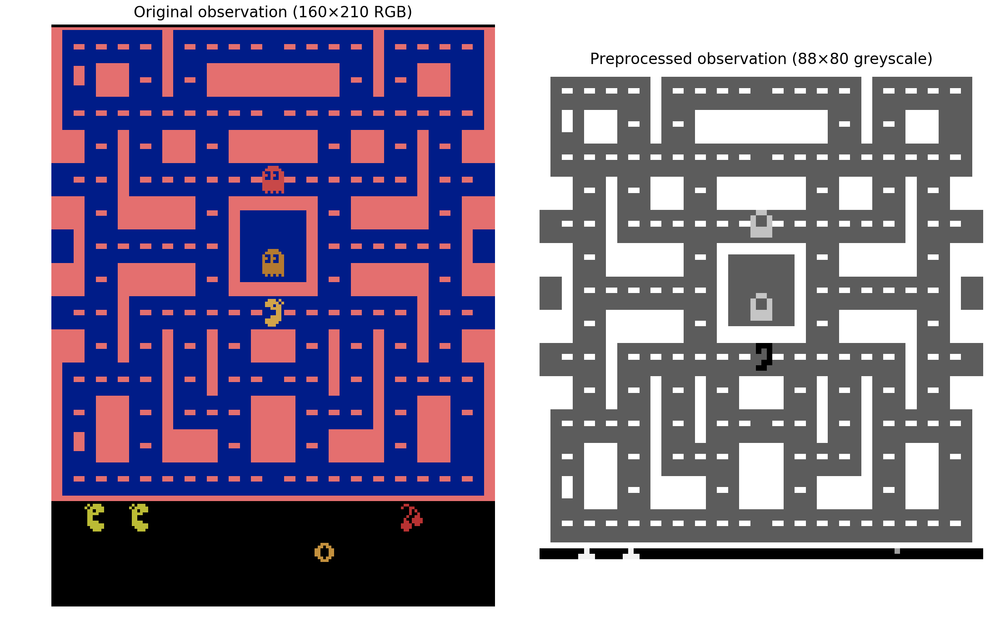

Saving figure preprocessing_plot


In [ ]:
plt.figure(figsize=(11, 7))
plt.subplot(121)
plt.title("Original observation (160×210 RGB)")
plt.imshow(obs)
plt.axis("off")
plt.subplot(122)
plt.title("Preprocessed observation (88×80 greyscale)")
plt.imshow(img.reshape(88, 80), interpolation="nearest", cmap="gray")
plt.axis("off")
save_fig("preprocessing_plot")
plt.show()

### Construir DQN


É mais conveniente e eficiente utilizar uma rede neural que usa apenas um 
estado *s* como entrada e gera uma estimativa de Q-Value por ação. O DQN será composto de 
três camadas convolucionais, seguidas por duas camadas totalmente conectadas, incluindo 
a camada de saída.

**Nota**: em vez de usar `tf.contrib.layers.convolution2d()` ou `tf.contrib.layers.conv2d()` (como na primeira versão do livro), agora usamos o `tf.layers.conv2d( )», que não existia quando este capítulo foi escrito. Isso é preferível porque qualquer coisa no contrib pode ser alterada ou excluída sem aviso prévio, enquanto `tf.layers` faz parte da API oficial. Como você verá, o código é basicamente o mesmo, exceto que os nomes dos parâmetros mudaram um pouco:


* o parâmetro `num_outputs` foi renomeado para `filters`,
* o parâmetro `stride` foi renomeado para `stride`,
* o sufixo `_fn` foi removido dos nomes dos parâmetros que o possuíam (por exemplo, `activation_fn` foi renomeado para `activation`),
* o parâmetro `weights_initializer` foi renomeado para `kernel_initializer`,
* a variável weights foi renomeada para `"kernel"` (em vez de `"weights"`), e a variável biases foi renomeada de `"biases"` para `"bias"`,
* e o padrão `activation` agora é `None` em vez de `tf.nn.relu`.

O algoritmo de treinamento DQN requer dois DQNs com a mesma arquitetura (mas com parâmetros diferentes): 
o DQN online aprenderá a conduzir a Ms. Pac-Man e o DQN de destino será utilizado 
para construir Q-Values de destino para treinar o DQN online. Substituindo seus parâmetros em intervalos regulares, copiaremos o DQN online para o DQN de destino. 
Como precisamos de dois DQNs com a mesma arquitetura, criaremos uma função 
`q_network()` para construí-los:

In [ ]:
reset_graph()

input_height = 88
input_width = 80
input_channels = 1
conv_n_maps = [32, 64, 64]
conv_kernel_sizes = [(8,8), (4,4), (3,3)]
conv_strides = [4, 2, 1]
conv_paddings = ["SAME"] * 3 
conv_activation = [tf.nn.relu] * 3
n_hidden_in = 64 * 11 * 10  # conv3 has 64 maps of 11x10 each
n_hidden = 512
hidden_activation = tf.nn.relu
n_outputs = env.action_space.n  # 9 discrete actions are available
initializer = tf.variance_scaling_initializer()

def q_network(X_state, name):
    prev_layer = X_state / 128.0 # scale pixel intensities to the [-1.0, 1.0] range.
    with tf.variable_scope(name) as scope:
        for n_maps, kernel_size, strides, padding, activation in zip(
                conv_n_maps, conv_kernel_sizes, conv_strides,
                conv_paddings, conv_activation):
            prev_layer = tf.layers.conv2d(
                prev_layer, filters=n_maps, kernel_size=kernel_size,
                strides=strides, padding=padding, activation=activation,
                kernel_initializer=initializer)
        last_conv_layer_flat = tf.reshape(prev_layer, shape=[-1, n_hidden_in])
        hidden = tf.layers.dense(last_conv_layer_flat, n_hidden,
                                 activation=hidden_activation,
                                 kernel_initializer=initializer)
        outputs = tf.layers.dense(hidden, n_outputs,
                                  kernel_initializer=initializer)
    trainable_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,
                                       scope=scope.name)
    trainable_vars_by_name = {var.name[len(scope.name):]: var
                              for var in trainable_vars}
    return outputs, trainable_vars_by_name

A primeira parte deste código define os hiperparâmetros da arquitetura DQN. Em seguida, considerando o estado do ambiente *X_state* como entrada e o nome do escopo 
da variável, definimos a função `q_network()` para criar os DQNs.

Agora, criaremos o placeholder de entrada, os dois DQNs e a operação para copiar o 
DQN online para o DQN de destino.

In [ ]:
X_state = tf.placeholder(tf.float32, shape=[None, input_height, input_width,
                                            input_channels])
online_q_values, online_vars = q_network(X_state, name="q_networks/online")
target_q_values, target_vars = q_network(X_state, name="q_networks/target")

copy_ops = [target_var.assign(online_vars[var_name])
            for var_name, target_var in target_vars.items()]
copy_online_to_target = tf.group(*copy_ops)

Temos uma operação chamada 
`copy_online_to_target` para copiar os valores de todas as variáveis treináveis da DQN 
online para as variáveis da DQN de destino correspondentes. Utilizaremos a função 
`tf.group()` do TensorFlow para agrupar todas as operações de atribuição em uma única 
operação conveniente.

In [ ]:
online_vars

{'/conv2d/bias:0': <tf.Variable 'q_networks/online/conv2d/bias:0' shape=(32,) dtype=float32_ref>,
 '/conv2d/kernel:0': <tf.Variable 'q_networks/online/conv2d/kernel:0' shape=(8, 8, 1, 32) dtype=float32_ref>,
 '/conv2d_1/bias:0': <tf.Variable 'q_networks/online/conv2d_1/bias:0' shape=(64,) dtype=float32_ref>,
 '/conv2d_1/kernel:0': <tf.Variable 'q_networks/online/conv2d_1/kernel:0' shape=(4, 4, 32, 64) dtype=float32_ref>,
 '/conv2d_2/bias:0': <tf.Variable 'q_networks/online/conv2d_2/bias:0' shape=(64,) dtype=float32_ref>,
 '/conv2d_2/kernel:0': <tf.Variable 'q_networks/online/conv2d_2/kernel:0' shape=(3, 3, 64, 64) dtype=float32_ref>,
 '/dense/bias:0': <tf.Variable 'q_networks/online/dense/bias:0' shape=(512,) dtype=float32_ref>,
 '/dense/kernel:0': <tf.Variable 'q_networks/online/dense/kernel:0' shape=(7040, 512) dtype=float32_ref>,
 '/dense_1/bias:0': <tf.Variable 'q_networks/online/dense_1/bias:0' shape=(9,) dtype=float32_ref>,
 '/dense_1/kernel:0': <tf.Variable 'q_networks/online/de

In [ ]:
learning_rate = 0.001
momentum = 0.95

with tf.variable_scope("train"):
    X_action = tf.placeholder(tf.int32, shape=[None])
    y = tf.placeholder(tf.float32, shape=[None, 1])
    q_value = tf.reduce_sum(online_q_values * tf.one_hot(X_action, n_outputs),
                            axis=1, keepdims=True)
    error = tf.abs(y - q_value)
    clipped_error = tf.clip_by_value(error, 0.0, 1.0)
    linear_error = 2 * (error - clipped_error)
    loss = tf.reduce_mean(tf.square(clipped_error) + linear_error)

    global_step = tf.Variable(0, trainable=False, name='global_step')
    optimizer = tf.train.MomentumOptimizer(learning_rate, momentum, use_nesterov=True)
    training_op = optimizer.minimize(loss, global_step=global_step)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

**Nota**: na primeira versão do livro, a função de perda era simplesmente o quadrado do erro entre os Q-Values ​​alvo (`y`) e os Q-Values ​​estimados (`q_value`). No entanto, como as experiências são muito barulhentas, é melhor usar uma perda quadrática apenas para erros pequenos (abaixo de 1,0) e uma perda linear (o dobro do erro absoluto) para erros maiores, que é o que o código acima calcula. Dessa forma, erros grandes não forçam tanto os parâmetros do modelo. Observe que também ajustamos alguns hiperparâmetros (usando uma taxa de aprendizado menor e usando Nesterov Accelerated Gradients em vez da otimização Adam, já que os algoritmos de gradiente adaptativos às vezes podem ser ruins, de acordo com este [paper](https://arxiv.org/abs/ 1705.08292)). Também ajustamos alguns outros hiperparâmetros abaixo (uma memória de replay maior, decaimento mais longo para a política $\epsilon$-greedy, maior taxa de desconto, cópias menos frequentes do DQN online para o DQN de destino etc.).

Usamos esta classe `ReplayMemory` em vez de um `deque` porque é muito mais rápido para acesso aleatório (graças a @NileshPS que contribuiu). Além disso, adotamos como padrão a amostragem com substituição, que é muito mais rápida do que a amostragem sem substituição para grandes memórias de repetição.

In [ ]:
class ReplayMemory:
    def __init__(self, maxlen):
        self.maxlen = maxlen
        self.buf = np.empty(shape=maxlen, dtype=np.object)
        self.index = 0
        self.length = 0
        
    def append(self, data):
        self.buf[self.index] = data
        self.length = min(self.length + 1, self.maxlen)
        self.index = (self.index + 1) % self.maxlen
    
    def sample(self, batch_size, with_replacement=True):
        if with_replacement:
            indices = np.random.randint(self.length, size=batch_size) # faster
        else:
            indices = np.random.permutation(self.length)[:batch_size]
        return self.buf[indices]

In [ ]:
replay_memory_size = 500000
replay_memory = ReplayMemory(replay_memory_size)

In [ ]:
def sample_memories(batch_size):
    cols = [[], [], [], [], []] # state, action, reward, next_state, continue
    for memory in replay_memory.sample(batch_size):
        for col, value in zip(cols, memory):
            col.append(value)
    cols = [np.array(col) for col in cols]
    return cols[0], cols[1], cols[2].reshape(-1, 1), cols[3], cols[4].reshape(-1, 1)

In [ ]:
eps_min = 0.1
eps_max = 1.0
eps_decay_steps = 2000000

def epsilon_greedy(q_values, step):
    epsilon = max(eps_min, eps_max - (eps_max-eps_min) * step/eps_decay_steps)
    if np.random.rand() < epsilon:
        return np.random.randint(n_outputs) # random action
    else:
        return np.argmax(q_values) # optimal action

In [ ]:
n_steps = 4000000  # total number of training steps
training_start = 10000  # start training after 10,000 game iterations
training_interval = 4  # run a training step every 4 game iterations
save_steps = 1000  # save the model every 1,000 training steps
copy_steps = 10000  # copy online DQN to target DQN every 10,000 training steps
discount_rate = 0.99
skip_start = 90  # Skip the start of every game (it's just waiting time).
batch_size = 50
iteration = 0  # game iterations
checkpoint_path = "./my_dqn.ckpt"
done = True # env needs to be reset

Algumas variáveis ​​para acompanhar o progresso:


In [ ]:
loss_val = np.infty
game_length = 0
total_max_q = 0
mean_max_q = 0.0

E agora o loop de treinamento principal!


In [ ]:
with tf.Session() as sess:
    if os.path.isfile(checkpoint_path + ".index"):
        saver.restore(sess, checkpoint_path)
    else:
        init.run()
        copy_online_to_target.run()
    while True:
        step = global_step.eval()
        if step >= n_steps:
            break
        iteration += 1
        print("\rIteration {}\tTraining step {}/{} ({:.1f})%\tLoss {:5f}\tMean Max-Q {:5f}   ".format(
            iteration, step, n_steps, step * 100 / n_steps, loss_val, mean_max_q), end="")
        if done: # game over, start again
            obs = env.reset()
            for skip in range(skip_start): # skip the start of each game
                obs, reward, done, info = env.step(0)
            state = preprocess_observation(obs)

        # Online DQN evaluates what to do
        q_values = online_q_values.eval(feed_dict={X_state: [state]})
        action = epsilon_greedy(q_values, step)

        # Online DQN plays
        obs, reward, done, info = env.step(action)
        next_state = preprocess_observation(obs)

        # Let's memorize what happened
        replay_memory.append((state, action, reward, next_state, 1.0 - done))
        state = next_state

        # Compute statistics for tracking progress (not shown in the book)
        total_max_q += q_values.max()
        game_length += 1
        if done:
            mean_max_q = total_max_q / game_length
            total_max_q = 0.0
            game_length = 0

        if iteration < training_start or iteration % training_interval != 0:
            continue # only train after warmup period and at regular intervals
        
        # Sample memories and use the target DQN to produce the target Q-Value
        X_state_val, X_action_val, rewards, X_next_state_val, continues = (
            sample_memories(batch_size))
        next_q_values = target_q_values.eval(
            feed_dict={X_state: X_next_state_val})
        max_next_q_values = np.max(next_q_values, axis=1, keepdims=True)
        y_val = rewards + continues * discount_rate * max_next_q_values

        # Train the online DQN
        _, loss_val = sess.run([training_op, loss], feed_dict={
            X_state: X_state_val, X_action: X_action_val, y: y_val})

        # Regularly copy the online DQN to the target DQN
        if step % copy_steps == 0:
            copy_online_to_target.run()

        # And save regularly
        if step % save_steps == 0:
            saver.save(sess, checkpoint_path)

INFO:tensorflow:Restoring parameters from ./my_dqn.ckpt


[2017-09-25 13:55:15,610] Restoring parameters from ./my_dqn.ckpt


Iteration 1270171	Training step 315001/4000000 (7.9)%	Loss 2.651937	Mean Max-Q 30.964941   

Você pode interromper a célula acima a qualquer momento para testar seu agente usando a célula abaixo. Você pode então executar a célula acima mais uma vez, ela carregará os últimos parâmetros salvos e retomará o treinamento.


In [ ]:
frames = []
n_max_steps = 10000

with tf.Session() as sess:
    saver.restore(sess, checkpoint_path)

    obs = env.reset()
    for step in range(n_max_steps):
        state = preprocess_observation(obs)

        # Online DQN evaluates what to do
        q_values = online_q_values.eval(feed_dict={X_state: [state]})
        action = np.argmax(q_values)

        # Online DQN plays
        obs, reward, done, info = env.step(action)

        img = env.render(mode="rgb_array")
        frames.append(img)

        if done:
            break

INFO:tensorflow:Restoring parameters from ./my_dqn.ckpt


[2017-09-25 13:53:39,307] Restoring parameters from ./my_dqn.ckpt


In [ ]:
plot_animation(frames)

## Extra material

### Preprocessing for Breakout

Here is a preprocessing function you can use to train a DQN for the Breakout-v0 Atari game:

In [ ]:
def preprocess_observation(obs):
    img = obs[34:194:2, ::2] # crop and downsize
    return np.mean(img, axis=2).reshape(80, 80) / 255.0

In [ ]:
env = gym.make("Breakout-v0")
obs = env.reset()
for step in range(10):
    obs, _, _, _ = env.step(1)

img = preprocess_observation(obs)

[2017-09-25 13:54:27,989] Making new env: Breakout-v0


<IPython.core.display.Javascript object>


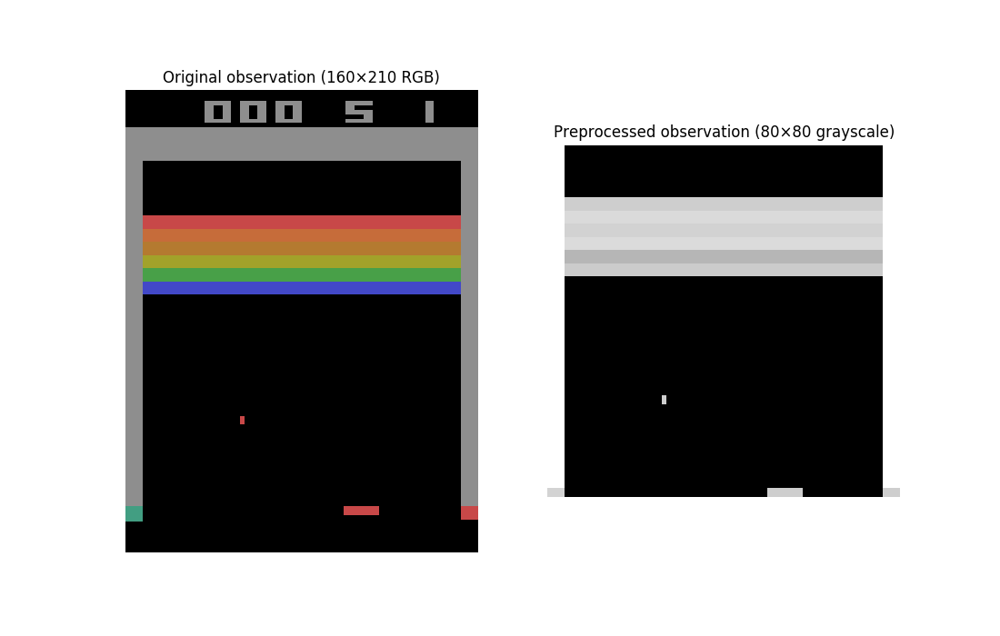

In [ ]:
plt.figure(figsize=(11, 7))
plt.subplot(121)
plt.title("Original observation (160×210 RGB)")
plt.imshow(obs)
plt.axis("off")
plt.subplot(122)
plt.title("Preprocessed observation (80×80 grayscale)")
plt.imshow(img, interpolation="nearest", cmap="gray")
plt.axis("off")
plt.show()

As you can see, a single image does not give you the direction and speed of the ball, which are crucial informations for playing this game. For this reason, it is best to actually combine several consecutive observations to create the environment's state representation. One way to do that is to create a multi-channel image, with one channel per recent observation. Another is to merge all recent observations into a single-channel image, using `np.max()`. In this case, we need to dim the older images so that the DQN can distinguish the past from the present.

In [ ]:
from collections import deque

def combine_observations_multichannel(preprocessed_observations):
    return np.array(preprocessed_observations).transpose([1, 2, 0])

def combine_observations_singlechannel(preprocessed_observations, dim_factor=0.5):
    dimmed_observations = [obs * dim_factor**index
                           for index, obs in enumerate(reversed(preprocessed_observations))]
    return np.max(np.array(dimmed_observations), axis=0)

n_observations_per_state = 3
preprocessed_observations = deque([], maxlen=n_observations_per_state)

obs = env.reset()
for step in range(10):
    obs, _, _, _ = env.step(1)
    preprocessed_observations.append(preprocess_observation(obs))

<IPython.core.display.Javascript object>


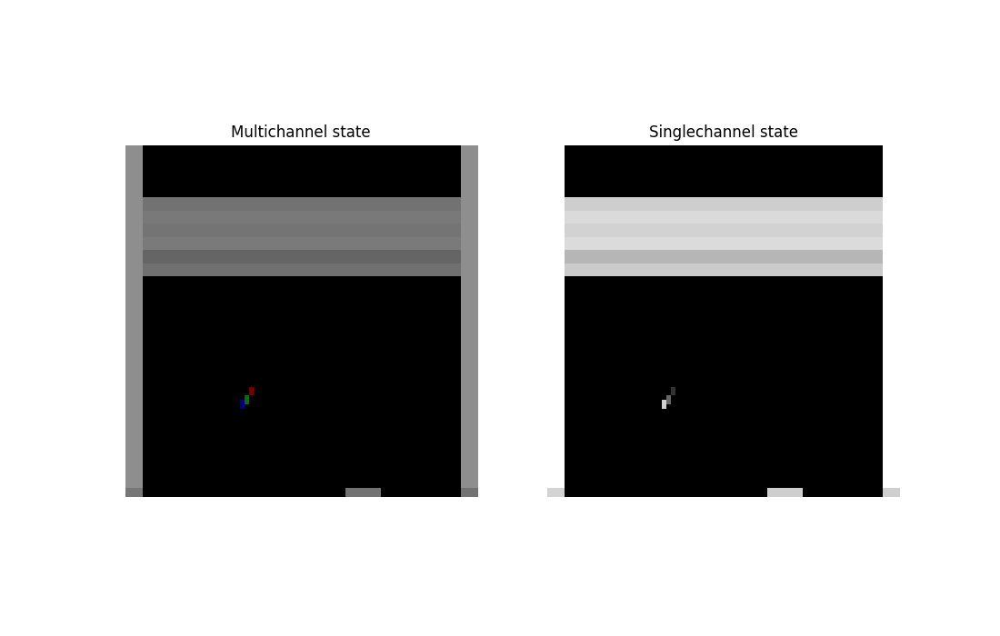

In [ ]:
img1 = combine_observations_multichannel(preprocessed_observations)
img2 = combine_observations_singlechannel(preprocessed_observations)

plt.figure(figsize=(11, 7))
plt.subplot(121)
plt.title("Multichannel state")
plt.imshow(img1, interpolation="nearest")
plt.axis("off")
plt.subplot(122)
plt.title("Singlechannel state")
plt.imshow(img2, interpolation="nearest", cmap="gray")
plt.axis("off")
plt.show()